In [31]:
import numpy as np
import matplotlib.pyplot as plt
import h5py
import tensorflow as tf
import tensorflow.keras as keras
from tensorflow.keras import layers
import tensorflow.keras.backend as K
import sklearn.metrics as sk
import sys
import os
# Add your local packages directory to Python path
sys.path.append('/eos/home-i02/h/hjia/.local/lib/python3.9/site-packages')
# Print paths to verify
print(sys.path)
import math
phi_res = 128/(2*math.pi)
print(phi_res)
# from dcor import distance_correlation as dcor

['/eos/home-h/hjia/AnomalyDetection/workdir/analysis_notebooks', '/eos/home-h/hjia/miniforge3/envs/ML_env/lib/python311.zip', '/eos/home-h/hjia/miniforge3/envs/ML_env/lib/python3.11', '/eos/home-h/hjia/miniforge3/envs/ML_env/lib/python3.11/lib-dynload', '', '/eos/home-h/hjia/miniforge3/envs/ML_env/lib/python3.11/site-packages', '/eos/home-h/hjia/miniforge3/envs/ML_env/lib/python3.11/site-packages/setuptools/_vendor', '/eos/home-i02/h/hjia/.local/lib/python3.9/site-packages', '/eos/home-i02/h/hjia/.local/lib/python3.9/site-packages']
20.371832715762604


In [32]:
from tensorflow.keras.layers import BatchNormalization
from qkeras import QActivation, QDense, QDenseBatchnorm
from tensorflow.keras.models import Model
from tensorflow.keras.layers import PReLU, Input, Concatenate, Dense, ReLU, Dropout, BatchNormalization, Activation
from qkeras import quantized_relu, quantized_bits

In [33]:
from matplotlib import cm

In [34]:
def has_duplicates(arr):
    _, counts = np.unique(arr, return_counts=True)
    return np.any(counts > 1)

In [35]:
def load_and_preprocess_data(file_path):
    with h5py.File(file_path, 'r') as hf:
        # check if the file is ZeroBias or not
        if "EB_weights" in hf:
            weights = hf["EB_weights"][:]
            print("\nEB_weights found! Should be Enhanced Bias data file.")
            print("First few values:", weights[:5])  # Show first 5 values
            ZBflag = 0
        else:
            print("\nEB_weights not found in the file. Should be Zero Bias data file.")
            ZBflag = 1

        # Define object counts
        nmuon, nSRjet, netau = 4, 6, 4

        def fix_phi_range(phi_data):
            # Map values to [0,2pi] range
            phi_fixed = phi_data % (2*math.pi)
            # Scale to [0,128) range and round to nearest integer
            phi_scaled = np.round(phi_fixed * 128/(2*math.pi))
            
            # Take modulo 128 to handle edge cases
            phi_binned = phi_scaled % 128
            return phi_binned
        
        # Load and reshape datasets with scaling
        def load_and_scale(dataset, n_objects, scale_factor=10, eta_factor=40, phi_factor=phi_res):
            data = hf[dataset][:, 0:n_objects, :]
            data[:, :, 0] *= scale_factor  # Scale the pT value
            data[:, :, 1] *= eta_factor  # Scale the angle value
            data[:, :, 2] = fix_phi_range(data[:, :, 2])
            return data.reshape(-1, 3 * n_objects)

        L1_jFexSR_jets = load_and_scale('L1_jFexSR_jets', nSRjet)
        L1_muons = load_and_scale('L1_muons', nmuon, scale_factor=10000)
        L1_eFex_taus = load_and_scale('L1_eFex_taus', netau)

        # Load and process MET
        L1_MET = hf['L1_MET'][:]
        L1_MET[:, 0] *= 10
        L1_MET[:, 2] = fix_phi_range(L1_MET[:, 2])
        
        L1_MET_fixed = np.zeros((L1_MET.shape[0], 2))
        L1_MET_fixed[:, 0] = L1_MET[:, 0]
        L1_MET_fixed[:, 1] = L1_MET[:, 2]
        L1_MET = L1_MET_fixed

        L1_mu = hf['mu'][:]
        valid_events_mask = L1_mu != 0
        L1_LBmu = hf['AvgMu'][:]
        
        if ZBflag == 0:
            EB_weights = hf["EB_weights"][:]
        elif ZBflag == 1:
            EB_weights = np.ones(len(hf['mu'][:]))
        weighted_mu_zero_fraction = np.sum(EB_weights[L1_mu == 0]) / np.sum(EB_weights)
        print(f"Weighted fraction of events with mu=0: {weighted_mu_zero_fraction:.4f}")

        pass_L1_unprescaled = hf["pass_L1_unprescaled"][:]
                
        # Combine arrays into Topo 2A
        Topo_2A = np.concatenate([L1_jFexSR_jets, L1_eFex_taus, L1_muons, L1_MET], axis=1)
        print("Shape of Topo_2A:", Topo_2A.shape)

        Topo_2A = Topo_2A[valid_events_mask]
        pass_L1_unprescaled = pass_L1_unprescaled[valid_events_mask]
        L1_mu = L1_mu[valid_events_mask]
        EB_weights = EB_weights[valid_events_mask]
        L1_LBmu = L1_LBmu[valid_events_mask]
        return Topo_2A, pass_L1_unprescaled, L1_mu, EB_weights, L1_LBmu

In [36]:
def load_and_preprocess_normal_multiple_files(file_paths):
    # Initialize lists to store data from each file
    all_Topo_2A = []
    all_pass_L1 = []
    all_mu = []
    all_weights = []
    all_LBmu = []
    
    # Load data from each file
    for file_path in file_paths:
        Topo_2A, pass_L1_unprescaled, L1_mu, L1_weights, L1_LBmu = load_and_preprocess_data(file_path)
        if np.sum(pass_L1_unprescaled) == 0:
            print("no L1 pass events!!!")
        all_Topo_2A.append(Topo_2A)
        all_pass_L1.append(pass_L1_unprescaled)
        all_mu.append(L1_mu)
        all_weights.append(L1_weights)
        all_LBmu.append(L1_LBmu)
    
    # Concatenate all files' data
    final_Topo_2A = np.concatenate(all_Topo_2A, axis=0)
    final_pass_L1 = np.concatenate(all_pass_L1, axis=0)
    final_mu = np.concatenate(all_mu, axis=0)
    final_weights = np.concatenate(all_weights, axis=0)
    final_LBmu = np.concatenate(all_LBmu, aixs=0)
    # Get total number of samples
    n_samples = final_Topo_2A.shape[0]
    
    # Set random seed and create shuffle indices
    np.random.seed(42)
    shuffle_idx = np.random.permutation(n_samples)
    
    # Shuffle all arrays using the same indices
    final_Topo_2A = final_Topo_2A[shuffle_idx]
    final_pass_L1 = final_pass_L1[shuffle_idx]
    final_mu = final_mu[shuffle_idx]
    final_weights = final_weights[shuffle_idx]
    final_LBmu = final_LBmu[shuffle_idx]

    def fill_median(array):
        for i in range(array.shape[1]):
            array[np.isnan(array[:, i]), i] = 0#median_value
        return array

    final_Topo_2A = fill_median(final_Topo_2A)

    print(f"total of {n_samples} event processed")
    return final_Topo_2A, final_pass_L1, final_mu, final_weights, final_LBmu


In [37]:
file_paths = [
    '/eos/home-m/mmcohen/ntuples/EB_h5_10-06-2024/EB_473255_0_10-05-2024.h5',
    '/eos/home-m/mmcohen/ntuples/EB_h5_10-06-2024/EB_475321_0_10-05-2024.h5',
    '/eos/home-m/mmcohen/ntuples/EB_h5_10-06-2024/EB_482596_0_10-05-2024.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_474448_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_474462_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_474562_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_474657_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_474679_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_474926_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_474991_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_475008_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_475052_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_475066_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_475168_1-16-2025.h5',
    '/eos/home-m/mmcohen/ntuples/data24_ZeroBias/ZeroBias_475192_1-16-2025.h5',
]    

In [38]:
Topo_2A, pass_L1_unprescaled, event_mu, events_weights, event_LBmu = load_and_preprocess_normal_multiple_files(file_paths)


EB_weights found! Should be Enhanced Bias data file.
First few values: [5. 5. 5. 5. 5.]
Weighted fraction of events with mu=0: 0.7770
Shape of Topo_2A: (1146112, 44)

EB_weights found! Should be Enhanced Bias data file.
First few values: [5.00000e+00 5.00000e+00 5.00000e+00 6.29279e+02 4.69294e+04]
Weighted fraction of events with mu=0: 0.1958
Shape of Topo_2A: (1119657, 44)

EB_weights found! Should be Enhanced Bias data file.
First few values: [621378.       629.279 441506.    441506.       632.306]
Weighted fraction of events with mu=0: 0.1952
Shape of Topo_2A: (1048336, 44)

EB_weights found! Should be Enhanced Bias data file.
First few values: [1. 1. 1. 1. 1.]
Weighted fraction of events with mu=0: 0.0000
Shape of Topo_2A: (150853, 44)

EB_weights found! Should be Enhanced Bias data file.
First few values: [1. 1. 1. 1. 1.]
Weighted fraction of events with mu=0: 0.0000
Shape of Topo_2A: (259271, 44)

EB_weights found! Should be Enhanced Bias data file.
First few values: [1. 1. 1. 

: 

In [ ]:
print(Topo_2A.shape)

(6342309, 44)


In [ ]:
Topo_2A_test = Topo_2A[3000000:,:]
L1_pass_flag = pass_L1_unprescaled[3000000:]
Topo_2A_mu = event_mu[3000000:]
Topo_test_weights = events_weights[3000000:]
Topo_2A_LBmu = event_LBmu[3000000:]

In [ ]:
Topo_2A_test = Topo_2A_test[Topo_2A_LBmu >= 58]
L1_pass_flag = L1_pass_flag[Topo_2A_LBmu >= 58]
Topo_2A_mu = Topo_2A_mu[Topo_2A_LBmu >= 58]
Topo_test_weights = Topo_test_weights[Topo_2A_LBmu >= 58]
Topo_2A_LBmu = Topo_2A_LBmu[Topo_2A_LBmu >= 58]

In [ ]:
print(np.sum(L1_pass_flag))

566242


In [ ]:
def load_and_process_anomalous_data(file_name):
    with h5py.File(file_name, 'r') as hf:
        nmuon, nLRjet, nSRjet, negamma, netau, njtau = 4, 6, 6, 4, 4, 4
        print(hf.keys())
        def fix_phi_range(phi_data):
            # Map values to [0,2pi] range
            phi_fixed = phi_data % (2*math.pi)
            # Scale to [0,128) range and round to nearest integer
            phi_scaled = np.round(phi_fixed * 128/(2*math.pi))
            
            # Take modulo 128 to handle edge cases
            phi_binned = phi_scaled % 128
            return phi_binned

        def load_and_scale(dataset, n_objects, scale_factor=10, eta_factor=40):
            data = hf[dataset][:, 0:n_objects, :]
            data[:, :, 0] *= scale_factor  # Scale the pT value
            data[:, :, 1] *= eta_factor  # Scale the angle value
            data[:, :, 2] = fix_phi_range(data[:, :, 2])
            return data.reshape(-1, 3 * n_objects)

        L1_jFexSR_jets = load_and_scale('L1_jFexSR_jets', nSRjet)
        L1_jFexLR_jets = load_and_scale('L1_jFexLR_jets', nLRjet)
        L1_egammas = load_and_scale('L1_egammas', negamma)
        L1_muons = load_and_scale('L1_muons', nmuon, scale_factor=10000)  # Specific scaling for muons
        L1_eFex_taus = load_and_scale('L1_eFex_taus', netau)
        L1_jFex_taus = load_and_scale('L1_jFex_taus', njtau)

        L1_MET = hf['L1_MET'][:]
        L1_MET[:, 0] *= 10
        L1_MET[:, 2] = fix_phi_range(L1_MET[:, 2])

        pass_L1_unprescaled = hf["pass_L1_unprescaled"][:]

        # Reformat L1_MET
        L1_MET_fixed = np.zeros((L1_MET.shape[0], 2))
        L1_MET_fixed[:, 0] = L1_MET[:, 0]
        L1_MET_fixed[:, 1] = L1_MET[:, 2]
        L1_MET = L1_MET_fixed

        # Combine arrays into Topo groups
        Topo_2A = np.concatenate([L1_jFexSR_jets, L1_eFex_taus, L1_muons, L1_MET], axis=1)

        # Handle NaN values
        def fill_median(array):
            for i in range(array.shape[1]):
                median_value = np.nanmedian(array[:, i])
                array[np.isnan(array[:, i]), i] = 0#median_value
            return array

        Topo_2A = fill_median(Topo_2A)

        return Topo_2A, pass_L1_unprescaled

In [ ]:
Topo_2A_HHbbtt, pass_L1_HHbbtt = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC_07-17-2024/HHbbttHadHad_07-10-2024.h5')
Topo_2A_A14, pass_L1_A14 = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC_07-17-2024/A14N23LO_07-17-2024.h5')
Topo_2A_HAHMggf, pass_L1_HAHMggf = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC_07-17-2024/HAHMggfZdZd2l2nu_07-17-2024.h5')
Topo_2A_qqa, pass_L1_qqa = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC_07-17-2024/qqa_07-17-2024.h5')
Topo_2A_Zprime, pass_L1_Zprime = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC_07-17-2024/Zprime2EJs_07-17-2024.h5')
Topo_2A_ZZ4lep, pass_L1_ZZ4lep = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC_07-17-2024/ZZ4lep_07-17-2024.h5')
Topo_2A_jz1, pass_L1_jz1 = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC_07-17-2024/jjJZ1_07-17-2024.h5')
Topo_2A_jz2, pass_L1_jz2 = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC_07-17-2024/jjJZ2_07-17-2024.h5')
Topo_2A_jz4, pass_L1_jz4 = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC_07-17-2024/jjJZ4_07-17-2024.h5')

<KeysViewHDF5 ['HLT_MET', 'HLT_electrons', 'HLT_jets', 'HLT_muons', 'HLT_photons', 'L1_MET', 'L1_eFex_taus', 'L1_egammas', 'L1_jFexLR_jets', 'L1_jFexSR_jets', 'L1_jFex_taus', 'L1_muons', 'LRT_electrons', 'LRT_muons', 'pass_HLT_unprescaled', 'pass_L1_unprescaled']>
<KeysViewHDF5 ['HLT_MET', 'HLT_electrons', 'HLT_jets', 'HLT_muons', 'HLT_photons', 'L1_MET', 'L1_eFex_taus', 'L1_egammas', 'L1_jFexLR_jets', 'L1_jFexSR_jets', 'L1_jFex_taus', 'L1_muons', 'LRT_electrons', 'LRT_muons', 'pass_HLT_unprescaled', 'pass_L1_unprescaled']>
<KeysViewHDF5 ['HLT_MET', 'HLT_electrons', 'HLT_jets', 'HLT_muons', 'HLT_photons', 'L1_MET', 'L1_eFex_taus', 'L1_egammas', 'L1_jFexLR_jets', 'L1_jFexSR_jets', 'L1_jFex_taus', 'L1_muons', 'LRT_electrons', 'LRT_muons', 'pass_HLT_unprescaled', 'pass_L1_unprescaled']>
<KeysViewHDF5 ['HLT_MET', 'HLT_electrons', 'HLT_jets', 'HLT_muons', 'HLT_photons', 'L1_MET', 'L1_eFex_taus', 'L1_egammas', 'L1_jFexLR_jets', 'L1_jFexSR_jets', 'L1_jFex_taus', 'L1_muons', 'LRT_electrons', '

In [ ]:
Topo_2A_ChiPlusChiMinus100_99_0p3ns, pass_L1_ChiPlusChiMinus100_99_0p3ns = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC23e_12-10-2024/MC_ChiPlusChiMinus100_99_0p3ns_12-10-2024.h5')
Topo_2A_ChiPlusChiMinus500_40_10ns, pass_L1_ChiPlusChiMinus500_40_10ns = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC23e_12-10-2024/MC_ChiPlusChiMinus500_40_10ns_12-10-2024.h5')
Topo_2A_HAHMggf_23e, pass_L1_HAHMggf_23e = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC23e_12-10-2024/MC_HAHMggf_12-10-2024.h5')
Topo_2A_HNLeemu_23e, pass_L1_HNLeemu_23e = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC23e_12-10-2024/MC_HNLeemu_12-10-2024.h5')
Topo_2A_jz2_23e, pass_L1_jz2_23e = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC23e_12-10-2024/MC_jjJZ2_12-10-2024.h5')
Topo_2A_jz4_23e, pass_L1_jz4_23e = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC23e_12-10-2024/MC_jjJZ4_12-10-2024.h5')
Topo_2A_HH4b_23e, pass_L1_HH4b_23e = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC23e_12-10-2024/MC_RS_G_hh_bbbb_AutoWidth_c10_M300_12-10-2024.h5')
Topo_2A_ttbar_1lep_23e, pass_L1_ttbar_1lep_23e = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC23e_12-10-2024/MC_ttbar_1lep_12-10-2024.h5')
Topo_2A_ttbar_2lep_23e, pass_L1_ttbar_2lep_23e = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC23e_12-10-2024/MC_ttbar_2lep_12-10-2024.h5')
Topo_2A_ZZ4lep_23e, pass_L1_ZZ4lep_23e = load_and_process_anomalous_data('/eos/home-m/mmcohen/ntuples/MC23e_12-10-2024/MC_ZZ4lep_12-10-2024.h5')

<KeysViewHDF5 ['EB_weights', 'HLT_MET', 'HLT_electrons', 'HLT_jets', 'HLT_muons', 'HLT_photons', 'L1_MET', 'L1_eFex_taus', 'L1_egammas', 'L1_jFexLR_jets', 'L1_jFexSR_jets', 'L1_jFex_taus', 'L1_muons', 'LRT_electrons', 'LRT_muons', 'event_number', 'lumiblock_bads', 'mu', 'pass_HLT_unprescaled', 'pass_L1_unprescaled', 'run_number']>
<KeysViewHDF5 ['EB_weights', 'HLT_MET', 'HLT_electrons', 'HLT_jets', 'HLT_muons', 'HLT_photons', 'L1_MET', 'L1_eFex_taus', 'L1_egammas', 'L1_jFexLR_jets', 'L1_jFexSR_jets', 'L1_jFex_taus', 'L1_muons', 'LRT_electrons', 'LRT_muons', 'event_number', 'lumiblock_bads', 'mu', 'pass_HLT_unprescaled', 'pass_L1_unprescaled', 'run_number']>
<KeysViewHDF5 ['EB_weights', 'HLT_MET', 'HLT_electrons', 'HLT_jets', 'HLT_muons', 'HLT_photons', 'L1_MET', 'L1_eFex_taus', 'L1_egammas', 'L1_jFexLR_jets', 'L1_jFexSR_jets', 'L1_jFex_taus', 'L1_muons', 'LRT_electrons', 'LRT_muons', 'event_number', 'lumiblock_bads', 'mu', 'pass_HLT_unprescaled', 'pass_L1_unprescaled', 'run_number']>


<KeysViewHDF5 ['EB_weights', 'HLT_MET', 'HLT_electrons', 'HLT_jets', 'HLT_muons', 'HLT_photons', 'L1_MET', 'L1_eFex_taus', 'L1_egammas', 'L1_jFexLR_jets', 'L1_jFexSR_jets', 'L1_jFex_taus', 'L1_muons', 'LRT_electrons', 'LRT_muons', 'event_number', 'lumiblock_bads', 'mu', 'pass_HLT_unprescaled', 'pass_L1_unprescaled', 'run_number']>
<KeysViewHDF5 ['EB_weights', 'HLT_MET', 'HLT_electrons', 'HLT_jets', 'HLT_muons', 'HLT_photons', 'L1_MET', 'L1_eFex_taus', 'L1_egammas', 'L1_jFexLR_jets', 'L1_jFexSR_jets', 'L1_jFex_taus', 'L1_muons', 'LRT_electrons', 'LRT_muons', 'event_number', 'lumiblock_bads', 'mu', 'pass_HLT_unprescaled', 'pass_L1_unprescaled', 'run_number']>
<KeysViewHDF5 ['EB_weights', 'HLT_MET', 'HLT_electrons', 'HLT_jets', 'HLT_muons', 'HLT_photons', 'L1_MET', 'L1_eFex_taus', 'L1_egammas', 'L1_jFexLR_jets', 'L1_jFexSR_jets', 'L1_jFex_taus', 'L1_muons', 'LRT_electrons', 'LRT_muons', 'event_number', 'lumiblock_bads', 'mu', 'pass_HLT_unprescaled', 'pass_L1_unprescaled', 'run_number']>
<

In [ ]:
#mu_veto_mask = Topo_2A_mu != 0
L1_veto_mask = L1_pass_flag == 0
combined_mask = L1_veto_mask# & mu_veto_mask
#print(mu_veto_mask.shape)
print(L1_veto_mask.shape)
print(combined_mask.shape)
print(Topo_test_weights.shape)
Topo_2A_L1failed = Topo_2A_test[combined_mask]
Topo_2A_L1failed_mu = Topo_2A_mu[combined_mask]
Topo_EB_L1failed_weights = Topo_test_weights[combined_mask]

weights_selected = Topo_test_weights[combined_mask]
print(np.sum(weights_selected) / np.sum(Topo_test_weights))

(3342309,)
(3342309,)
(3342309,)


0.9957421031594959


In [ ]:
Filter_eff = np.sum(weights_selected) / np.sum(Topo_test_weights)
print(Filter_eff)

0.9957421031594959


In [ ]:
print(Topo_2A_L1failed.shape)

(2776067, 44)


In [ ]:
Topo_2A_HHbbtt_pure = Topo_2A_HHbbtt[pass_L1_HHbbtt == 0]
Topo_2A_A14_pure = Topo_2A_A14[pass_L1_A14 == 0]
Topo_2A_HAHMggf_pure = Topo_2A_HAHMggf[pass_L1_HAHMggf == 0]
Topo_2A_qqa_pure = Topo_2A_qqa[pass_L1_qqa == 0]
Topo_2A_Zprime_pure = Topo_2A_Zprime[pass_L1_Zprime == 0]
Topo_2A_ZZ4lep_pure = Topo_2A_ZZ4lep[pass_L1_ZZ4lep == 0]
Topo_2A_jz1_pure = Topo_2A_jz1[pass_L1_jz1 == 0]
Topo_2A_jz2_pure = Topo_2A_jz2[pass_L1_jz2 == 0]
Topo_2A_jz4_pure = Topo_2A_jz4[pass_L1_jz4 == 0]

# 23e
Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure = Topo_2A_ChiPlusChiMinus100_99_0p3ns[pass_L1_ChiPlusChiMinus100_99_0p3ns == 0]
Topo_2A_ChiPlusChiMinus500_40_10ns_pure = Topo_2A_ChiPlusChiMinus500_40_10ns[pass_L1_ChiPlusChiMinus500_40_10ns == 0]
Topo_2A_HAHMggf_23e_pure = Topo_2A_HAHMggf_23e[pass_L1_HAHMggf_23e == 0]
Topo_2A_HNLeemu_23e_pure = Topo_2A_HNLeemu_23e[pass_L1_HNLeemu_23e == 0]
Topo_2A_jz2_23e_pure = Topo_2A_jz2_23e[pass_L1_jz2_23e == 0]
Topo_2A_jz4_23e_pure = Topo_2A_jz4_23e[pass_L1_jz4_23e == 0]
Topo_2A_HH4b_23e_pure = Topo_2A_HH4b_23e[pass_L1_HH4b_23e == 0]
Topo_2A_ttbar_1lep_23e_pure = Topo_2A_ttbar_1lep_23e[pass_L1_ttbar_1lep_23e == 0]
Topo_2A_ttbar_2lep_23e_pure = Topo_2A_ttbar_2lep_23e[pass_L1_ttbar_2lep_23e == 0]
Topo_2A_ZZ4lep_23e_pure = Topo_2A_ZZ4lep_23e[pass_L1_ZZ4lep_23e == 0]

In [ ]:
def calculate_percentage(original, filtered):
    return (len(filtered) / len(original)) * 100 if len(original) > 0 else 0

datasets = [
    ("Topo_2A_HHbbtt", Topo_2A_HHbbtt, Topo_2A_HHbbtt_pure),
    ("Topo_2A_A14", Topo_2A_A14, Topo_2A_A14_pure),
    ("Topo_2A_HAHMggf", Topo_2A_HAHMggf, Topo_2A_HAHMggf_pure),
    ("Topo_2A_qqa", Topo_2A_qqa, Topo_2A_qqa_pure),
    ("Topo_2A_Zprime", Topo_2A_Zprime, Topo_2A_Zprime_pure),
    ("Topo_2A_ZZ4lep", Topo_2A_ZZ4lep, Topo_2A_ZZ4lep_pure),
    ("Topo_2A_jz1", Topo_2A_jz1, Topo_2A_jz1_pure),
    ("Topo_2A_jz2", Topo_2A_jz2, Topo_2A_jz2_pure),
    ("Topo_2A_jz4", Topo_2A_jz4, Topo_2A_jz4_pure),
    ("Topo_2A_ChiPlusChiMinus100_99_0p3ns", Topo_2A_ChiPlusChiMinus100_99_0p3ns, Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure),
    ("Topo_2A_ChiPlusChiMinus500_40_10ns", Topo_2A_ChiPlusChiMinus500_40_10ns, Topo_2A_ChiPlusChiMinus500_40_10ns_pure),
    ("Topo_2A_HAHMggf_23e", Topo_2A_HAHMggf_23e, Topo_2A_HAHMggf_23e_pure),
    ("Topo_2A_HNLeemu_23e", Topo_2A_HNLeemu_23e, Topo_2A_HNLeemu_23e_pure),
    ("Topo_2A_jz2_23e", Topo_2A_jz2_23e, Topo_2A_jz2_23e_pure),
    ("Topo_2A_jz4_23e", Topo_2A_jz4_23e, Topo_2A_jz4_23e_pure),
    ("Topo_2A_HH4b_23e", Topo_2A_HH4b_23e, Topo_2A_HH4b_23e_pure),
    ("Topo_2A_ttbar_1lep_23e", Topo_2A_ttbar_1lep_23e, Topo_2A_ttbar_1lep_23e_pure),
    ("Topo_2A_ttbar_2lep_23e", Topo_2A_ttbar_2lep_23e, Topo_2A_ttbar_2lep_23e_pure),
    ("Topo_2A_ZZ4lep_23e", Topo_2A_ZZ4lep_23e, Topo_2A_ZZ4lep_23e_pure),
]

# Dictionary to store percentages
filter_percentages = {}

for name, original, filtered in datasets:
    percentage = calculate_percentage(original, filtered)
    filter_percentages[name] = percentage
    print(f"{name}: {percentage:.2f}% passed the filter")

Topo_2A_HHbbtt: 5.41% passed the filter
Topo_2A_A14: 63.84% passed the filter
Topo_2A_HAHMggf: 29.16% passed the filter
Topo_2A_qqa: 39.67% passed the filter
Topo_2A_Zprime: 0.02% passed the filter
Topo_2A_ZZ4lep: 9.73% passed the filter
Topo_2A_jz1: 94.18% passed the filter
Topo_2A_jz2: 62.17% passed the filter
Topo_2A_jz4: 0.00% passed the filter
Topo_2A_ChiPlusChiMinus100_99_0p3ns: 19.62% passed the filter
Topo_2A_ChiPlusChiMinus500_40_10ns: 47.02% passed the filter
Topo_2A_HAHMggf_23e: 15.69% passed the filter
Topo_2A_HNLeemu_23e: 43.18% passed the filter
Topo_2A_jz2_23e: 50.41% passed the filter
Topo_2A_jz4_23e: 0.00% passed the filter
Topo_2A_HH4b_23e: 12.38% passed the filter
Topo_2A_ttbar_1lep_23e: 4.80% passed the filter
Topo_2A_ttbar_2lep_23e: 4.81% passed the filter
Topo_2A_ZZ4lep_23e: 5.48% passed the filter


In [ ]:
class Sampling(keras.layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

def Qmake_encoder_set_weights(input_dim,h_dim_1,h_dim_2,latent_dim):
    l2_factor = 1e-3
    inputs = keras.Input(shape=(input_dim), name = "inputs")
    x = QDenseBatchnorm(h_dim_1,
             kernel_quantizer=quantized_bits(10,5,0,alpha=1),
             bias_quantizer=quantized_bits(10,5,0,alpha=1),
             kernel_initializer=keras.initializers.HeNormal(seed=None),
             bias_initializer=keras.initializers.Zeros(),
            name = "dense1")(inputs)
    x = QActivation(quantized_relu(15, negative_slope=1/1024), name = 'relu1')(x)
    x = QDenseBatchnorm(h_dim_2,
             kernel_quantizer=quantized_bits(10,5,0,alpha=1),
             bias_quantizer=quantized_bits(10,5,0,alpha=1),
             kernel_initializer=keras.initializers.HeNormal(seed=None),
             bias_initializer=keras.initializers.Zeros(),
            name = "dense2")(x)
    x = QActivation(quantized_relu(15, negative_slope=1/1024), name = 'relu2')(x)
    z_mean=QDense(latent_dim, name='z_mean',
                  kernel_quantizer=quantized_bits(10,5,0,alpha=1),
                  bias_quantizer=quantized_bits(10,5,0,alpha=1),
                  kernel_initializer=keras.initializers.HeNormal(seed=None),
                  bias_initializer=keras.initializers.Zeros())(x)
    z_logvar=Dense(latent_dim, name='z_log_var',
                          kernel_initializer=keras.initializers.Zeros(),
                          bias_initializer=keras.initializers.Zeros())(x)
    z=Sampling()([z_mean,z_logvar])
    encoder = keras.Model(inputs,[z_mean,z_logvar,z],name='encoder')
    return encoder

def Qmake_decoder_set_weights(input_dim,h_dim_1,h_dim_2,latent_dim):
    l2_factor = 1e-3
    inputs=keras.Input(shape=(latent_dim))
    x=layers.Dense(h_dim_2,
                   activation='relu',
                   kernel_initializer=keras.initializers.HeNormal(seed=None),
                   bias_initializer=keras.initializers.Zeros())(inputs)
    x = BatchNormalization(name="BN_decode1")(x)
    x=layers.Dense(h_dim_1,
                   activation='relu',
                   kernel_initializer=keras.initializers.HeNormal(seed=None),
                   bias_initializer=keras.initializers.Zeros())(x)
    x = BatchNormalization(name="BN_decode2")(x)
    z=layers.Dense(input_dim,
                   kernel_initializer=keras.initializers.HeNormal(seed=None),
                   bias_initializer=keras.initializers.Zeros())(x)
    decoder=keras.Model(inputs,z,name='decoder')
    return decoder

def Qmake_discriminator(input_dim, h_dim_1, h_dim_2):
    l2_factor = 1e-3
    inputs = keras.Input(shape=(input_dim))
    x = Dense(h_dim_1,
              activation='relu',
              kernel_initializer=keras.initializers.HeNormal(seed=None),
              bias_initializer=keras.initializers.Zeros())(inputs)
    x = Dense(h_dim_2,
              activation='relu',
              kernel_initializer=keras.initializers.HeNormal(seed=None),
              bias_initializer=keras.initializers.Zeros())(x)
    x = Dense(1,
              activation='sigmoid',  # Output probability
              kernel_initializer=keras.initializers.HeNormal(seed=None),
              bias_initializer=keras.initializers.Zeros())(x)
    discriminator = keras.Model(inputs, x, name='discriminator')
    return discriminator

def custom_mse_loss_with_multi_index_scaling(masked_data, masked_reconstruction):
    jet_scale = 1
    tau_scale = 1
    muon_sacle = 1
    met_scale = 1

    # Define the indices and their corresponding scale factors
    scale_dict = {
        0: jet_scale,
        3: jet_scale,
        6: jet_scale,
        9: jet_scale,
        12: jet_scale,
        15: jet_scale,
        18: tau_scale,
        21: tau_scale,
        24: tau_scale,
        27: tau_scale,
        30: muon_sacle,
        33: muon_sacle,
        36: muon_sacle,
        39: muon_sacle,
        42: met_scale
    }
    
    # Create the scaling tensor
    scale_tensor = tf.ones_like(masked_data)
    
    for index, factor in scale_dict.items():
        index_mask = tf.one_hot(index, depth=tf.shape(masked_data)[-1])
        scale_tensor += index_mask * (factor - 1)
    
    # Apply scaling
    scaled_data = masked_data * scale_tensor
    scaled_reconstruction = masked_reconstruction * scale_tensor
    
#     # Hardcoded lists for eta and phi indices
#     eta_indices = [1, 4, 7, 10, 13, 16, 19, 22, 25, 28, 31, 34, 37, 40]
#     phi_indices = [2, 5, 8, 11, 14, 17, 20, 23, 26, 29, 32, 35, 38, 41, 43]

#     batch_size = tf.shape(scaled_reconstruction)[0]
    
#     # Apply constraints to eta
#     for i in eta_indices:
#         indices = tf.stack([tf.range(batch_size), tf.fill([batch_size], i)], axis=1)
#         updates = 3 * tf.tanh(scaled_reconstruction[:, i] / 3)
#         scaled_reconstruction = tf.tensor_scatter_nd_update(scaled_reconstruction, indices, updates)
    
#     # Apply constraints to phi
#     for i in phi_indices:
#         indices = tf.stack([tf.range(batch_size), tf.fill([batch_size], i)], axis=1)
#         updates = 3.14159265258979*(10/8) * tf.tanh(scaled_reconstruction[:, i] / (3.14159265258979*(10/8)))
#         scaled_reconstruction = tf.tensor_scatter_nd_update(scaled_reconstruction, indices, updates)
    # Calculate MSE using keras.losses.mse
    mse = keras.losses.mse(scaled_data, scaled_reconstruction)
    
    # Take the mean across all dimensions
    return tf.reduce_mean(mse)

class VAE_Model(keras.Model):
    def __init__(self, encoder, decoder, discriminator, steps_per_epoch=20, cycle_length=20, min_beta=0, max_beta=1, min_gamma=0, max_gamma=1, **kwargs):
        super().__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder        
        self.discriminator = discriminator
        self.total_loss_tracker = keras.metrics.Mean(name="total_loss")
        self.reconstruction_loss_tracker = keras.metrics.Mean(
            name="reconstruction_loss"
        )
        self.kl_loss_tracker = keras.metrics.Mean(name="kl_loss")
        
        self.discriminator_loss_tracker = keras.metrics.Mean(name="discriminator_loss")
        self.gamma_tracker = keras.metrics.Mean(name="gamma")
        
        self.beta_tracker = keras.metrics.Mean(name="beta")
        self.steps_per_epoch = steps_per_epoch
        self.cycle_length = tf.cast(cycle_length, tf.float32)
        self.min_beta = tf.cast(min_beta, tf.float32)
        self.max_beta = tf.cast(max_beta, tf.float32)
        self.beta = tf.Variable(min_beta, dtype=tf.float32)
        self.min_gamma = tf.cast(min_gamma, tf.float32)
        self.max_gamma = tf.cast(max_gamma, tf.float32)
        self.gamma = tf.Variable(min_gamma, dtype=tf.float32)

    def compile(self, optimizer, **kwargs):
        super(VAE_Model, self).compile(**kwargs)
        # Set the optimizer for the entire model (encoder + decoder + discriminator)
        self.optimizer = optimizer

        # Collect trainable variables from encoder, decoder, and discriminator
        trainable_variables = (
            self.encoder.trainable_weights + 
            self.decoder.trainable_weights + 
            self.discriminator.trainable_weights
        )
        # Build the optimizer with the full variable list
        self.optimizer.build(trainable_variables)

    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.reconstruction_loss_tracker,
            self.kl_loss_tracker,
            self.discriminator_loss_tracker,
            self.beta_tracker,
        ]
    def cyclical_annealing_beta(self, epoch):
        cycle = tf.floor(1.0 + epoch / self.cycle_length)
        x = tf.abs(epoch / self.cycle_length - cycle + 1)
        # For first half (x < 0.5), scale 2x from 0 to 1
        # For second half (x >= 0.5), stay at 1
        scaled_x = tf.where(x < 0.5, 2.0 * x, 1.0)
        return self.min_beta + (self.max_beta - self.min_beta) * scaled_x
    def get_gamma_schedule(self, epoch):
        # Convert to float32 for TF operations
        epoch = tf.cast(epoch, tf.float32)
        
        # Calculate annealing progress
        anneal_progress = (epoch - 50.0) / 50.0
        gamma_anneal = self.min_gamma + (self.max_gamma - self.min_gamma) * anneal_progress
        
        # Implement the conditions using tf.where
        gamma = tf.where(epoch < 50.0, 
                        0.0,  # if epoch < 50
                        tf.where(epoch >= 100.0,
                                self.max_gamma,  # if epoch >= 100
                                gamma_anneal))   # if 50 <= epoch < 100
        
        return gamma
    
    def train_step(self, data):
        # Get the current epoch number
        epoch = tf.cast(self.optimizer.iterations / self.steps_per_epoch, tf.float32)
        
        # Update beta
        self.beta.assign(self.cyclical_annealing_beta(epoch))
        self.gamma.assign(self.get_gamma_schedule(epoch))

        # ---------------------------
        # Train the Discriminator
        # ---------------------------
        with tf.GradientTape() as tape_disc:
            # Generate reconstructed data
            mask = K.cast(K.not_equal(data, 0), K.floatx())
            z_mean, z_log_var, z = self.encoder(data)
            reconstruction = self.decoder(z)
            
            # Get discriminator predictions
            real_output = self.discriminator(data)
            fake_output = self.discriminator(reconstruction * mask)
            
            # Labels for real and fake data
            real_labels = tf.ones_like(real_output)
            fake_labels = tf.zeros_like(fake_output)
            
            # Discriminator loss
            d_loss_real = keras.losses.binary_crossentropy(real_labels, real_output)
            d_loss_fake = keras.losses.binary_crossentropy(fake_labels, fake_output)
            d_loss = d_loss_real + d_loss_fake
            d_loss = tf.reduce_mean(d_loss)
        
        grads_disc = tape_disc.gradient(d_loss, self.discriminator.trainable_weights)
        self.optimizer.apply_gradients(zip(grads_disc, self.discriminator.trainable_weights))

        # ---------------------------
        # Train the VAE (Generator)
        # ---------------------------
        with tf.GradientTape() as tape:
            data_noisy = data + tf.random.normal(tf.shape(data), 
                                               mean=0, 
                                               stddev=0)
            # Keep the mask logic
            mask = K.cast(K.not_equal(data, 0), K.floatx())
            data_noisy = data_noisy * mask  # Apply mask to noisy data
            
            z_mean, z_log_var, z = self.encoder(data_noisy)
            reconstruction = self.decoder(z)
            reconstruction_loss = custom_mse_loss_with_multi_index_scaling(mask*data, mask*reconstruction)

            kl_loss = -0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))
            kl_loss = tf.reduce_mean(kl_loss)

            # Generator (VAE) wants to fool the discriminator
            fake_output = self.discriminator(mask*reconstruction)
            valid_labels = tf.ones_like(fake_output)  # Try to make discriminator think reconstructions are real
            g_loss_adv = keras.losses.binary_crossentropy(valid_labels, fake_output)
            g_loss_adv = tf.reduce_mean(g_loss_adv)

            total_loss = reconstruction_loss + kl_loss * self.beta + g_loss_adv * self.gamma
            
        grads_vae = tape.gradient(total_loss, self.encoder.trainable_weights + self.decoder.trainable_weights)
        self.optimizer.apply_gradients(zip(grads_vae, self.encoder.trainable_weights + self.decoder.trainable_weights))
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)
        self.discriminator_loss_tracker.update_state(g_loss_adv)
        return {
            "loss": self.total_loss_tracker.result(),
            "reco_loss": self.reconstruction_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result(),
            "disc_loss": self.discriminator_loss_tracker.result(),
            "beta": self.beta,
            "raw_loss": self.reconstruction_loss_tracker.result() + self.kl_loss_tracker.result(),
            "w_kl_loss": self.kl_loss_tracker.result() * self.beta,
            "w_disc_loss": self.discriminator_loss_tracker.result() * self.gamma,
        }

    def test_step(self, data):
        z_mean, z_log_var, z = self.encoder(data)
        reconstruction = self.decoder(z)
        mask = K.cast(K.not_equal(data, 0), K.floatx())
        reconstruction_loss = custom_mse_loss_with_multi_index_scaling(mask*data, mask*reconstruction)

        kl_loss = -0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))
        kl_loss = tf.reduce_mean(kl_loss)
        # Discriminator loss (only for monitoring)
        # pass both data and reconstruction through D to get generator adversarial loss
        real_output = self.discriminator(data)
        fake_output = self.discriminator(mask*reconstruction)
        real_labels = tf.ones_like(real_output)
        fake_labels = tf.zeros_like(fake_output)
        d_loss_real = keras.losses.binary_crossentropy(real_labels, real_output)
        d_loss_fake = keras.losses.binary_crossentropy(fake_labels, fake_output)
        d_loss = d_loss_real + d_loss_fake
        d_loss = tf.reduce_mean(d_loss)
        
        # Generator adversarial loss
        valid_labels = tf.ones_like(fake_output)
        g_loss_adv = keras.losses.binary_crossentropy(valid_labels, fake_output)
        g_loss_adv = tf.reduce_mean(g_loss_adv)
        total_loss = reconstruction_loss + kl_loss * self.beta + g_loss_adv * self.gamma
        
        return {
            "loss": total_loss,
            "reco_loss": reconstruction_loss,
            "kl_loss": kl_loss,
            "raw_loss": reconstruction_loss + kl_loss,
            "disc_loss": g_loss_adv,
            "w_kl_loss": kl_loss * self.beta,
            "w_disc_loss": g_loss_adv * self.gamma
        }

    def call(self, data):
        z_mean,z_log_var,x = self.encoder(data)
        reconstruction = self.decoder(x)
        return {
            "z_mean": z_mean,
            "z_log_var": z_log_var,
            "reconstruction": reconstruction
        }

In [ ]:
def total_loss(signal, predict, z_mean, z_log_var, beta):
    re_loss = np.mean((signal - predict) ** 2)
    kl_loss = np.sum(-0.5 * (1 + z_log_var - (z_mean) ** 2 - np.exp(z_log_var)))
    tot_loss = re_loss + beta * kl_loss
    return tot_loss

def AD_score(s, p, z_m, z_log, beta):
    mask = s != 0

    _s = s * mask
    _p = p * mask

    p = mask * p
    return total_loss(_s, _p, z_m, z_log, beta)


def AD_score_MSE(s, p):
    mask = s != 0
    s1 = s * mask
    p1 = p * mask
    re_loss = np.mean((s1 - p1) ** 2)
    return re_loss


def AD_score_KL(z_mean, z_log_var):
    kl_loss = np.mean(-0.5 * (1 + z_log_var - (z_mean) ** 2 - np.exp(z_log_var)))
    return kl_loss


def AD_score_CKL(z_mean, z_log_var):
    CKL = np.mean(z_mean**2)
    return CKL


class Model_Evaluator:
    def __init__(
        self,
        model_path,
        backround,
        br_weights,
        signal,
        signal_weights,
        input_dim,
        title="placeholder",
        save=False,
        labels=None,
    ):

        self.input_dim = input_dim
        vae_enc = Qmake_encoder_set_weights(input_dim, 32,16,3)
        vae_dec = Qmake_decoder_set_weights(input_dim, 32,16,3)
        vae_disc = Qmake_discriminator(input_dim,8,2)
        self.model = VAE_Model(vae_enc, vae_dec, vae_disc, steps_per_epoch=20, min_beta=0, max_beta=0.1, min_gamma=0.01, max_gamma=0.1)
        self.model.load_weights(model_path).expect_partial()
        self.encoder = self.model.get_layer("encoder")
        self.signal = signal
        self.backround = backround
        self.br_loss = []
        self.signal_loss = []
        self.backround_outputs = []
        self.signal_outputs = []
        self.title = title
        self.saveplots = save
        self.labels = labels
        self.latent_info = []
        self.br_weights = br_weights
        self.signal_weights = signal_weights

    def calculate_loss(self, l_type):
        self.signal_loss = []
        self.br_loss = []
        br = self.backround

        if l_type == "CKL":
            br_latent = np.array(self.encoder.predict(br))
            self.latent_info += [br_latent[0]]
            l = []
            for i in range(0, br.shape[0]):
                loss = AD_score_CKL(br_latent[0][i], br_latent[1][i])
                l += [loss]
            self.br_loss = l

            for i, batch in enumerate(self.signal):
                sg_latent = np.array(self.encoder.predict(batch))
                self.latent_info += [sg_latent[0]]
                l = []

                for i in range(0, batch.shape[0]):
                    loss = AD_score_CKL(sg_latent[0][i], sg_latent[1][i])
                    l += [loss]

                sg_loss = l

                self.signal_loss += [sg_loss]

        if l_type == "KL":
            br_latent = np.array(self.encoder.predict(br))
            l = []
            for i in range(0, br.shape[0]):
                loss = AD_score_KL(br_latent[0][i], br_latent[1][i])
                l += [loss]
            self.br_loss = l

            for i, batch in enumerate(self.signal):
                sg_latent = np.array(self.encoder.predict(batch))

                l = []

                for i in range(0, batch.shape[0]):
                    loss = AD_score_KL(sg_latent[0][i], sg_latent[1][i])
                    l += [loss]

                sg_loss = l

                self.signal_loss += [sg_loss]

        if l_type == "MSE":
            br_predict = np.array(self.model.predict(br)["reconstruction"])
            l = []
            for i in range(0, br.shape[0]):
                loss = AD_score_MSE(br[i], br_predict[i])
                l += [loss]
            self.br_loss = l

            for i, batch in enumerate(self.signal):
                sg_predict = np.array(self.model.predict(batch)["reconstruction"])
                l = []

                for i in range(0, batch.shape[0]):
                    loss = AD_score_MSE(batch[i], sg_predict[i])
                    l += [loss]

                sg_loss = l

                self.signal_loss += [sg_loss]

        if l_type == "MoLV":  # Mean over Log Variance
            br_latent = np.array(self.encoder.predict(br))
            self.latent_info += [br_latent[0]]
            l = []
            for i in range(0, br.shape[0]):
                # Calculate |mean|/log_var for each dimension
                means = np.abs(br_latent[0][i])
                log_vars = br_latent[1][i]  # already log variance
                scores = means/log_vars
                # Take average across dimensions
                l += [np.mean(scores)]
            self.br_loss = l

            for i, batch in enumerate(self.signal):
                sg_latent = np.array(self.encoder.predict(batch))
                self.latent_info += [sg_latent[0]]
                l = []

                for i in range(0, batch.shape[0]):
                    means = np.abs(sg_latent[0][i])
                    log_vars = sg_latent[1][i]
                    scores = means/log_vars
                    l += [np.mean(scores)]

                sg_loss = l
                self.signal_loss += [sg_loss]

        return [self.br_loss, self.signal_loss]

    def ROC(self):
        target_fpr =3.125e-5/Filter_eff
        tpr_at_target = []
        thresholds_at_target = []
        plt.figure(figsize=(12, 8), dpi = 800)
        
        # Get colormap for 18 channels
        colors = cm.tab20(np.linspace(0, 1, len(self.signal_loss)))
        plt.plot(
            (Filter_eff*32000000)*np.linspace(0, 1, 1000), np.linspace(0, 1, 1000), "--", label="diagonal"
        )
        for j, batch in enumerate(self.signal_loss):
            sig_w = self.signal_weights[j]
            br_w = self.br_weights
            weights = np.concatenate((br_w, sig_w))
            truth = []
            for i in range(len(self.br_loss)):
                truth += [0]
            for i in range(len(batch)):
                truth += [1]
            ROC_data = np.concatenate((self.br_loss, batch))
            fpr, tpr, thresholds = sk.roc_curve(truth, ROC_data, sample_weight=weights)
            # auc=np.trapz(tpr,fpr)
            auc = sk.roc_auc_score(truth, ROC_data)
            plt.plot(fpr*Filter_eff*32000000, tpr, label=self.labels[j] + ": " + str(round(auc, 3)),
                color=colors[j])
            
            idx = np.argmin(np.abs(fpr - target_fpr))
            tpr_at_target.append(tpr[idx])
            thresholds_at_target.append(thresholds[idx])

        plt.xlabel("Trigger frequency [Hz]")
        plt.semilogx()
        plt.ylabel("tpr")
        plt.grid()
        plt.semilogy()
        plt.title("{}_ROC".format(self.title))
        plt.vlines(1e3, 0, 1, colors="r", linestyles="dashed")
        plt.legend(bbox_to_anchor=(1.05, 1), 
              loc='upper left', 
              borderaxespad=0.)
        plt.tight_layout()
        if self.saveplots == True:
            plt.savefig(
                "/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/{}_ROC.png".format(
                    self.title
                ),
                format="png",
                bbox_inches="tight",
                dpi=800
            )
        plt.show()
        
        print(f"\nTPR at FPR = {target_fpr} for each channel:")
        for label, tpr, threshold in zip(self.labels, tpr_at_target, thresholds_at_target):
            print(f"{label}: {100*tpr:.4f}%, Theshold = {threshold:.20f}")
    def ROC2k(self):
        target_fpr =2*3.125e-5/Filter_eff
        tpr_at_target = []
        thresholds_at_target = []
        plt.figure(figsize=(12, 8), dpi = 800)
        
        # Get colormap for 18 channels
        colors = cm.tab20(np.linspace(0, 1, len(self.signal_loss)))
        plt.plot(
            (Filter_eff*32000000)*np.linspace(0, 1, 1000), np.linspace(0, 1, 1000), "--", label="diagonal"
        )
        for j, batch in enumerate(self.signal_loss):
            sig_w = self.signal_weights[j]
            br_w = self.br_weights
            weights = np.concatenate((br_w, sig_w))
            truth = []
            for i in range(len(self.br_loss)):
                truth += [0]
            for i in range(len(batch)):
                truth += [1]
            ROC_data = np.concatenate((self.br_loss, batch))
            fpr, tpr, thresholds = sk.roc_curve(truth, ROC_data, sample_weight=weights)
            # auc=np.trapz(tpr,fpr)
            auc = sk.roc_auc_score(truth, ROC_data, sample_weight=weights)
            plt.plot(fpr*Filter_eff*32000000, tpr, label=self.labels[j] + ": " + str(round(auc, 3)),
                color=colors[j])
            
            idx = np.argmin(np.abs(fpr - target_fpr))
            tpr_at_target.append(tpr[idx])
            thresholds_at_target.append(thresholds[idx])

        plt.xlabel("Trigger frequency [Hz]")
        plt.semilogx()
        plt.ylabel("tpr")
        plt.grid()
        plt.semilogy()
        plt.title("{}_ROC".format(self.title))
        plt.vlines(2e3, 0, 1, colors="r", linestyles="dashed")
        plt.legend(bbox_to_anchor=(1.05, 1), 
              loc='upper left', 
              borderaxespad=0.)
        plt.tight_layout()
        if self.saveplots == True:
            plt.savefig(
                "/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/{}_ROC.png".format(
                    self.title
                ),
                format="png",
                bbox_inches="tight",
                dpi=800
            )
        plt.show()
        
        print(f"\nTPR at FPR = {target_fpr} for each channel:")
        for label, tpr, threshold in zip(self.labels, tpr_at_target, thresholds_at_target):
            print(f"{label}: {100*tpr:.4f}%, Theshold = {threshold:.20f}")
    def ROC5k(self):
        target_fpr =5*3.125e-5/Filter_eff
        tpr_at_target = []
        thresholds_at_target = []
        plt.figure(figsize=(12, 8), dpi = 800)
        
        # Get colormap for 18 channels
        colors = cm.tab20(np.linspace(0, 1, len(self.signal_loss)))
        plt.plot(
            (Filter_eff*32000000)*np.linspace(0, 1, 1000), np.linspace(0, 1, 1000), "--", label="diagonal"
        )
        for j, batch in enumerate(self.signal_loss):
            sig_w = self.signal_weights[j]
            br_w = self.br_weights
            weights = np.concatenate((br_w, sig_w))
            truth = []
            for i in range(len(self.br_loss)):
                truth += [0]
            for i in range(len(batch)):
                truth += [1]
            ROC_data = np.concatenate((self.br_loss, batch))
            fpr, tpr, thresholds = sk.roc_curve(truth, ROC_data, sample_weight=weights)
            # auc=np.trapz(tpr,fpr)
            auc = sk.roc_auc_score(truth, ROC_data, sample_weight=weights)
            plt.plot(fpr*Filter_eff*32000000, tpr, label=self.labels[j] + ": " + str(round(auc, 3)),
                color=colors[j])
            
            idx = np.argmin(np.abs(fpr - target_fpr))
            tpr_at_target.append(tpr[idx])
            thresholds_at_target.append(thresholds[idx])

        plt.xlabel("Trigger frequency [Hz]")
        plt.semilogx()
        plt.ylabel("tpr")
        plt.grid()
        plt.semilogy()
        plt.title("{}_ROC".format(self.title))
        plt.vlines(5e3, 0, 1, colors="r", linestyles="dashed")
        plt.legend(bbox_to_anchor=(1.05, 1), 
              loc='upper left', 
              borderaxespad=0.)
        plt.tight_layout()
        if self.saveplots == True:
            plt.savefig(
                "/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/{}_ROC.png".format(
                    self.title
                ),
                format="png",
                bbox_inches="tight",
                dpi=800
            )
        plt.show()
        
        print(f"\nTPR at FPR = {target_fpr} for each channel:")
        for label, tpr, threshold in zip(self.labels, tpr_at_target, thresholds_at_target):
            print(f"{label}: {100*tpr:.4f}%, Theshold = {threshold:.20f}")
    def ROC10k(self):
        target_fpr =10*3.125e-5/Filter_eff
        tpr_at_target = []
        thresholds_at_target = []
        plt.figure(figsize=(12, 8), dpi = 800)
        
        # Get colormap for 18 channels
        colors = cm.tab20(np.linspace(0, 1, len(self.signal_loss)))
        plt.plot(
            (Filter_eff*32000000)*np.linspace(0, 1, 1000), np.linspace(0, 1, 1000), "--", label="diagonal"
        )
        for j, batch in enumerate(self.signal_loss):
            sig_w = self.signal_weights[j]
            br_w = self.br_weights
            weights = np.concatenate((br_w, sig_w))
            truth = []
            for i in range(len(self.br_loss)):
                truth += [0]
            for i in range(len(batch)):
                truth += [1]
            ROC_data = np.concatenate((self.br_loss, batch))
            fpr, tpr, thresholds = sk.roc_curve(truth, ROC_data, sample_weight=weights)
            # auc=np.trapz(tpr,fpr)
            auc = sk.roc_auc_score(truth, ROC_data)
            plt.plot(fpr*Filter_eff*32000000, tpr, label=self.labels[j] + ": " + str(round(auc, 3)),
                color=colors[j])
            
            idx = np.argmin(np.abs(fpr - target_fpr))
            tpr_at_target.append(tpr[idx])
            thresholds_at_target.append(thresholds[idx])

        plt.xlabel("Trigger frequency [Hz]")
        plt.semilogx()
        plt.ylabel("tpr")
        plt.grid()
        plt.semilogy()
        plt.title("{}_ROC".format(self.title))
        plt.vlines(1e4, 0, 1, colors="r", linestyles="dashed")
        plt.legend(bbox_to_anchor=(1.05, 1), 
              loc='upper left', 
              borderaxespad=0.)
        plt.tight_layout()
        if self.saveplots == True:
            plt.savefig(
                "/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/{}_ROC.png".format(
                    self.title
                ),
                format="png",
                bbox_inches="tight",
                dpi=800
            )
        plt.show()
        
        print(f"\nTPR at FPR = {target_fpr} for each channel:")
        for label, tpr, threshold in zip(self.labels, tpr_at_target, thresholds_at_target):
            print(f"{label}: {100*tpr:.4f}%, Theshold = {threshold:.20f}")
    def GetPerformance(self):
        target_fpr = 3.125e-5/Filter_eff
        tpr_at_target = []
        thresholds_at_target = []
        auc_array = []

        print(f"Number of signal losses: {len(self.signal_loss)}")
        print(f"Number of labels: {len(self.labels)}")
        print(f"Number of signal weights: {len(self.signal_weights)}")
        print(f"Length of br_loss: {len(self.br_loss)}")

        plt.figure(figsize=(10, 6), dpi= 800)
        plt.plot(Filter_eff*32000000*np.linspace(0, 1, 1000), np.linspace(0, 1, 1000), "--", label="diagonal")
        colors = cm.tab20(np.linspace(0, 1, len(self.signal_loss)))
        for j, batch in enumerate(self.signal_loss):
            print(f"Processing batch {j}")
            print(f"Batch length: {len(batch)}")
            print(f"Signal weight length: {len(self.signal_weights[j])}")

            sig_w = self.signal_weights[j]
            br_w = self.br_weights
            weights = np.concatenate((br_w, sig_w))
            truth = np.concatenate([np.zeros(len(self.br_loss)), np.ones(len(batch))])
            ROC_data = np.concatenate((self.br_loss, batch))

            print(f"ROC_data shape: {ROC_data.shape}")
            print(f"truth shape: {truth.shape}")
            print(f"weights shape: {weights.shape}")

            try:
                fpr, tpr, thresholds = sk.roc_curve(truth, ROC_data, sample_weight=weights)
                auc = sk.roc_auc_score(truth, ROC_data)

                plt.plot(fpr*Filter_eff*32000000, tpr, label=f"{self.labels[j]}: {auc:.3f}", color=colors[j])

                idx = np.argmin(np.abs(fpr - target_fpr))
                tpr_at_target.append(tpr[idx])
                thresholds_at_target.append(thresholds[idx])
                auc_array.append(auc)
                print(f"Successfully processed batch {j}")
            except Exception as e:
                print(f"Error processing batch {j}: {str(e)}")

        plt.xlabel("False Positive Rate")
        plt.ylabel("True Positive Rate")
        plt.xscale('log')
        plt.yscale('log')
        plt.title(f"{self.title} ROC")
        plt.vlines(1e3, 0, 1, colors="r", linestyles="dashed")
        plt.legend(loc="lower right")
        if self.saveplots:
            plt.savefig(
                f"/eos/home-w/wsherman/AD_Work/ML_git_repo/AD_trigger_training/analyses_plots/VAE_Varying_Plots/{self.title}_ROC.png",
                format="png",
                bbox_inches="tight",
            )
        plt.show()

        print(f"\nTPR at FPR = {target_fpr} for each channel:")
        results = list(zip(self.labels, tpr_at_target))
        auc_results = list(zip(self.labels, auc_array))
        for label, tpr in results:
            print(f"{label}: {tpr*100:.6f}%")
        print(f"Threshold = {thresholds_at_target[0]:.30f}")
        print(f"Number of results: {len(results)}")
        return results, thresholds_at_target[0], auc_results


In [ ]:
with h5py.File('preprocessed_2A_data_raw_FDL.h5', 'w') as hf:
    
    # Background data
    hf.create_dataset('Topo_2A_L1failed', data=Topo_2A_L1failed)
    hf.create_dataset('Topo_2A_L1failed_mu', data=Topo_2A_L1failed_mu)
    hf.create_dataset('Topo_EB_L1failed_weights', data=Topo_EB_L1failed_weights)
    
    # Signal data
    hf.create_dataset('Topo_2A_ChiPlusChiMinus100_99_0p3ns', data=Topo_2A_ChiPlusChiMinus100_99_0p3ns)
    hf.create_dataset('Topo_2A_ChiPlusChiMinus500_40_10ns', data=Topo_2A_ChiPlusChiMinus500_40_10ns)
    hf.create_dataset('Topo_2A_HAHMggf_23e', data=Topo_2A_HAHMggf_23e)
    hf.create_dataset('Topo_2A_HNLeemu_23e', data=Topo_2A_HNLeemu_23e)
    hf.create_dataset('Topo_2A_jz2_23e', data=Topo_2A_jz2_23e)
    hf.create_dataset('Topo_2A_jz4_23e', data=Topo_2A_jz4_23e)
    hf.create_dataset('Topo_2A_HH4b_23e', data=Topo_2A_HH4b_23e)
    hf.create_dataset('Topo_2A_ttbar_1lep_23e', data=Topo_2A_ttbar_1lep_23e)
    hf.create_dataset('Topo_2A_ttbar_2lep_23e', data=Topo_2A_ttbar_2lep_23e)
    hf.create_dataset('Topo_2A_ZZ4lep_23e', data=Topo_2A_ZZ4lep_23e)
    
    # Pure rate data
    hf.create_dataset('Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure', data=Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure)
    hf.create_dataset('Topo_2A_ChiPlusChiMinus500_40_10ns_pure', data=Topo_2A_ChiPlusChiMinus500_40_10ns_pure)
    hf.create_dataset('Topo_2A_HAHMggf_23e_pure', data=Topo_2A_HAHMggf_23e_pure)
    hf.create_dataset('Topo_2A_HNLeemu_23e_pure', data=Topo_2A_HNLeemu_23e_pure)
    hf.create_dataset('Topo_2A_jz2_23e_pure', data=Topo_2A_jz2_23e_pure)
    hf.create_dataset('Topo_2A_jz4_23e_pure', data=Topo_2A_jz4_23e_pure)
    hf.create_dataset('Topo_2A_HH4b_23e_pure', data=Topo_2A_HH4b_23e_pure)
    hf.create_dataset('Topo_2A_ttbar_1lep_23e_pure', data=Topo_2A_ttbar_1lep_23e_pure)
    hf.create_dataset('Topo_2A_ttbar_2lep_23e_pure', data=Topo_2A_ttbar_2lep_23e_pure)
    hf.create_dataset('Topo_2A_ZZ4lep_23e_pure', data=Topo_2A_ZZ4lep_23e_pure)
    
    # Other necessary data
    hf.create_dataset('L1_pass_flag', data=L1_pass_flag)

print("Data saved to preprocessed_2A_data_raw_FDL.h5")

In [ ]:
result = [7, 5, 5, 7, 5, 5, 5, 4, 4, 5, 4, 3, 4, 3, 3, 3, 3, 2, 6, 5, 5, 5, 4, 5, 4, 3, 4, 3, 2, 3, 4, 4, 4, 2, 3, 3, 1, 1, 2, -2, -1, -1, 6, 5]
def apply_power_of_2_scaling(X, result):
    # Apply the scaling using 2 raised to the power of the result
    X_scaled = X / (2.0 ** np.array(result))
    return X_scaled
Topo_2A_L1failed = apply_power_of_2_scaling(Topo_2A_L1failed, result)
Topo_2A_A14_pure = apply_power_of_2_scaling(Topo_2A_A14_pure, result)
Topo_2A_HAHMggf_pure = apply_power_of_2_scaling(Topo_2A_HAHMggf_pure, result)
Topo_2A_qqa_pure = apply_power_of_2_scaling(Topo_2A_qqa_pure, result)
Topo_2A_Zprime_pure = apply_power_of_2_scaling(Topo_2A_Zprime_pure, result)
Topo_2A_jz1_pure = apply_power_of_2_scaling(Topo_2A_jz1_pure, result)
Topo_2A_jz2_pure = apply_power_of_2_scaling(Topo_2A_jz2_pure, result)
Topo_2A_jz4_pure = apply_power_of_2_scaling(Topo_2A_jz4_pure, result)
Topo_2A_ZZ4lep_pure = apply_power_of_2_scaling(Topo_2A_ZZ4lep_pure, result)
Topo_2A_HHbbtt_pure = apply_power_of_2_scaling(Topo_2A_HHbbtt_pure, result)

Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure = apply_power_of_2_scaling(Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure, result)
Topo_2A_ChiPlusChiMinus500_40_10ns_pure = apply_power_of_2_scaling(Topo_2A_ChiPlusChiMinus500_40_10ns_pure, result)
Topo_2A_HAHMggf_23e_pure = apply_power_of_2_scaling(Topo_2A_HAHMggf_23e_pure, result)
Topo_2A_HNLeemu_23e_pure = apply_power_of_2_scaling(Topo_2A_HNLeemu_23e_pure, result)
Topo_2A_jz2_23e_pure = apply_power_of_2_scaling(Topo_2A_jz2_23e_pure, result)
Topo_2A_jz4_23e_pure = apply_power_of_2_scaling(Topo_2A_jz4_23e_pure, result)
Topo_2A_HH4b_23e_pure = apply_power_of_2_scaling(Topo_2A_HH4b_23e_pure, result)
Topo_2A_ttbar_1lep_23e_pure = apply_power_of_2_scaling(Topo_2A_ttbar_1lep_23e_pure, result)
Topo_2A_ttbar_2lep_23e_pure = apply_power_of_2_scaling(Topo_2A_ttbar_2lep_23e_pure, result)
Topo_2A_ZZ4lep_23e_pure = apply_power_of_2_scaling(Topo_2A_ZZ4lep_23e_pure, result)

In [ ]:
Topo_2A_test = apply_power_of_2_scaling(Topo_2A_test, result)
Topo_2A_A14 = apply_power_of_2_scaling(Topo_2A_A14, result)
Topo_2A_HAHMggf = apply_power_of_2_scaling(Topo_2A_HAHMggf, result)
Topo_2A_qqa = apply_power_of_2_scaling(Topo_2A_qqa, result)
Topo_2A_Zprime = apply_power_of_2_scaling(Topo_2A_Zprime, result)
Topo_2A_jz1 = apply_power_of_2_scaling(Topo_2A_jz1, result)
Topo_2A_jz2 = apply_power_of_2_scaling(Topo_2A_jz2, result)
Topo_2A_jz4 = apply_power_of_2_scaling(Topo_2A_jz4, result)
Topo_2A_ZZ4lep = apply_power_of_2_scaling(Topo_2A_ZZ4lep, result)
Topo_2A_HHbbtt = apply_power_of_2_scaling(Topo_2A_HHbbtt, result)

In [ ]:
with h5py.File('preprocessed_2A_data_FDL.h5', 'w') as hf:
    
    # Background data
    hf.create_dataset('Topo_2A_L1failed', data=Topo_2A_L1failed)
    # hf.create_dataset('Topo_2A_L1failed_mu', data=Topo_2A_L1failed_mu)
    hf.create_dataset('Topo_EB_L1failed_weights', data=Topo_EB_L1failed_weights)
    hf.create_dataset('Topo_2A_test', data=Topo_2A_test)
    hf.create_dataset('Topo_test_weights', data=Topo_test_weights)
    
    # # Signal data
    # hf.create_dataset('Topo_2A_HHbbtt', data=Topo_2A_HHbbtt)
    # hf.create_dataset('Topo_2A_jz1', data=Topo_2A_jz1)
    # hf.create_dataset('Topo_2A_jz2', data=Topo_2A_jz2)
    # hf.create_dataset('Topo_2A_A14', data=Topo_2A_A14)
    # hf.create_dataset('Topo_2A_HAHMggf', data=Topo_2A_HAHMggf)
    # hf.create_dataset('Topo_2A_qqa', data=Topo_2A_qqa)
    # hf.create_dataset('Topo_2A_Zprime', data=Topo_2A_Zprime)
    # hf.create_dataset('Topo_2A_ZZ4lep', data=Topo_2A_ZZ4lep)
    
    # Pure rate data
    hf.create_dataset('Topo_2A_HHbbtt_pure', data=Topo_2A_HHbbtt_pure)
    hf.create_dataset('Topo_2A_jz1_pure', data=Topo_2A_jz1_pure)
    hf.create_dataset('Topo_2A_jz2_pure', data=Topo_2A_jz2_pure)
    hf.create_dataset('Topo_2A_A14_pure', data=Topo_2A_A14_pure)
    hf.create_dataset('Topo_2A_HAHMggf_pure', data=Topo_2A_HAHMggf_pure)
    hf.create_dataset('Topo_2A_qqa_pure', data=Topo_2A_qqa_pure)
    hf.create_dataset('Topo_2A_Zprime_pure', data=Topo_2A_Zprime_pure)
    hf.create_dataset('Topo_2A_ZZ4lep_pure', data=Topo_2A_ZZ4lep_pure)
    hf.create_dataset('Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure', data=Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure)
    hf.create_dataset('Topo_2A_ChiPlusChiMinus500_40_10ns_pure', data=Topo_2A_ChiPlusChiMinus500_40_10ns_pure)
    hf.create_dataset('Topo_2A_HAHMggf_23e_pure', data=Topo_2A_HAHMggf_23e_pure)
    hf.create_dataset('Topo_2A_HNLeemu_23e_pure', data=Topo_2A_HNLeemu_23e_pure)
    hf.create_dataset('Topo_2A_jz2_23e_pure', data=Topo_2A_jz2_23e_pure)
    hf.create_dataset('Topo_2A_jz4_23e_pure', data=Topo_2A_jz4_23e_pure)
    hf.create_dataset('Topo_2A_HH4b_23e_pure', data=Topo_2A_HH4b_23e_pure)
    hf.create_dataset('Topo_2A_ttbar_1lep_23e_pure', data=Topo_2A_ttbar_1lep_23e_pure)
    hf.create_dataset('Topo_2A_ttbar_2lep_23e_pure', data=Topo_2A_ttbar_2lep_23e_pure)
    hf.create_dataset('Topo_2A_ZZ4lep_23e_pure', data=Topo_2A_ZZ4lep_23e_pure)   
    # Other necessary data
    hf.create_dataset('L1_pass_flag', data=L1_pass_flag)

print("Data saved to preprocessed_2A_data_FDL.h5")

In [24]:
#Topo 2A Analyses
Losses=['CKL']
for string in Losses:
    evaluation=Model_Evaluator('/eos/user/h/hjia/AnomalyDetection/trained_models/L1_models/Topo_2A/versionFDL-GAN_ALT/best_kl_loss/',
                               Topo_2A_L1failed,
                               Topo_EB_L1failed_weights,
                               [Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure,
                                Topo_2A_ChiPlusChiMinus500_40_10ns_pure,
                                Topo_2A_HAHMggf_23e_pure,
                                Topo_2A_HNLeemu_23e_pure,
                                Topo_2A_jz2_23e_pure,
                                Topo_2A_HH4b_23e_pure,
                                Topo_2A_ttbar_1lep_23e_pure,
                                Topo_2A_ttbar_2lep_23e_pure,
                                Topo_2A_ZZ4lep_23e_pure],
                               [np.ones(len(Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure)),
                                np.ones(len(Topo_2A_ChiPlusChiMinus500_40_10ns_pure)),
                                np.ones(len(Topo_2A_HAHMggf_23e_pure)),
                                np.ones(len(Topo_2A_HNLeemu_23e_pure)),
                                np.ones(len(Topo_2A_jz2_23e_pure)),
                                np.ones(len(Topo_2A_HH4b_23e_pure)),
                                np.ones(len(Topo_2A_ttbar_1lep_23e_pure)),
                                np.ones(len(Topo_2A_ttbar_2lep_23e_pure)),
                                np.ones(len(Topo_2A_ZZ4lep_23e_pure))],
                               input_dim = 44,
                               title=f'Topo 2A L1AD',
                               save = True,
                               labels = ['ChiPlusChiMinus100_99_0p3ns_23e',
                                       'ChiPlusChiMinus500_40_10ns_23e',
                                       'HAHMggf_23e',
                                       'HNLeemu_23e',
                                       'jz2_23e',
                                       'HH4b_23e',
                                       'ttbar_1lep_23e',
                                       'ttbar_2lep_23e',
                                       'ZZ4lep_23e'])
    A2_loss=evaluation.calculate_loss(string)[1][0]
    evaluation.ROC()

172/172 [==============================] - 0s 740us/step



TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns_23e: 0.4689%, Theshold = 7.16741800308227539062
ChiPlusChiMinus500_40_10ns_23e: 0.2148%, Theshold = 7.16741800308227539062
HAHMggf_23e: 0.4398%, Theshold = 7.16741800308227539062
HNLeemu_23e: 0.4285%, Theshold = 7.16741800308227539062
jz2_23e: 3.6462%, Theshold = 7.16741800308227539062
HH4b_23e: 3.1096%, Theshold = 7.16741800308227539062
ttbar_1lep_23e: 1.8129%, Theshold = 7.16741800308227539062
ttbar_2lep_23e: 1.3106%, Theshold = 7.16741800308227539062
ZZ4lep_23e: 1.0576%, Theshold = 7.16741800308227539062


In [ ]:
#Topo 2A Analyses
Losses=['CKL']
for string in Losses:
    evaluation=Model_Evaluator('/eos/user/h/hjia/AnomalyDetection/trained_models/L1_models/Topo_2A/versionFDL-GAN/final/',
                               Topo_2A_L1failed,
                               Topo_EB_L1failed_weights,
                               [Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure,
                                Topo_2A_ChiPlusChiMinus500_40_10ns_pure,
                                Topo_2A_HAHMggf_23e_pure,
                                Topo_2A_HNLeemu_23e_pure,
                                Topo_2A_jz2_23e_pure,
                                Topo_2A_HH4b_23e_pure,
                                Topo_2A_ttbar_1lep_23e_pure,
                                Topo_2A_ttbar_2lep_23e_pure,
                                Topo_2A_ZZ4lep_23e_pure],
                               [np.ones(len(Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure)),
                                np.ones(len(Topo_2A_ChiPlusChiMinus500_40_10ns_pure)),
                                np.ones(len(Topo_2A_HAHMggf_23e_pure)),
                                np.ones(len(Topo_2A_HNLeemu_23e_pure)),
                                np.ones(len(Topo_2A_jz2_23e_pure)),
                                np.ones(len(Topo_2A_HH4b_23e_pure)),
                                np.ones(len(Topo_2A_ttbar_1lep_23e_pure)),
                                np.ones(len(Topo_2A_ttbar_2lep_23e_pure)),
                                np.ones(len(Topo_2A_ZZ4lep_23e_pure))],
                               input_dim = 44,
                               title=f'Topo 2A L1AD',
                               save = True,
                               labels = ['ChiPlusChiMinus100_99_0p3ns_23e',
                                       'ChiPlusChiMinus500_40_10ns_23e',
                                       'HAHMggf_23e',
                                       'HNLeemu_23e',
                                       'jz2_23e',
                                       'HH4b_23e',
                                       'ttbar_1lep_23e',
                                       'ttbar_2lep_23e',
                                       'ZZ4lep_23e'])
    A2_loss=evaluation.calculate_loss(string)[1][0]
    evaluation.ROC()

In [ ]:
#Topo 2A Analyses
Losses=['CKL']
for string in Losses:
    evaluation=Model_Evaluator('/eos/user/h/hjia/AnomalyDetection/trained_models/L1_models/Topo_2A/versionFDL-GAN/best_reco_loss/',
                               Topo_2A_L1failed,
                               Topo_EB_L1failed_weights,
                               [Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure,
                                Topo_2A_ChiPlusChiMinus500_40_10ns_pure,
                                Topo_2A_HAHMggf_23e_pure,
                                Topo_2A_HNLeemu_23e_pure,
                                Topo_2A_jz2_23e_pure,
                                Topo_2A_HH4b_23e_pure,
                                Topo_2A_ttbar_1lep_23e_pure,
                                Topo_2A_ttbar_2lep_23e_pure,
                                Topo_2A_ZZ4lep_23e_pure],
                               [np.ones(len(Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure)),
                                np.ones(len(Topo_2A_ChiPlusChiMinus500_40_10ns_pure)),
                                np.ones(len(Topo_2A_HAHMggf_23e_pure)),
                                np.ones(len(Topo_2A_HNLeemu_23e_pure)),
                                np.ones(len(Topo_2A_jz2_23e_pure)),
                                np.ones(len(Topo_2A_HH4b_23e_pure)),
                                np.ones(len(Topo_2A_ttbar_1lep_23e_pure)),
                                np.ones(len(Topo_2A_ttbar_2lep_23e_pure)),
                                np.ones(len(Topo_2A_ZZ4lep_23e_pure))],
                               input_dim = 44,
                               title=f'Topo 2A L1AD',
                               save = True,
                               labels = ['ChiPlusChiMinus100_99_0p3ns_23e',
                                       'ChiPlusChiMinus500_40_10ns_23e',
                                       'HAHMggf_23e',
                                       'HNLeemu_23e',
                                       'jz2_23e',
                                       'HH4b_23e',
                                       'ttbar_1lep_23e',
                                       'ttbar_2lep_23e',
                                       'ZZ4lep_23e'])
    A2_loss=evaluation.calculate_loss(string)[1][0]
    evaluation.ROC()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
from matplotlib.colors import LogNorm
import tensorflow as tf

custom_objects = {
    'QDense': QDense,
    'QActivation': QActivation,
    'QDenseBatchnorm': QDenseBatchnorm,
    'quantized_relu': quantized_relu,
    'quantized_bits': quantized_bits, 
}
loaded_model = tf.keras.models.load_model(
    '/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/2A_AE_model_FDL_GAN_ALT_23e.h5',
    compile=False,# This should allow you to skip compilation for inference
    custom_objects=custom_objects 
)

In [ ]:
signals = [Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure,
          Topo_2A_ChiPlusChiMinus500_40_10ns_pure,
          Topo_2A_HAHMggf_23e_pure,
          Topo_2A_HNLeemu_23e_pure,
          Topo_2A_jz2_23e_pure,
          Topo_2A_HH4b_23e_pure,
          Topo_2A_ttbar_1lep_23e_pure,
          Topo_2A_ttbar_2lep_23e_pure,
          Topo_2A_ZZ4lep_23e_pure]

signal_names = [
    'ChiPlusChiMinus100_99_0p3ns',
    'ChiPlusChiMinus500_40_10ns',
    'HAHMggf_23e',
    'HNLeemu_23e',
    'jz2_23e',
    'HH4b_23e',
    'ttbar_1lep_23e',
    'ttbar_2lep_23e',
    'ZZ4lep_23e'
]

# Process each signal through the model and calculate mean square
signal_results = [np.mean(np.square(loaded_model.predict(sig)), axis=1) for sig in signals]

# Process background
background_result = np.mean(np.square(loaded_model.predict(Topo_2A_L1failed)), axis=1)

In [ ]:
# Create figure and axis
fig, ax = plt.subplots(figsize=(12, 8))

# Determine the range for the bins
all_scores = np.concatenate([background_result] + signal_results)
min_score, max_score = 0, 17.5
# bin_edges = np.logspace(np.log10(min_score), np.log10(max_score), 50)
bin_edges = np.linspace(min_score, max_score, 40)
# Plot background distribution
background_weights = Topo_EB_L1failed_weights / np.sum(Topo_EB_L1failed_weights)  # Normalize weights
ax.hist(background_result, bins=bin_edges, weights=background_weights,
       histtype='step', label='Background (L1failed)',
       color='black', density=True, linewidth=1)

# Plot signal distributions
colors = plt.cm.rainbow(np.linspace(0, 1, len(signal_results)))
for signal, color, name in zip(signal_results, colors, signal_names):
   ax.hist(signal, bins=bin_edges,
           histtype='step', label=name, color=color,
           density=True, linewidth=1)
ax.axvline(x=7.166199207305908, color='red', linestyle='--', linewidth=1, label='Threshold')

# Customize plot
# ax.set_xscale('log')
ax.set_yscale('log')
ax.set_xlabel('Mean Square of Model Output')
ax.set_ylabel('Density')
ax.set_title('Distribution of Model Output Mean Square')
ax.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
ax.grid(True, which='both', linestyle='--', alpha=0.7)

ax.set_ylim(bottom=1e-6, top=1.5)

# Adjust layout and save
plt.tight_layout()
plt.savefig('model_output_distribution.pdf', bbox_inches='tight', dpi=300)
plt.show()

In [ ]:
target_FPR = 3.125e-5/Filter_eff  # You'll need to provide Filter_eff

# Sort scores and weights
sorted_indices = np.argsort(background_result)
sorted_scores = background_result[sorted_indices]
sorted_weights = Topo_EB_L1failed_weights[sorted_indices]

# Normalize weights
normalized_weights = sorted_weights / np.sum(sorted_weights)

# Calculate cumulative FPR from highest to lowest score
cumulative_FPR = np.cumsum(normalized_weights[::-1])

# Find where cumulative FPR exceeds target
threshold_index = np.searchsorted(cumulative_FPR, target_FPR)
threshold_value = sorted_scores[::-1][threshold_index]

print(f"Target FPR: {target_FPR}")
print(f"Required threshold value: {threshold_value}")

# Verify the FPR
selected_weights = Topo_EB_L1failed_weights[background_result >= threshold_value]
actual_FPR = np.sum(selected_weights) / np.sum(Topo_EB_L1failed_weights)
print(f"Actual FPR: {actual_FPR}")

In [ ]:
threshold = 7.166199207305908

# For each signal, count events above threshold and total length
print("Signal Statistics:")
print("-" * 50)
for signal, name in zip(signal_results, signal_names):
   total_events = len(signal)
   events_above = np.sum(signal >= threshold)
   percentage = (events_above / total_events) * 100
   
   print(f"{name}:")
   print(f"Total events: {total_events}")
   print(f"Events above threshold: {events_above}")
   print(f"Percentage: {percentage:.2f}%")
   print("-" * 50)

# For background
total_bkg = len(background_result)
bkg_above = np.sum(background_result >= threshold)
bkg_percentage = (bkg_above / total_bkg) * 100

print("Background:")
print(f"Total events: {total_bkg}")
print(f"Events above threshold: {bkg_above}")
print(f"Percentage: {bkg_percentage:.2f}%")

In [ ]:
# Find the indices of highest scoring events
n_highest = 1  # number of highest events you want to see
highest_indices = np.argsort(background_result)[-n_highest:]

print("\nHighest scoring background events:")
for idx in reversed(highest_indices):  # reverse to show highest first
   print(f"\nEvent {idx}: Score = {background_result[idx]:.6f}")
   print("Input features:")
   print(Topo_2A_L1failed[idx])

# Get the single highest event
highest_event_idx = highest_indices[-1]
highest_score = background_result[highest_event_idx]
highest_event_features = Topo_2A_L1failed[highest_event_idx]

print(f"\nSingle highest scoring event:")
print(f"Event index: {highest_event_idx}")
print(f"Score: {highest_score:.6f}")
print("Input features:")
for i, value in enumerate(highest_event_features):
   print(f"Feature {i}: {value:.6f}")

In [ ]:
print(Topo_2A_L1failed.shape[0]* 3.138492910903822e-05)
print(Filter_eff)

Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_0/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 792us/step
Losses calculated
Getting performance...
Number of signal losses: 9
Number of labels: 9
Number of signal weights: 9
Length of br_loss: 2776067
Processing batch 0
Batch length: 19620
Signal weight length: 19620
ROC_data shape: (2795687,)
truth shape: (2795687,)
weights shape: (2795687,)
Successfully processed batch 0
Processing batch 1
Batch length: 47019
Signal weight length: 47019
ROC_data shape: (2823086,)
truth shape: (2823086,)
weights shape: (2823086,)
Successfully processed batch 1
Processing batch 2
Batch length: 15688
Signal weight length: 15688
ROC_data shape: (2791755,)
truth shape: (2791755,)
weights shape: (2791755,)
Successfully processed batch 2
Processing batch 3
Batch length: 43176
Signal weight length: 43176
ROC_data shape: (2819243,)
truth shape

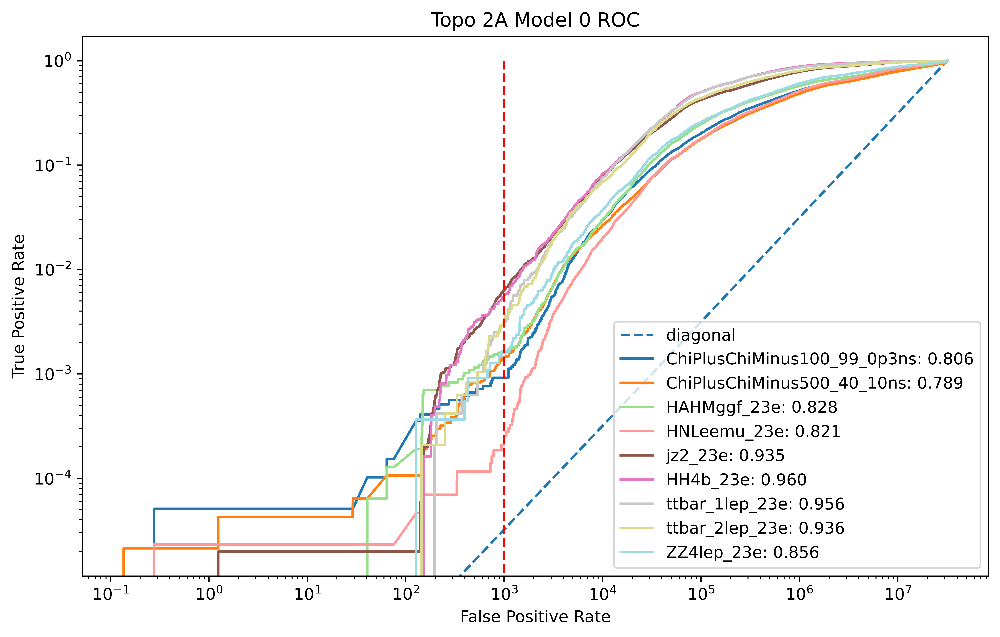


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.091743%
ChiPlusChiMinus500_40_10ns: 0.144622%
HAHMggf_23e: 0.159357%
HNLeemu_23e: 0.020845%
jz2_23e: 0.634807%
HH4b_23e: 0.557306%
ttbar_1lep_23e: 0.312565%
ttbar_2lep_23e: 0.312045%
ZZ4lep_23e: 0.164114%
Threshold = 8.706860542297363281250000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0009174311926605505), ('ChiPlusChiMinus500_40_10ns', 0.0014462238669474042), ('HAHMggf_23e', 0.001593574706782254), ('HNLeemu_23e', 0.0002084491384102279), ('jz2_23e', 0.0063480727647840665), ('HH4b_23e', 0.005573055488248122), ('ttbar_1lep_23e', 0.0031256511773286103), ('ttbar_2lep_23e', 0.0031204493447056377), ('ZZ4lep_23e', 0.0016411378555798686)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_1/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 778us/step
Lo

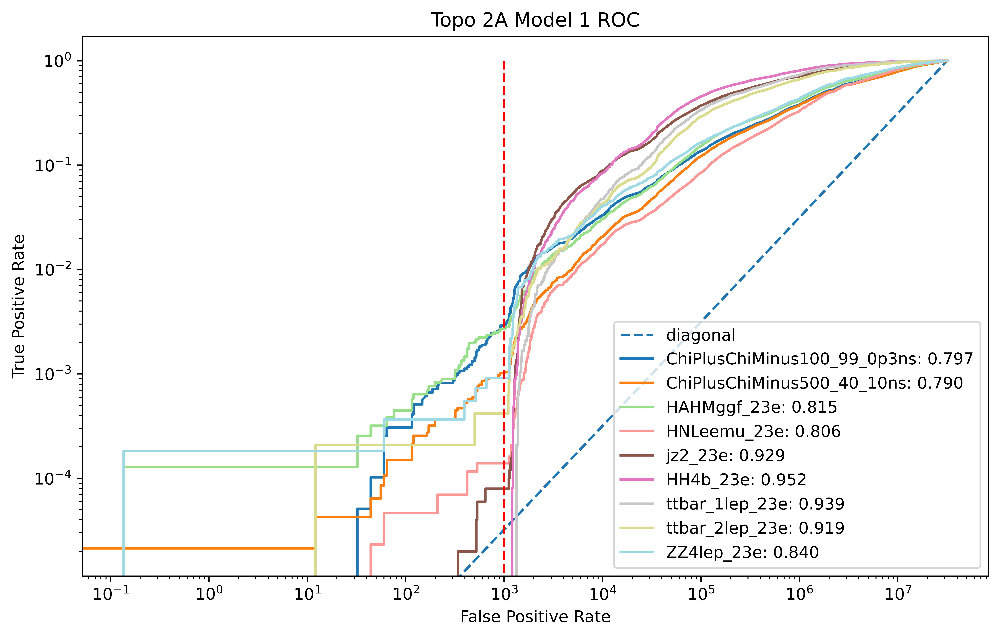


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.290520%
ChiPlusChiMinus500_40_10ns: 0.102086%
HAHMggf_23e: 0.267721%
HNLeemu_23e: 0.013897%
jz2_23e: 0.007935%
HH4b_23e: 0.000000%
ttbar_1lep_23e: 0.000000%
ttbar_2lep_23e: 0.041606%
ZZ4lep_23e: 0.091174%
Threshold = 12.678836822509765625000000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0029051987767584097), ('ChiPlusChiMinus500_40_10ns', 0.0010208639060805206), ('HAHMggf_23e', 0.0026772055073941868), ('HNLeemu_23e', 0.00013896609227348526), ('jz2_23e', 7.935090955980083e-05), ('HH4b_23e', 0.0), ('ttbar_1lep_23e', 0.0), ('ttbar_2lep_23e', 0.00041605991262741833), ('ZZ4lep_23e', 0.0009117432530999271)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_2/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 774us/step
Losses calculated
Getting perform

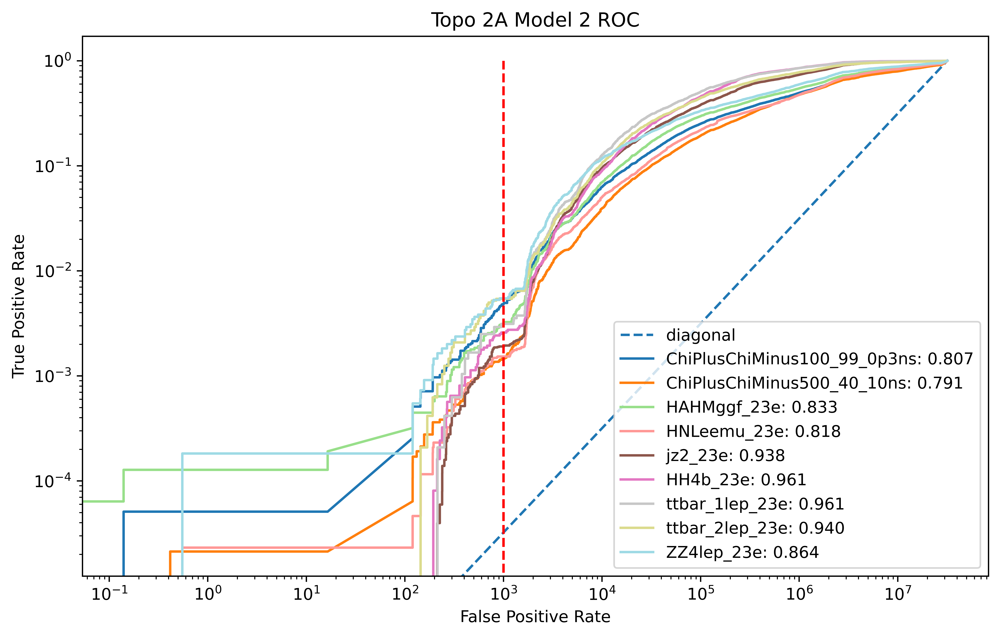


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.479103%
ChiPlusChiMinus500_40_10ns: 0.146749%
HAHMggf_23e: 0.312341%
HNLeemu_23e: 0.152863%
jz2_23e: 0.190442%
HH4b_23e: 0.258461%
ttbar_1lep_23e: 0.312565%
ttbar_2lep_23e: 0.540878%
ZZ4lep_23e: 0.547046%
Threshold = 10.324376106262207031250000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.004791029561671763), ('ChiPlusChiMinus500_40_10ns', 0.0014674918649907483), ('HAHMggf_23e', 0.0031234064252932178), ('HNLeemu_23e', 0.001528627015008338), ('jz2_23e', 0.0019044218294352198), ('HH4b_23e', 0.002584605443825216), ('ttbar_1lep_23e', 0.0031256511773286103), ('ttbar_2lep_23e', 0.005408778864156439), ('ZZ4lep_23e', 0.005470459518599562)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_3/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 794us/step
Loss

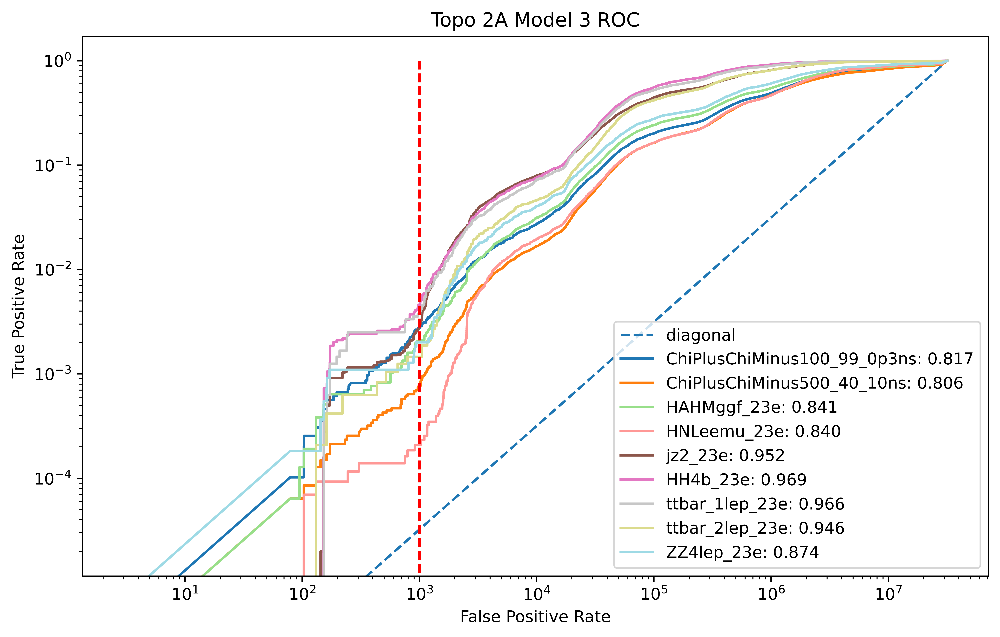


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.275229%
ChiPlusChiMinus500_40_10ns: 0.076565%
HAHMggf_23e: 0.203978%
HNLeemu_23e: 0.020845%
jz2_23e: 0.291615%
HH4b_23e: 0.460383%
ttbar_1lep_23e: 0.375078%
ttbar_2lep_23e: 0.145621%
ZZ4lep_23e: 0.200584%
Threshold = 9.563013076782226562500000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0027522935779816515), ('ChiPlusChiMinus500_40_10ns', 0.0007656479295603905), ('HAHMggf_23e', 0.002039775624681285), ('HNLeemu_23e', 0.0002084491384102279), ('jz2_23e', 0.0029161459263226806), ('HH4b_23e', 0.004603828446813666), ('ttbar_1lep_23e', 0.003750781412794332), ('ttbar_2lep_23e', 0.0014562096941959641), ('ZZ4lep_23e', 0.0020058351568198397)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_4/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 913us/step
Los

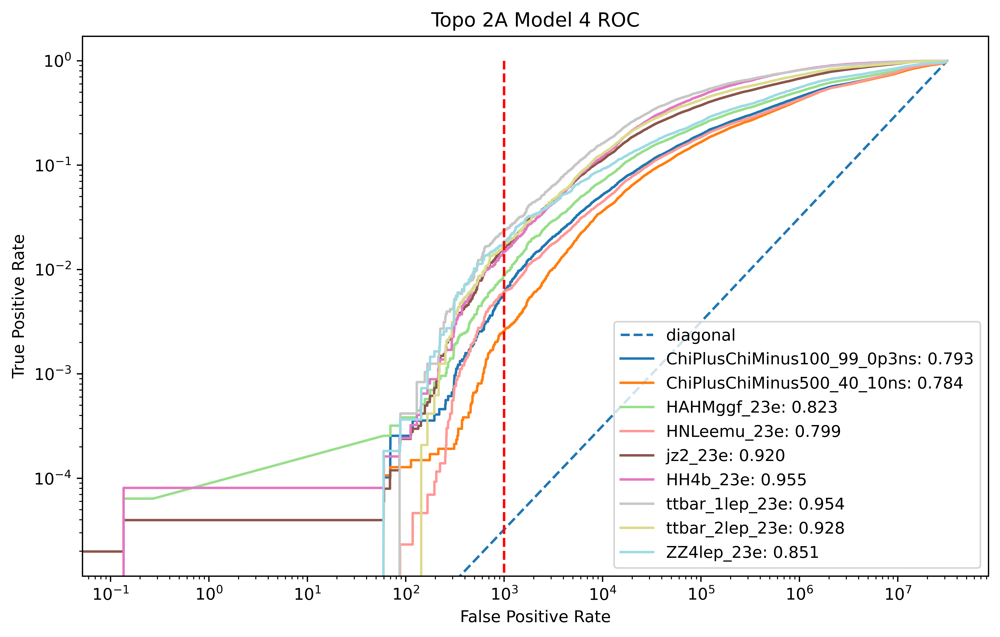


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.596330%
ChiPlusChiMinus500_40_10ns: 0.257343%
HAHMggf_23e: 0.873279%
HNLeemu_23e: 0.606819%
jz2_23e: 1.612807%
HH4b_23e: 1.469994%
ttbar_1lep_23e: 2.375495%
ttbar_2lep_23e: 1.685043%
ZZ4lep_23e: 1.859956%
Threshold = 7.521152496337890625000000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.005963302752293578), ('ChiPlusChiMinus500_40_10ns', 0.002573427763244646), ('HAHMggf_23e', 0.008732789393166752), ('HNLeemu_23e', 0.0060681860292755236), ('jz2_23e', 0.016128072368029517), ('HH4b_23e', 0.014699943461755917), ('ttbar_1lep_23e', 0.023754948947697436), ('ttbar_2lep_23e', 0.016850426461410443), ('ZZ4lep_23e', 0.018599562363238512)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_5/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 720us/step
Losses c

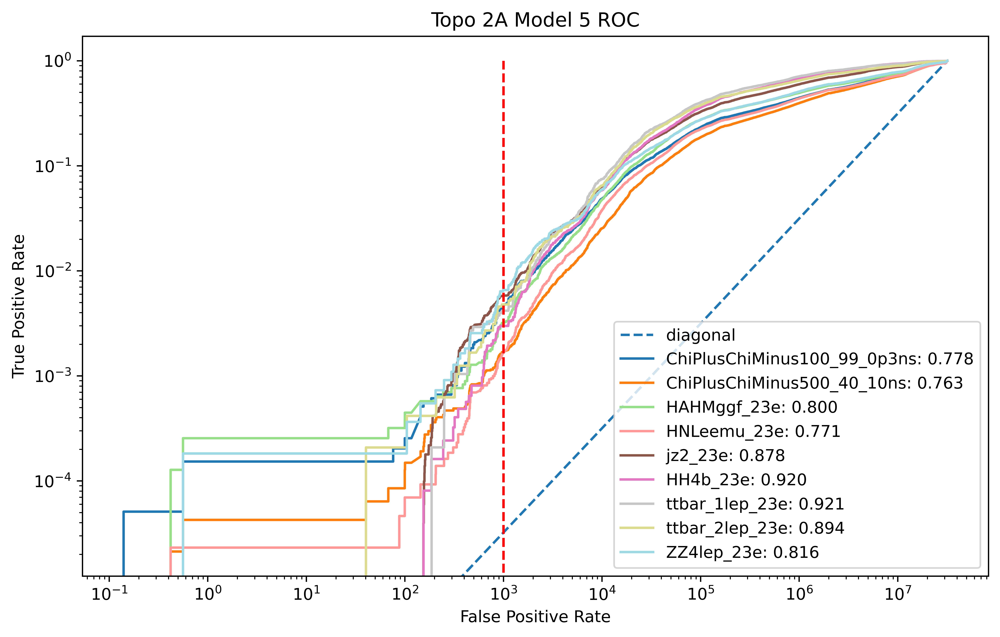


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.468909%
ChiPlusChiMinus500_40_10ns: 0.168017%
HAHMggf_23e: 0.318715%
HNLeemu_23e: 0.164443%
jz2_23e: 0.579262%
HH4b_23e: 0.298845%
ttbar_1lep_23e: 0.416753%
ttbar_2lep_23e: 0.478469%
ZZ4lep_23e: 0.656455%
Threshold = 7.558814525604248046875000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.004689092762487258), ('ChiPlusChiMinus500_40_10ns', 0.0016801718454241901), ('HAHMggf_23e', 0.003187149413564508), ('HNLeemu_23e', 0.001644432091902909), ('jz2_23e', 0.005792616397865461), ('HH4b_23e', 0.002988450044422906), ('ttbar_1lep_23e', 0.004167534903104814), ('ttbar_2lep_23e', 0.004784688995215311), ('ZZ4lep_23e', 0.006564551422319475)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_6/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 763us/step
Losses c

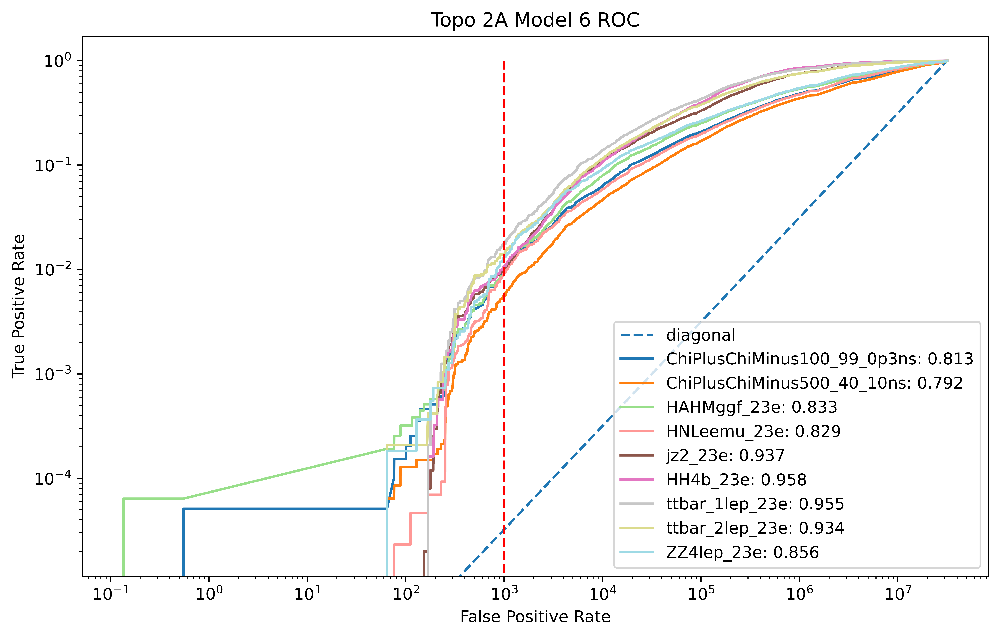


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.942915%
ChiPlusChiMinus500_40_10ns: 0.563602%
HAHMggf_23e: 0.924273%
HNLeemu_23e: 0.919492%
jz2_23e: 1.027594%
HH4b_23e: 1.066150%
ttbar_1lep_23e: 1.750365%
ttbar_2lep_23e: 1.414604%
ZZ4lep_23e: 1.312910%
Threshold = 9.080739021301269531250000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.009429153924566768), ('ChiPlusChiMinus500_40_10ns', 0.005636019481486208), ('HAHMggf_23e', 0.009242733299337074), ('HNLeemu_23e', 0.009194923105428942), ('jz2_23e', 0.010275942787994208), ('HH4b_23e', 0.010661497455779016), ('ttbar_1lep_23e', 0.017503646593040215), ('ttbar_2lep_23e', 0.014146037029332224), ('ZZ4lep_23e', 0.01312910284463895)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_7/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 752us/step
Losses cal

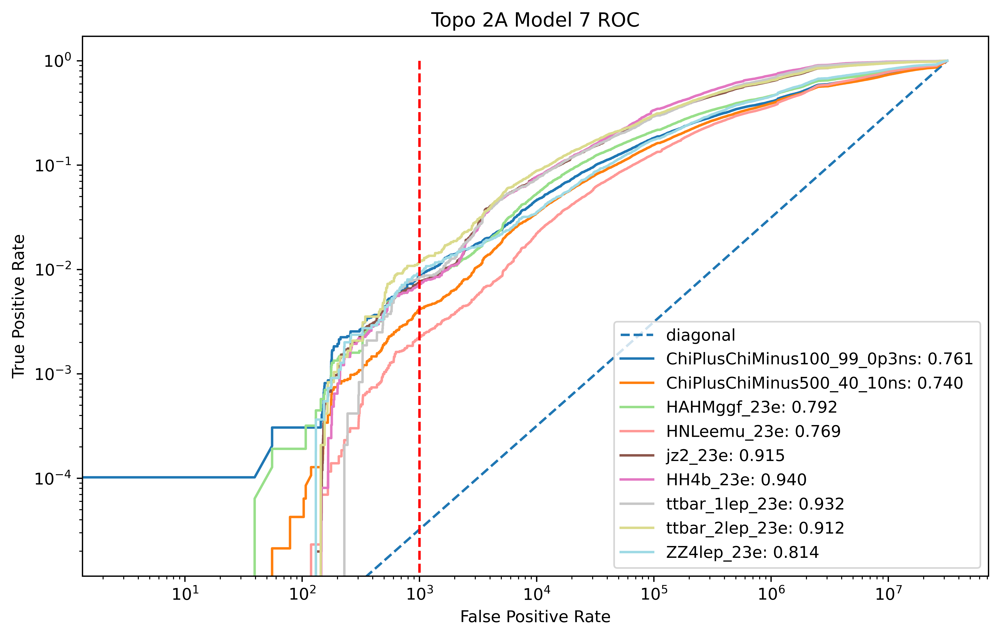


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.871560%
ChiPlusChiMinus500_40_10ns: 0.416853%
HAHMggf_23e: 0.745793%
HNLeemu_23e: 0.224662%
jz2_23e: 0.751850%
HH4b_23e: 0.718843%
ttbar_1lep_23e: 0.833507%
ttbar_2lep_23e: 1.164968%
ZZ4lep_23e: 0.911743%
Threshold = 8.505808830261230468750000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.00871559633027523), ('ChiPlusChiMinus500_40_10ns', 0.00416852761649546), ('HAHMggf_23e', 0.007457929627740949), ('HNLeemu_23e', 0.0022466184917546783), ('jz2_23e', 0.0075184986807911285), ('HH4b_23e', 0.007188433890638882), ('ttbar_1lep_23e', 0.008335069806209627), ('ttbar_2lep_23e', 0.011649677553567713), ('ZZ4lep_23e', 0.00911743253099927)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_8/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 788us/step
Losses cal

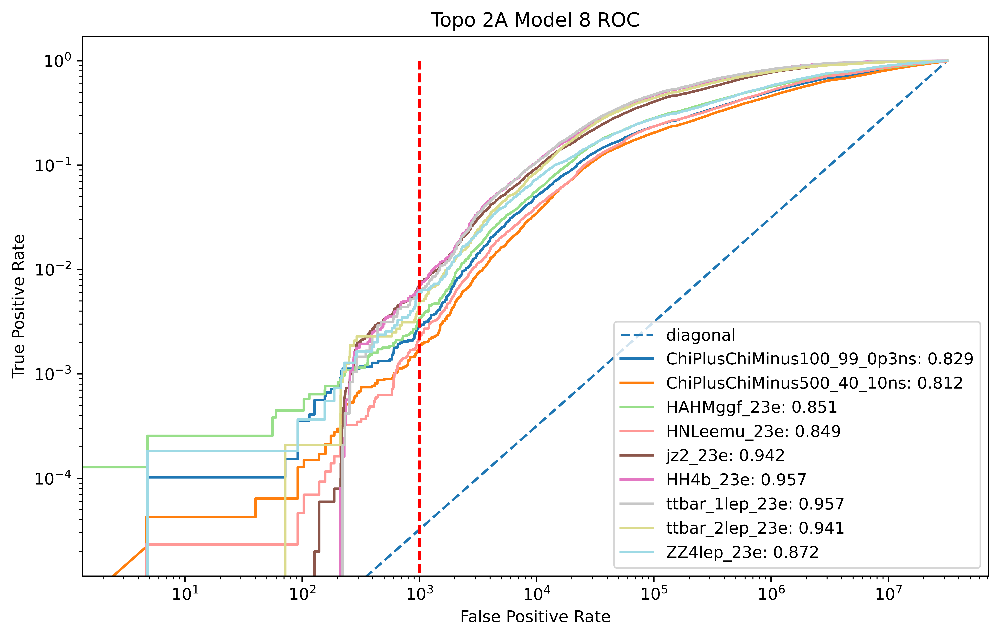


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.280326%
ChiPlusChiMinus500_40_10ns: 0.185032%
HAHMggf_23e: 0.337838%
HNLeemu_23e: 0.222346%
jz2_23e: 0.718126%
HH4b_23e: 0.694613%
ttbar_1lep_23e: 0.583455%
ttbar_2lep_23e: 0.478469%
ZZ4lep_23e: 0.601751%
Threshold = 8.825993537902832031250000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0028032619775739042), ('ChiPlusChiMinus500_40_10ns', 0.0018503158297709437), ('HAHMggf_23e', 0.0033783783783783786), ('HNLeemu_23e', 0.0022234574763757642), ('jz2_23e', 0.007181257315161975), ('HH4b_23e', 0.006946127130280268), ('ttbar_1lep_23e', 0.005834548864346739), ('ttbar_2lep_23e', 0.004784688995215311), ('ZZ4lep_23e', 0.006017505470459519)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_9/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 730us/step
Losse

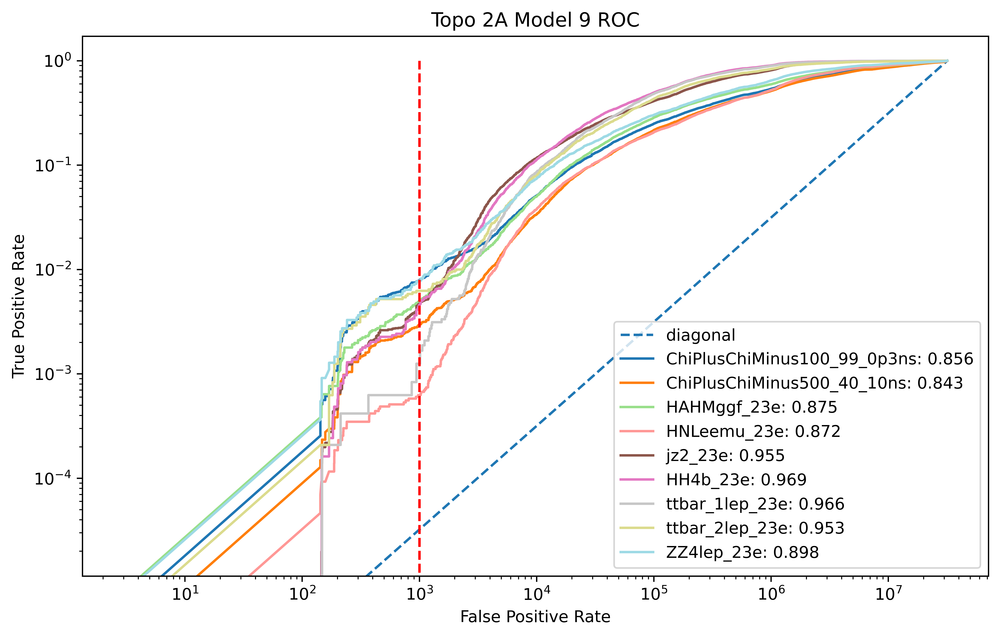


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.790010%
ChiPlusChiMinus500_40_10ns: 0.295625%
HAHMggf_23e: 0.497195%
HNLeemu_23e: 0.062535%
jz2_23e: 0.466187%
HH4b_23e: 0.452306%
ttbar_1lep_23e: 0.125026%
ttbar_2lep_23e: 0.624090%
ZZ4lep_23e: 0.784099%
Threshold = 9.730275154113769531250000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.007900101936799185), ('ChiPlusChiMinus500_40_10ns', 0.002956251728024841), ('HAHMggf_23e', 0.004971953085160632), ('HNLeemu_23e', 0.0006253474152306837), ('jz2_23e', 0.0046618659366382985), ('HH4b_23e', 0.004523059526694128), ('ttbar_1lep_23e', 0.001250260470931444), ('ttbar_2lep_23e', 0.006240898689411275), ('ZZ4lep_23e', 0.007840991976659373)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_10/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 956us/step
Losses

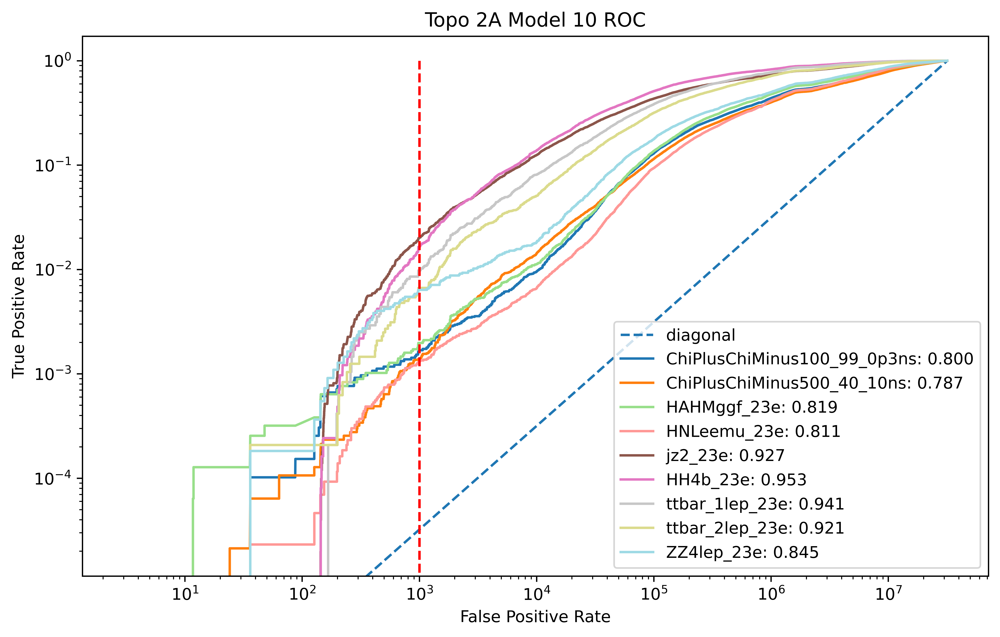


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.168196%
ChiPlusChiMinus500_40_10ns: 0.138242%
HAHMggf_23e: 0.197603%
HNLeemu_23e: 0.129702%
jz2_23e: 2.011546%
HH4b_23e: 1.663840%
ttbar_1lep_23e: 0.979371%
ttbar_2lep_23e: 0.665696%
ZZ4lep_23e: 0.638220%
Threshold = 9.381340026855468750000000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0016819571865443425), ('ChiPlusChiMinus500_40_10ns', 0.0013824198728173717), ('HAHMggf_23e', 0.001976032636409995), ('HNLeemu_23e', 0.0012970168612191958), ('jz2_23e', 0.02011545557340951), ('HH4b_23e', 0.016638397544624827), ('ttbar_1lep_23e', 0.009793707022296311), ('ttbar_2lep_23e', 0.006656958602038693), ('ZZ4lep_23e', 0.006382202771699489)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_11/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 725us/step
Losses

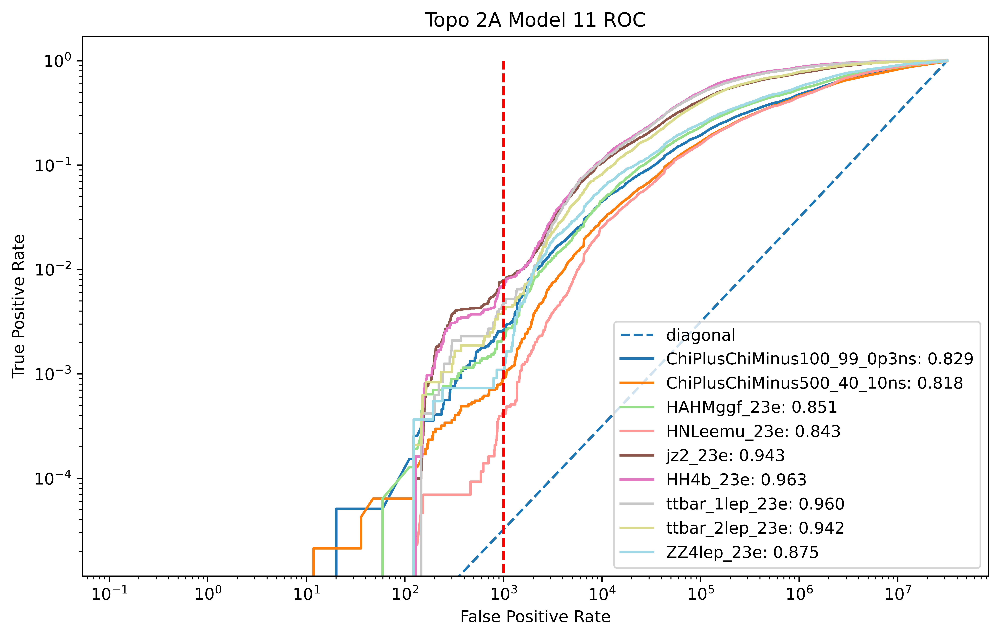


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.259939%
ChiPlusChiMinus500_40_10ns: 0.089326%
HAHMggf_23e: 0.223100%
HNLeemu_23e: 0.041690%
jz2_23e: 0.783590%
HH4b_23e: 0.702690%
ttbar_1lep_23e: 0.458429%
ttbar_2lep_23e: 0.395257%
ZZ4lep_23e: 0.109409%
Threshold = 11.616620063781738281250000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.002599388379204893), ('ChiPlusChiMinus500_40_10ns', 0.0008932559178204555), ('HAHMggf_23e', 0.0022310045894951554), ('HNLeemu_23e', 0.0004168982768204558), ('jz2_23e', 0.007835902319030332), ('HH4b_23e', 0.007026896050399806), ('ttbar_1lep_23e', 0.004584288393415295), ('ttbar_2lep_23e', 0.003952569169960474), ('ZZ4lep_23e', 0.0010940919037199124)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_12/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 704us/step
Los

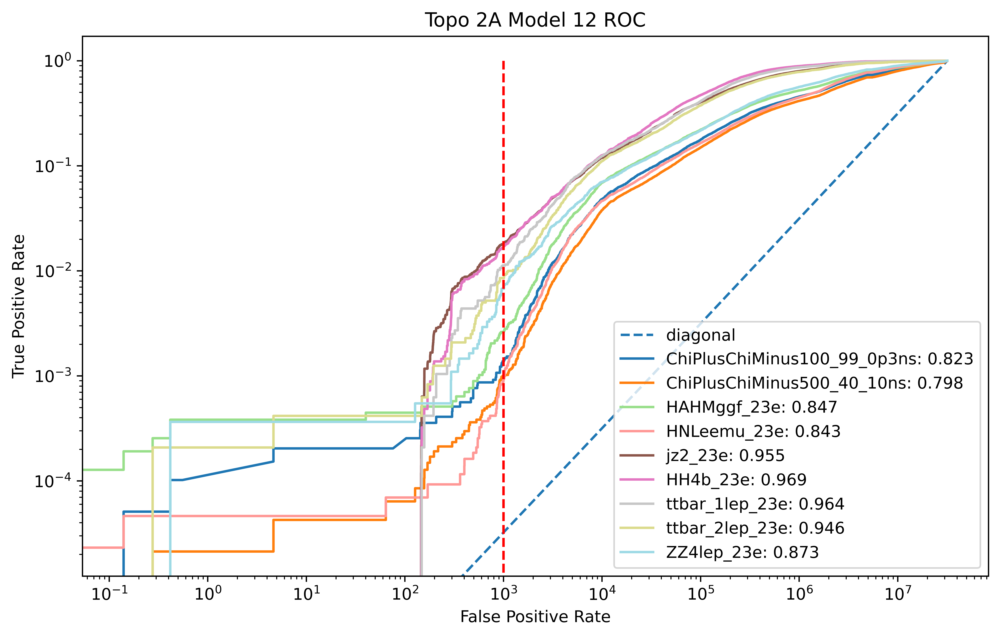


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.137615%
ChiPlusChiMinus500_40_10ns: 0.099960%
HAHMggf_23e: 0.261346%
HNLeemu_23e: 0.088012%
jz2_23e: 1.807217%
HH4b_23e: 1.679994%
ttbar_1lep_23e: 1.125234%
ttbar_2lep_23e: 0.852923%
ZZ4lep_23e: 0.674690%
Threshold = 8.362279891967773437500000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0013761467889908258), ('ChiPlusChiMinus500_40_10ns', 0.0009995959080371765), ('HAHMggf_23e', 0.0026134625191228966), ('HNLeemu_23e', 0.0008801185843987401), ('jz2_23e', 0.01807216965224464), ('HH4b_23e', 0.016799935384863903), ('ttbar_1lep_23e', 0.011252344238382997), ('ttbar_2lep_23e', 0.008529228208862077), ('ZZ4lep_23e', 0.00674690007293946)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_13/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 768us/step
Losses

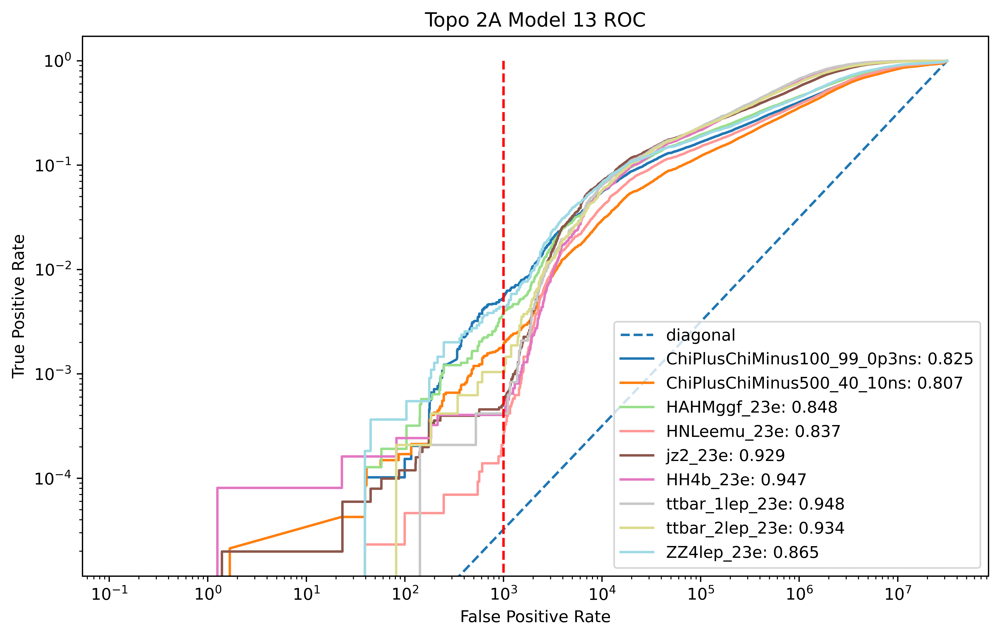


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.540265%
ChiPlusChiMinus500_40_10ns: 0.189285%
HAHMggf_23e: 0.388832%
HNLeemu_23e: 0.023161%
jz2_23e: 0.051578%
HH4b_23e: 0.040384%
ttbar_1lep_23e: 0.041675%
ttbar_2lep_23e: 0.104015%
ZZ4lep_23e: 0.437637%
Threshold = 7.275264263153076171875000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.005402650356778797), ('ChiPlusChiMinus500_40_10ns', 0.001892851825857632), ('HAHMggf_23e', 0.0038883222845486998), ('HNLeemu_23e', 0.0002316101537891421), ('jz2_23e', 0.0005157809121387054), ('HH4b_23e', 0.00040384460059769), ('ttbar_1lep_23e', 0.00041675349031048136), ('ttbar_2lep_23e', 0.001040149781568546), ('ZZ4lep_23e', 0.00437636761487965)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_14/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 705us/step
Losse

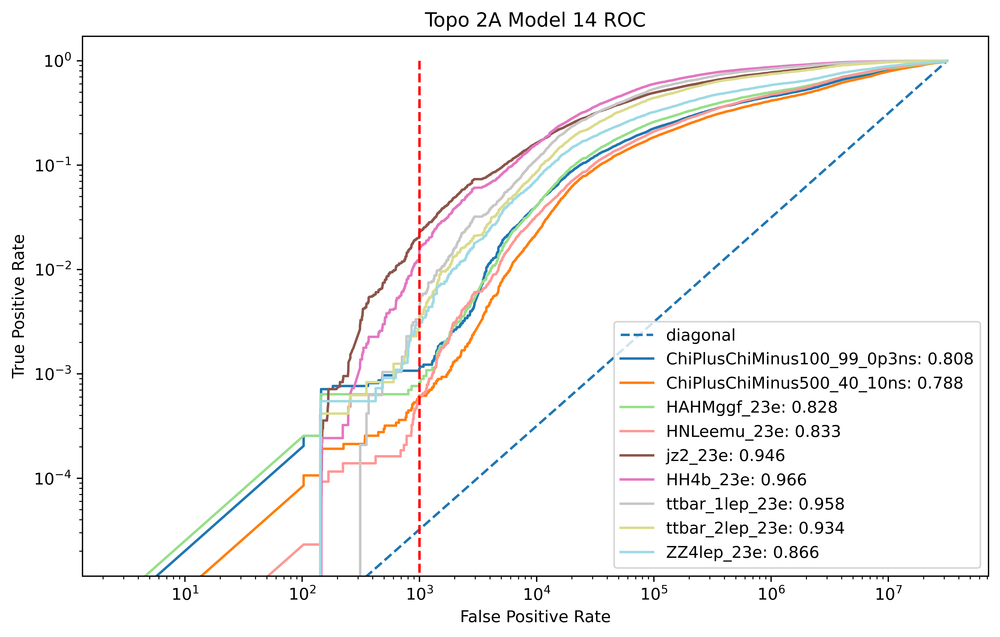


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.112130%
ChiPlusChiMinus500_40_10ns: 0.061677%
HAHMggf_23e: 0.082866%
HNLeemu_23e: 0.057903%
jz2_23e: 2.281339%
HH4b_23e: 1.583071%
ttbar_1lep_23e: 0.437591%
ttbar_2lep_23e: 0.353651%
ZZ4lep_23e: 0.309993%
Threshold = 9.563543319702148437500000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0011213047910295616), ('ChiPlusChiMinus500_40_10ns', 0.0006167719432569812), ('HAHMggf_23e', 0.0008286588475267721), ('HNLeemu_23e', 0.0005790253844728553), ('jz2_23e', 0.02281338649844274), ('HH4b_23e', 0.015830708343429447), ('ttbar_1lep_23e', 0.004375911648260054), ('ttbar_2lep_23e', 0.003536509257333056), ('ZZ4lep_23e', 0.003099927060539752)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_15/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 912us/step
Losse

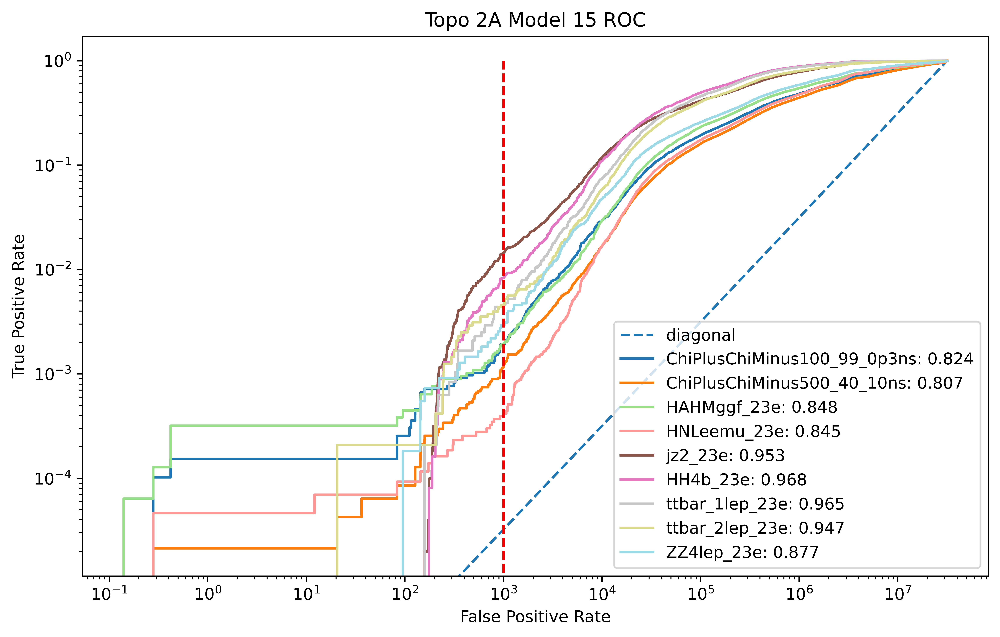


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.193680%
ChiPlusChiMinus500_40_10ns: 0.114847%
HAHMggf_23e: 0.191229%
HNLeemu_23e: 0.039374%
jz2_23e: 1.432284%
HH4b_23e: 0.831920%
ttbar_1lep_23e: 0.458429%
ttbar_2lep_23e: 0.457666%
ZZ4lep_23e: 0.291758%
Threshold = 9.587817192077636718750000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0019367991845056064), ('ChiPlusChiMinus500_40_10ns', 0.0011484718943405856), ('HAHMggf_23e', 0.0019122896481387048), ('HNLeemu_23e', 0.0003937372614415416), ('jz2_23e', 0.01432283917554405), ('HH4b_23e', 0.008319198772312414), ('ttbar_1lep_23e', 0.004584288393415295), ('ttbar_2lep_23e', 0.004576659038901602), ('ZZ4lep_23e', 0.0029175784099197666)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_16/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 716us/step
Loss

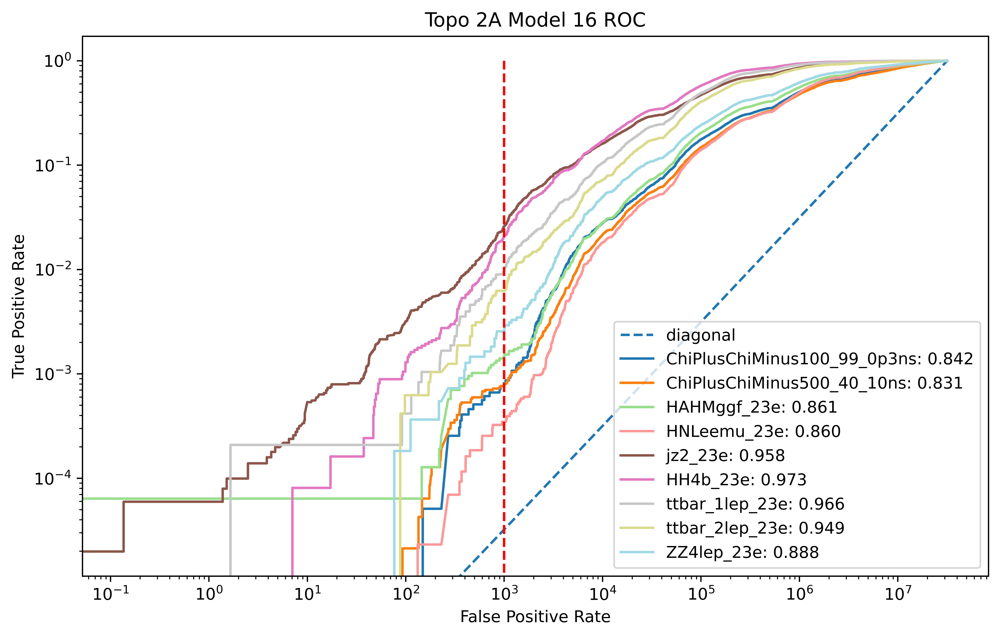


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.081549%
ChiPlusChiMinus500_40_10ns: 0.076565%
HAHMggf_23e: 0.146609%
HNLeemu_23e: 0.034742%
jz2_23e: 2.588823%
HH4b_23e: 2.067684%
ttbar_1lep_23e: 0.979371%
ttbar_2lep_23e: 0.624090%
ZZ4lep_23e: 0.255288%
Threshold = 10.122086524963378906250000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0008154943934760449), ('ChiPlusChiMinus500_40_10ns', 0.0007656479295603905), ('HAHMggf_23e', 0.0014660887302396736), ('HNLeemu_23e', 0.0003474152306837132), ('jz2_23e', 0.02588823424388502), ('HH4b_23e', 0.020676843550601728), ('ttbar_1lep_23e', 0.009793707022296311), ('ttbar_2lep_23e', 0.006240898689411275), ('ZZ4lep_23e', 0.002552881108679796)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_17/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 713us/step
Loss

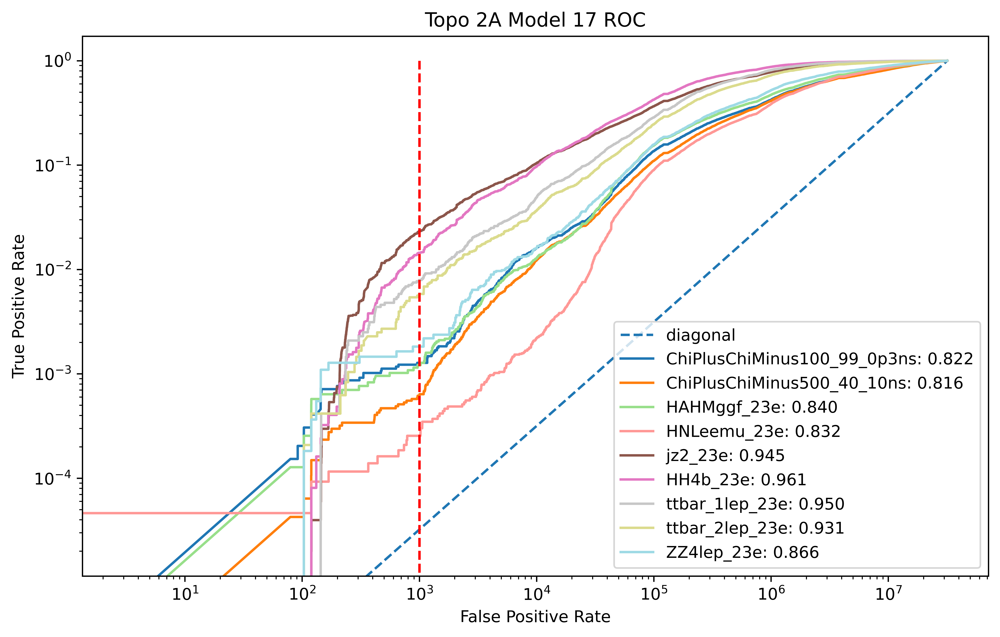


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.127421%
ChiPlusChiMinus500_40_10ns: 0.061677%
HAHMggf_23e: 0.121112%
HNLeemu_23e: 0.025477%
jz2_23e: 2.326965%
HH4b_23e: 1.445764%
ttbar_1lep_23e: 0.791832%
ttbar_2lep_23e: 0.582484%
ZZ4lep_23e: 0.182349%
Threshold = 9.455176353454589843750000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0012742099898063201), ('ChiPlusChiMinus500_40_10ns', 0.0006167719432569812), ('HAHMggf_23e', 0.001211116777154513), ('HNLeemu_23e', 0.00025477116916805634), ('jz2_23e', 0.023269654228411592), ('HH4b_23e', 0.014457636701397302), ('ttbar_1lep_23e', 0.007918316315899145), ('ttbar_2lep_23e', 0.005824838776783857), ('ZZ4lep_23e', 0.0018234865061998542)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_18/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 739us/step
Los

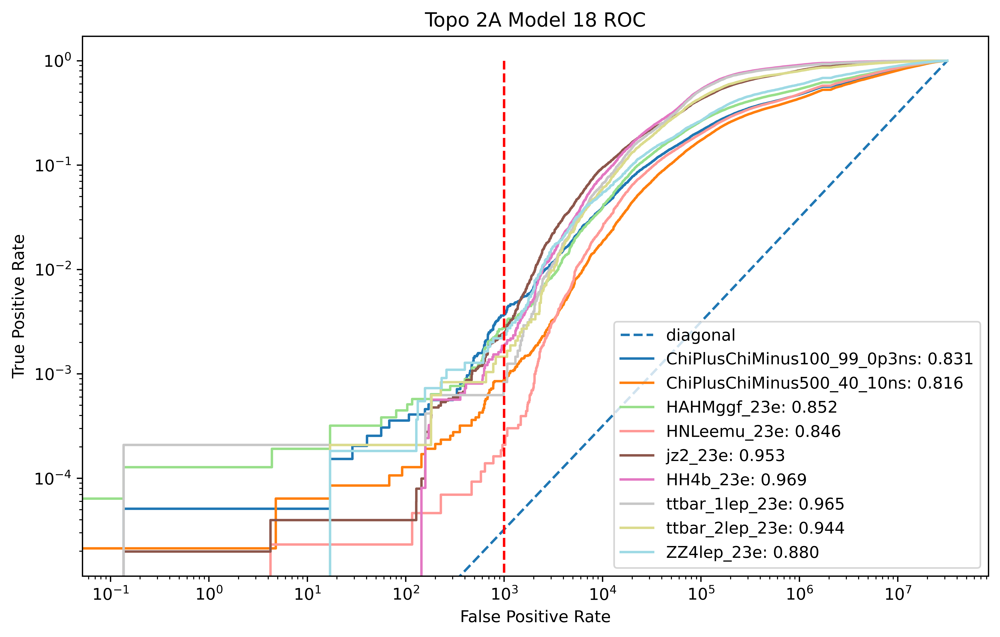


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.372069%
ChiPlusChiMinus500_40_10ns: 0.087199%
HAHMggf_23e: 0.274095%
HNLeemu_23e: 0.020845%
jz2_23e: 0.244004%
HH4b_23e: 0.185769%
ttbar_1lep_23e: 0.083351%
ttbar_2lep_23e: 0.145621%
ZZ4lep_23e: 0.237053%
Threshold = 8.100311279296875000000000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0037206931702344547), ('ChiPlusChiMinus500_40_10ns', 0.0008719879197771114), ('HAHMggf_23e', 0.002740948495665477), ('HNLeemu_23e', 0.0002084491384102279), ('jz2_23e', 0.0024400404689638756), ('HH4b_23e', 0.001857685162749374), ('ttbar_1lep_23e', 0.0008335069806209627), ('ttbar_2lep_23e', 0.0014562096941959641), ('ZZ4lep_23e', 0.0023705324580598104)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_19/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 904us/step
L

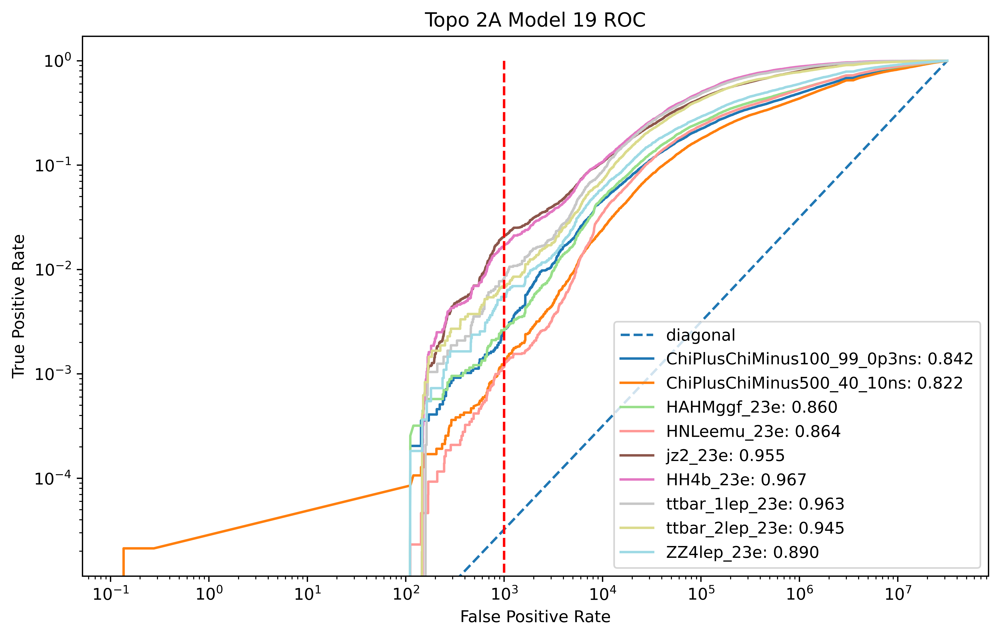


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.254842%
ChiPlusChiMinus500_40_10ns: 0.125481%
HAHMggf_23e: 0.261346%
HNLeemu_23e: 0.115805%
jz2_23e: 2.049237%
HH4b_23e: 1.671917%
ttbar_1lep_23e: 0.812669%
ttbar_2lep_23e: 0.686499%
ZZ4lep_23e: 0.547046%
Threshold = 7.668685913085937500000000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0025484199796126403), ('ChiPlusChiMinus500_40_10ns', 0.0012548118845573065), ('HAHMggf_23e', 0.0026134625191228966), ('HNLeemu_23e', 0.0011580507689457106), ('jz2_23e', 0.020492372393818563), ('HH4b_23e', 0.016719166464744365), ('ttbar_1lep_23e', 0.008126693061054386), ('ttbar_2lep_23e', 0.006864988558352402), ('ZZ4lep_23e', 0.005470459518599562)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_20/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 994us/step
Loss

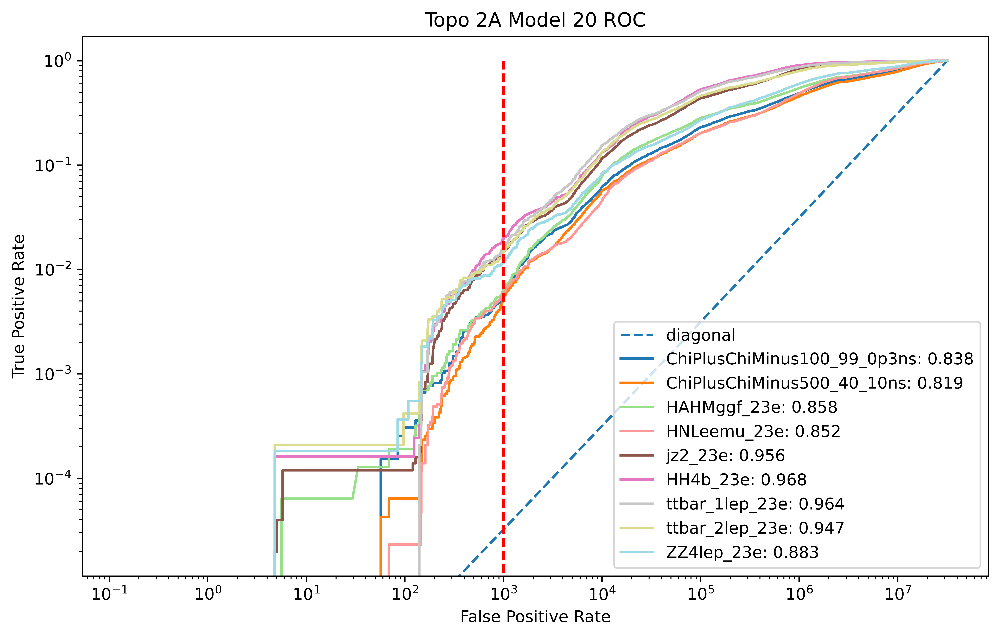


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.596330%
ChiPlusChiMinus500_40_10ns: 0.518939%
HAHMggf_23e: 0.631056%
HNLeemu_23e: 0.574393%
jz2_23e: 1.464024%
HH4b_23e: 1.954608%
ttbar_1lep_23e: 1.604501%
ttbar_2lep_23e: 1.456210%
ZZ4lep_23e: 1.148796%
Threshold = 7.214246749877929687500000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.005963302752293578), ('ChiPlusChiMinus500_40_10ns', 0.00518939152257598), ('HAHMggf_23e', 0.006310555838857725), ('HNLeemu_23e', 0.005743931813970725), ('jz2_23e', 0.014640242813783254), ('HH4b_23e', 0.019546078668928196), ('ttbar_1lep_23e', 0.016045009376953533), ('ttbar_2lep_23e', 0.014562096941959642), ('ZZ4lep_23e', 0.011487964989059081)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_21/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 800us/step
Losses ca

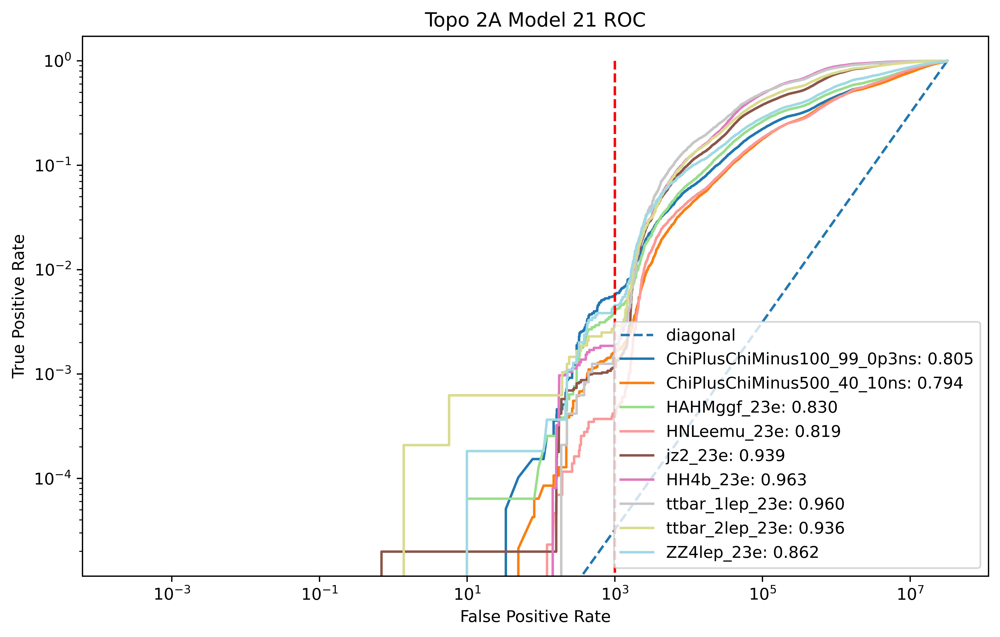


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.565749%
ChiPlusChiMinus500_40_10ns: 0.159510%
HAHMggf_23e: 0.388832%
HNLeemu_23e: 0.041690%
jz2_23e: 0.115059%
HH4b_23e: 0.185769%
ttbar_1lep_23e: 0.145864%
ttbar_2lep_23e: 0.291242%
ZZ4lep_23e: 0.437637%
Threshold = 8.200562477111816406250000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.005657492354740061), ('ChiPlusChiMinus500_40_10ns', 0.0015950998532508135), ('HAHMggf_23e', 0.0038883222845486998), ('HNLeemu_23e', 0.0004168982768204558), ('jz2_23e', 0.001150588188617112), ('HH4b_23e', 0.001857685162749374), ('ttbar_1lep_23e', 0.0014586372160866848), ('ttbar_2lep_23e', 0.0029124193883919283), ('ZZ4lep_23e', 0.00437636761487965)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_22/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 689us/step
Loss

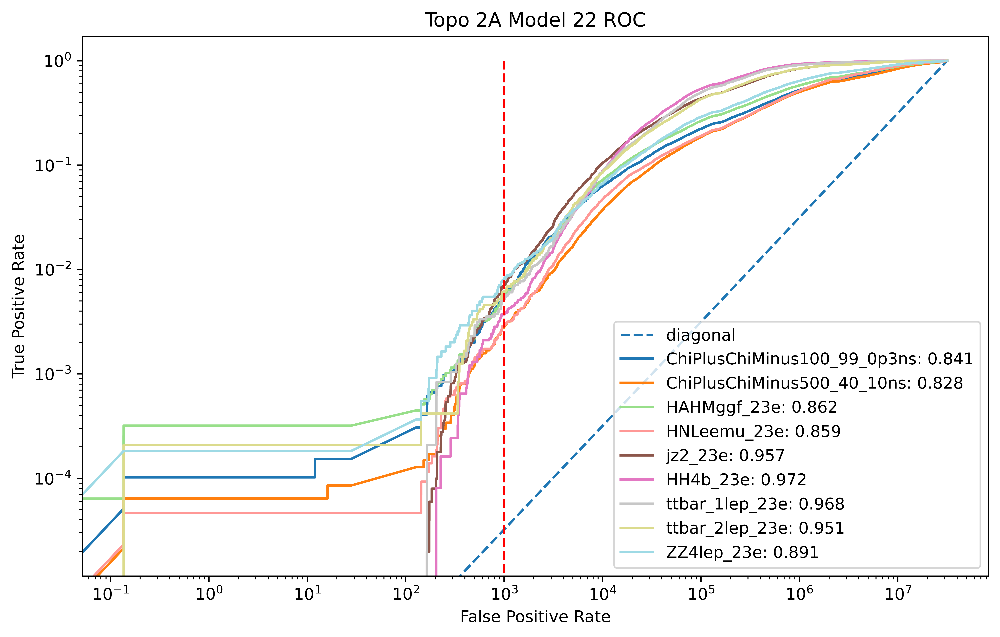


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.560652%
ChiPlusChiMinus500_40_10ns: 0.276484%
HAHMggf_23e: 0.535441%
HNLeemu_23e: 0.287197%
jz2_23e: 0.694320%
HH4b_23e: 0.371537%
ttbar_1lep_23e: 0.520942%
ttbar_2lep_23e: 0.603287%
ZZ4lep_23e: 0.784099%
Threshold = 7.565685749053955078125000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0056065239551478085), ('ChiPlusChiMinus500_40_10ns', 0.0027648397456347435), ('HAHMggf_23e', 0.0053544110147883735), ('HNLeemu_23e', 0.0028719659069853624), ('jz2_23e', 0.006943204586482572), ('HH4b_23e', 0.003715370325498748), ('ttbar_1lep_23e', 0.005209418628881017), ('ttbar_2lep_23e', 0.006032868733097566), ('ZZ4lep_23e', 0.007840991976659373)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_23/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 688us/step
Loss

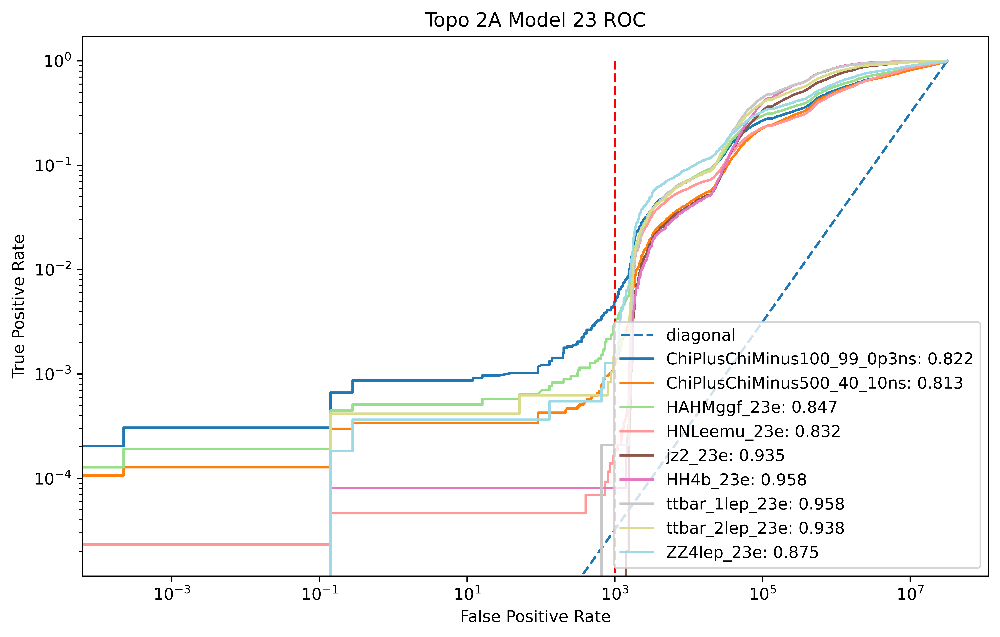


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.489297%
ChiPlusChiMinus500_40_10ns: 0.125481%
HAHMggf_23e: 0.305966%
HNLeemu_23e: 0.018529%
jz2_23e: 0.000000%
HH4b_23e: 0.008077%
ttbar_1lep_23e: 0.020838%
ttbar_2lep_23e: 0.166424%
ZZ4lep_23e: 0.127644%
Threshold = 17.483903884887695312500000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.004892966360856269), ('ChiPlusChiMinus500_40_10ns', 0.0012548118845573065), ('HAHMggf_23e', 0.0030596634370219276), ('HNLeemu_23e', 0.00018528812303131369), ('jz2_23e', 0.0), ('HH4b_23e', 8.0768920119538e-05), ('ttbar_1lep_23e', 0.00020837674515524068), ('ttbar_2lep_23e', 0.0016642396505096733), ('ZZ4lep_23e', 0.001276440554339898)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_24/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 812us/step
Losses calculated


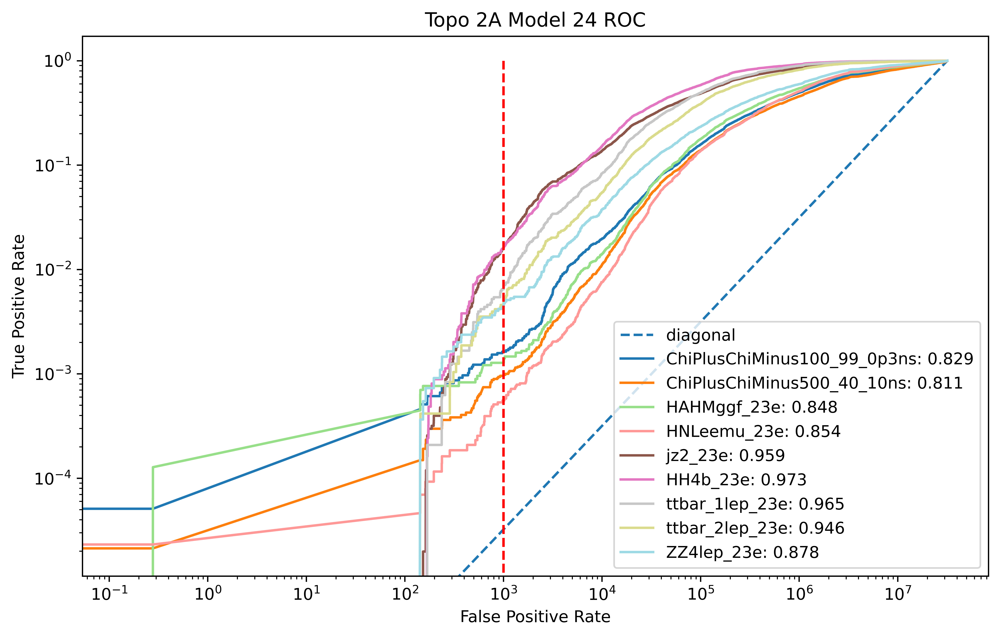


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.163099%
ChiPlusChiMinus500_40_10ns: 0.095706%
HAHMggf_23e: 0.127486%
HNLeemu_23e: 0.055586%
jz2_23e: 1.583051%
HH4b_23e: 1.591148%
ttbar_1lep_23e: 0.645968%
ttbar_2lep_23e: 0.457666%
ZZ4lep_23e: 0.437637%
Threshold = 8.953518867492675781250000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0016309887869520897), ('ChiPlusChiMinus500_40_10ns', 0.0009570599119504881), ('HAHMggf_23e', 0.0012748597654258032), ('HNLeemu_23e', 0.0005558643690939411), ('jz2_23e', 0.015830506457180267), ('HH4b_23e', 0.015911477263548985), ('ttbar_1lep_23e', 0.006459679099812461), ('ttbar_2lep_23e', 0.004576659038901602), ('ZZ4lep_23e', 0.00437636761487965)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_25/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 899us/step
Losse

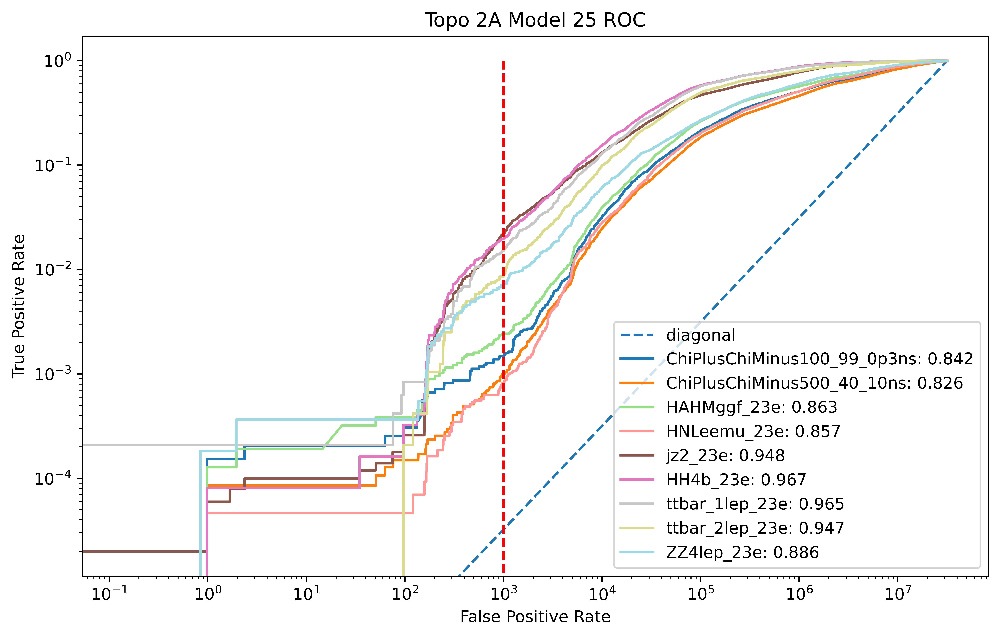


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.147808%
ChiPlusChiMinus500_40_10ns: 0.099960%
HAHMggf_23e: 0.242223%
HNLeemu_23e: 0.081064%
jz2_23e: 2.178182%
HH4b_23e: 1.962685%
ttbar_1lep_23e: 1.500313%
ttbar_2lep_23e: 0.852923%
ZZ4lep_23e: 0.711160%
Threshold = 8.057421684265136718750000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0014780835881753314), ('ChiPlusChiMinus500_40_10ns', 0.0009995959080371765), ('HAHMggf_23e', 0.002422233554309026), ('HNLeemu_23e', 0.0008106355382619975), ('jz2_23e', 0.021781824674165326), ('HH4b_23e', 0.019626847589047734), ('ttbar_1lep_23e', 0.015003125651177328), ('ttbar_2lep_23e', 0.008529228208862077), ('ZZ4lep_23e', 0.007111597374179431)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_26/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 870us/step
Losse

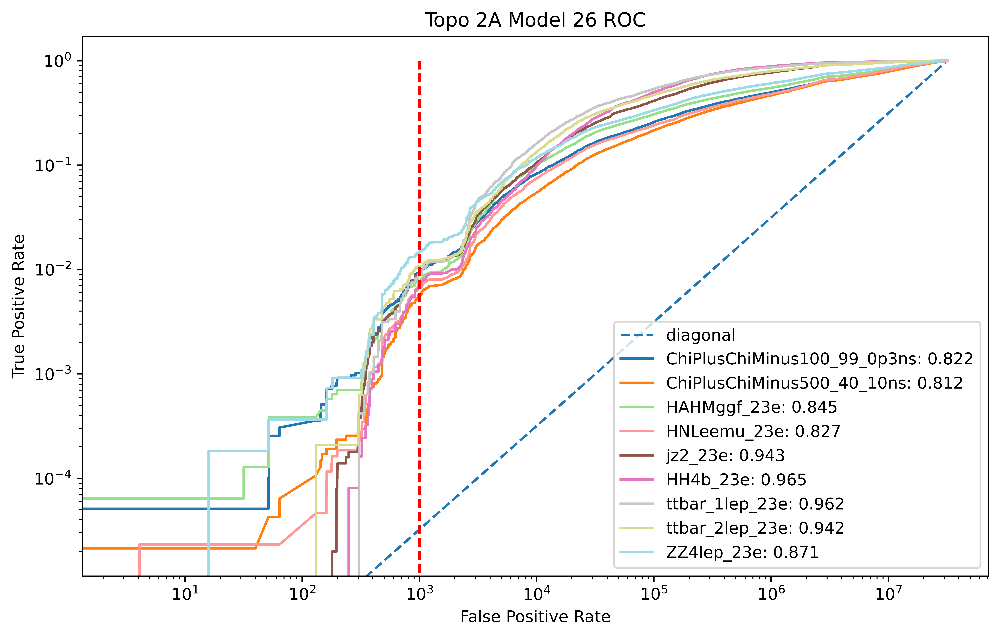


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.927625%
ChiPlusChiMinus500_40_10ns: 0.569982%
HAHMggf_23e: 0.790413%
HNLeemu_23e: 0.662405%
jz2_23e: 0.930389%
HH4b_23e: 0.710766%
ttbar_1lep_23e: 0.896020%
ttbar_2lep_23e: 1.081756%
ZZ4lep_23e: 1.458789%
Threshold = 8.743032455444335937500000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.00927624872579001), ('ChiPlusChiMinus500_40_10ns', 0.0056998234756162405), ('HAHMggf_23e', 0.00790413054563998), ('HNLeemu_23e', 0.006624050398369464), ('jz2_23e', 0.009303894145886647), ('HH4b_23e', 0.007107664970519344), ('ttbar_1lep_23e', 0.008960200041675349), ('ttbar_2lep_23e', 0.010817557728312877), ('ZZ4lep_23e', 0.014587892049598834)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_27/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 671us/step
Losses ca

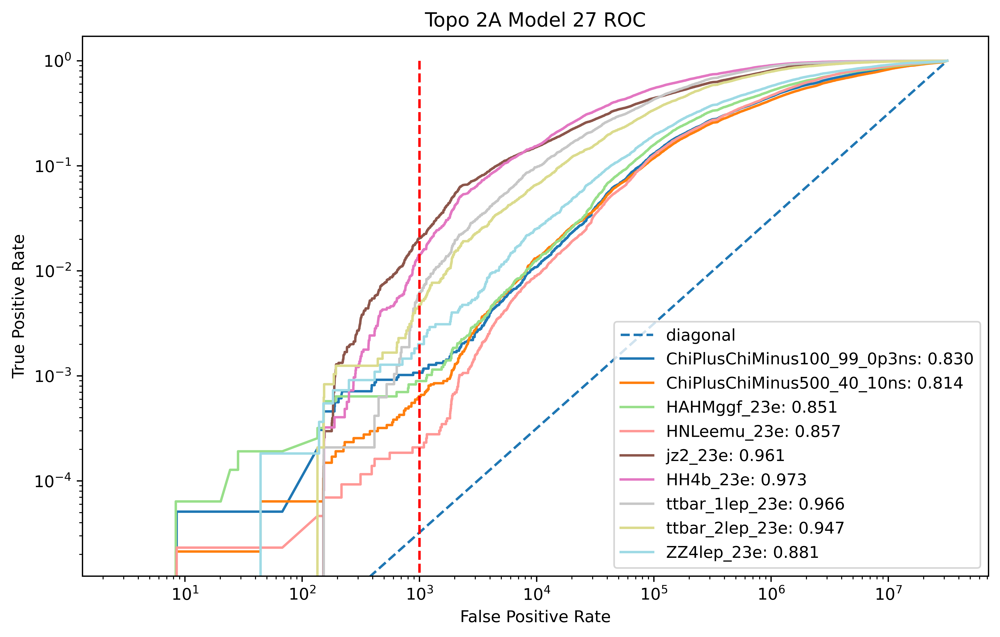


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.107034%
ChiPlusChiMinus500_40_10ns: 0.063804%
HAHMggf_23e: 0.089240%
HNLeemu_23e: 0.020845%
jz2_23e: 2.031383%
HH4b_23e: 1.429610%
ttbar_1lep_23e: 0.604293%
ttbar_2lep_23e: 0.478469%
ZZ4lep_23e: 0.200584%
Threshold = 7.043621063232421875000000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.0010703363914373089), ('ChiPlusChiMinus500_40_10ns', 0.0006380399413003254), ('HAHMggf_23e', 0.0008924018357980622), ('HNLeemu_23e', 0.0002084491384102279), ('jz2_23e', 0.02031383284730901), ('HH4b_23e', 0.014296098861158226), ('ttbar_1lep_23e', 0.0060429256095019795), ('ttbar_2lep_23e', 0.004784688995215311), ('ZZ4lep_23e', 0.0020058351568198397)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_28/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 839us/step
Los

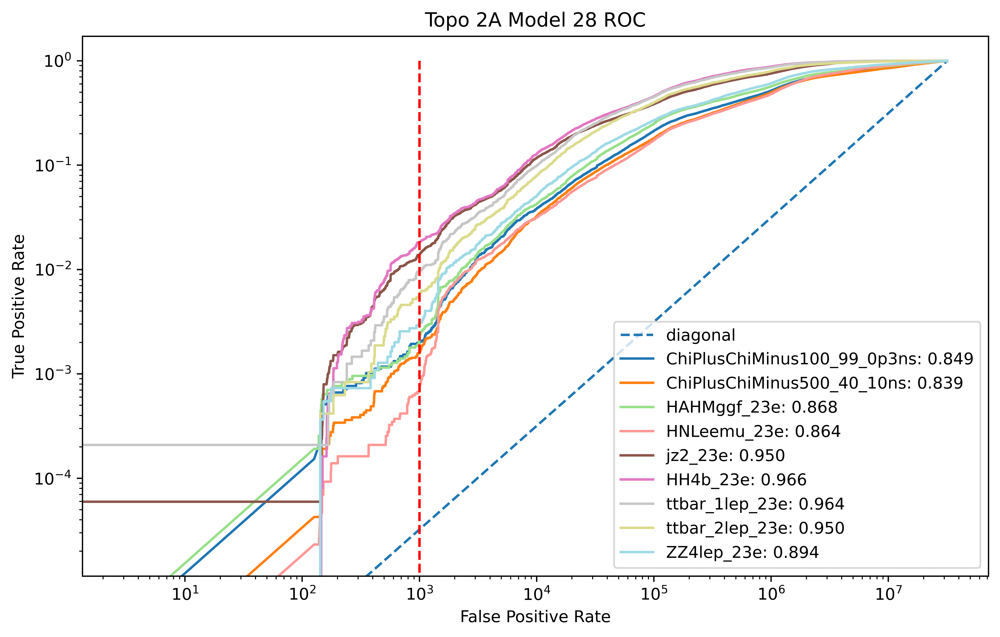


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.198777%
ChiPlusChiMinus500_40_10ns: 0.157383%
HAHMggf_23e: 0.216726%
HNLeemu_23e: 0.067167%
jz2_23e: 1.384673%
HH4b_23e: 1.817301%
ttbar_1lep_23e: 0.958533%
ttbar_2lep_23e: 0.561681%
ZZ4lep_23e: 0.309993%
Threshold = 8.438721656799316406250000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.001987767584097859), ('ChiPlusChiMinus500_40_10ns', 0.0015738318552074692), ('HAHMggf_23e', 0.0021672616012238656), ('HNLeemu_23e', 0.0006716694459885121), ('jz2_23e', 0.013846733718185244), ('HH4b_23e', 0.01817300702689605), ('ttbar_1lep_23e', 0.009585330277141072), ('ttbar_2lep_23e', 0.005616808820470148), ('ZZ4lep_23e', 0.003099927060539752)]
Evaluating model from path: /eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_29/
Model_Evaluator instance created successfully
Calculating losses...
172/172 [==============================] - 0s 692us/step
Losses

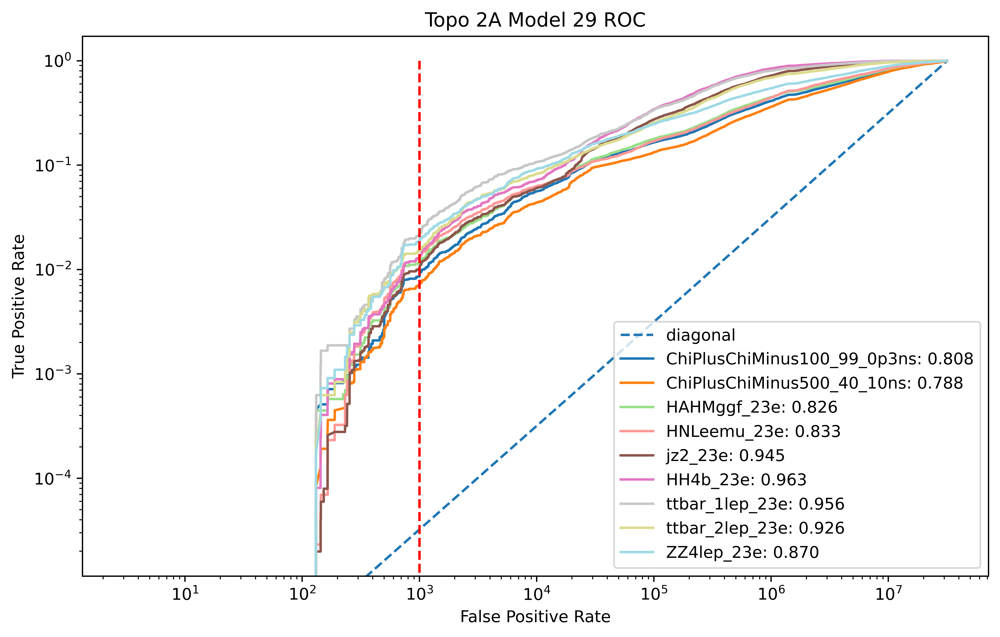


TPR at FPR = 3.138362825157594e-05 for each channel:
ChiPlusChiMinus100_99_0p3ns: 0.856269%
ChiPlusChiMinus500_40_10ns: 0.708224%
HAHMggf_23e: 1.160122%
HNLeemu_23e: 1.290069%
jz2_23e: 1.013708%
HH4b_23e: 1.292303%
ttbar_1lep_23e: 2.146280%
ttbar_2lep_23e: 1.518619%
ZZ4lep_23e: 1.859956%
Threshold = 7.883001804351806640625000000000
Number of results: 9
GetPerformance() returned: [('ChiPlusChiMinus100_99_0p3ns', 0.00856269113149847), ('ChiPlusChiMinus500_40_10ns', 0.007082243348433612), ('HAHMggf_23e', 0.011601223865374809), ('HNLeemu_23e', 0.012900685566055215), ('jz2_23e', 0.010137078696264555), ('HH4b_23e', 0.01292302721912608), ('ttbar_1lep_23e', 0.02146280475098979), ('ttbar_2lep_23e', 0.01518618681090077), ('ZZ4lep_23e', 0.018599562363238512)]
Final channel results: {'ChiPlusChiMinus100_99_0p3ns': [0.0009174311926605505, 0.0029051987767584097, 0.004791029561671763, 0.0027522935779816515, 0.005963302752293578, 0.004689092762487258, 0.009429153924566768, 0.00871559633027523, 0.0028

In [25]:
results = []
signal_names = ['ChiPlusChiMinus100_99_0p3ns', 'ChiPlusChiMinus500_40_10ns',
                'HAHMggf_23e', 'HNLeemu_23e', 'jz2_23e', 'HH4b_23e', 
                'ttbar_1lep_23e', 'ttbar_2lep_23e', 'ZZ4lep_23e']
channel_results = {}
auc_channel_results = {}
thresholds_model = []

for i in range(30):
    try:
        model_path = f'/eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GANALT_{i}/'
        print(f"Evaluating model from path: {model_path}")
        
        evaluation = Model_Evaluator(model_path,
                                   Topo_2A_L1failed,
                                   Topo_EB_L1failed_weights,
                                   [Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure,
                                    Topo_2A_ChiPlusChiMinus500_40_10ns_pure,
                                    Topo_2A_HAHMggf_23e_pure,
                                    Topo_2A_HNLeemu_23e_pure,
                                    Topo_2A_jz2_23e_pure,
                                    Topo_2A_HH4b_23e_pure,
                                    Topo_2A_ttbar_1lep_23e_pure,
                                    Topo_2A_ttbar_2lep_23e_pure,
                                    Topo_2A_ZZ4lep_23e_pure],
                                   [np.ones(len(Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure)),
                                    np.ones(len(Topo_2A_ChiPlusChiMinus500_40_10ns_pure)),
                                    np.ones(len(Topo_2A_HAHMggf_23e_pure)),
                                    np.ones(len(Topo_2A_HNLeemu_23e_pure)),
                                    np.ones(len(Topo_2A_jz2_23e_pure)),
                                    np.ones(len(Topo_2A_HH4b_23e_pure)),
                                    np.ones(len(Topo_2A_ttbar_1lep_23e_pure)),
                                    np.ones(len(Topo_2A_ttbar_2lep_23e_pure)),
                                    np.ones(len(Topo_2A_ZZ4lep_23e_pure))],
                                   input_dim = 44,
                                   title=f'Topo 2A Model {i}',
                                   save = False,
                                   labels = ['ChiPlusChiMinus100_99_0p3ns',
                                           'ChiPlusChiMinus500_40_10ns',
                                           'HAHMggf_23e',
                                           'HNLeemu_23e',
                                           'jz2_23e',
                                           'HH4b_23e',
                                           'ttbar_1lep_23e',
                                           'ttbar_2lep_23e',
                                           'ZZ4lep_23e'])
        
        print("Model_Evaluator instance created successfully")
        
        print("Calculating losses...")
        evaluation.calculate_loss('CKL')
        print("Losses calculated")
        
        print("Getting performance...")
        result, temp_thresh, auc_results = evaluation.GetPerformance()
        print(f"GetPerformance() returned: {result}")
        thresholds_model.append(temp_thresh)
        if not result:
            print(f"Warning: GetPerformance() returned an empty result for model {i}")
        else:
            for channel, tpr in result:
                if channel not in channel_results:
                    channel_results[channel] = []
                channel_results[channel].append(tpr)

        if not auc_results:
            print(f"Warning: GetPerformance() returned empty AUC results for model {i}")
        else:
            for channel, auc in auc_results:
                if channel not in auc_channel_results:
                    auc_channel_results[channel] = []
                auc_channel_results[channel].append(auc)
    
    except Exception as e:
        print(f"An error occurred while evaluating model {i}:")
        print(e)

print("Final channel results:", channel_results)
print("Final auc channel results:", auc_channel_results)

In [ ]:
# results = []
# signal_names = ['HNL', 'HAHMggf', 'qqa', 'Zprime', 'ZZ4lep', 'HHbbtt', 'jz1', 'jz2', 
#                 'ChiPlusChiMinus100_99_0p3ns', 'ChiPlusChiMinus500_40_10ns',
#                 'HAHMggf_23e', 'HNLeemu_23e', 'jz2_23e', 'HH4b_23e', 
#                 'ttbar_1lep_23e', 'ttbar_2lep_23e', 'ZZ4lep_23e']
# channel_results = {}
# auc_channel_results = {}
# thresholds_model = []

# for i in range(50):
#     try:
#         model_path = f'/eos/user/h/hjia/trained_models/L1_models/Repeat_Testing/2A_FDL_GAN_{i}/'
#         print(f"Evaluating model from path: {model_path}")
        
#         evaluation = Model_Evaluator(model_path,
#                                    Topo_2A_L1failed,
#                                    Topo_EB_L1failed_weights,
#                                    [Topo_2A_A14_pure,
#                                     Topo_2A_HAHMggf_pure,
#                                     Topo_2A_qqa_pure,
#                                     Topo_2A_Zprime_pure,
#                                     Topo_2A_ZZ4lep_pure,
#                                     Topo_2A_HHbbtt_pure,
#                                     Topo_2A_jz1_pure,
#                                     Topo_2A_jz2_pure,
#                                     Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure,
#                                     Topo_2A_ChiPlusChiMinus500_40_10ns_pure,
#                                     Topo_2A_HAHMggf_23e_pure,
#                                     Topo_2A_HNLeemu_23e_pure,
#                                     Topo_2A_jz2_23e_pure,
#                                     Topo_2A_HH4b_23e_pure,
#                                     Topo_2A_ttbar_1lep_23e_pure,
#                                     Topo_2A_ttbar_2lep_23e_pure,
#                                     Topo_2A_ZZ4lep_23e_pure],
#                                    [np.ones(len(Topo_2A_A14_pure)),
#                                     np.ones(len(Topo_2A_HAHMggf_pure)),
#                                     np.ones(len(Topo_2A_qqa_pure)),
#                                     np.ones(len(Topo_2A_Zprime_pure)),
#                                     np.ones(len(Topo_2A_ZZ4lep_pure)),
#                                     np.ones(len(Topo_2A_HHbbtt_pure)),
#                                     np.ones(len(Topo_2A_jz1_pure)),
#                                     np.ones(len(Topo_2A_jz2_pure)),
#                                     np.ones(len(Topo_2A_ChiPlusChiMinus100_99_0p3ns_pure)),
#                                     np.ones(len(Topo_2A_ChiPlusChiMinus500_40_10ns_pure)),
#                                     np.ones(len(Topo_2A_HAHMggf_23e_pure)),
#                                     np.ones(len(Topo_2A_HNLeemu_23e_pure)),
#                                     np.ones(len(Topo_2A_jz2_23e_pure)),
#                                     np.ones(len(Topo_2A_HH4b_23e_pure)),
#                                     np.ones(len(Topo_2A_ttbar_1lep_23e_pure)),
#                                     np.ones(len(Topo_2A_ttbar_2lep_23e_pure)),
#                                     np.ones(len(Topo_2A_ZZ4lep_23e_pure))],
#                                    input_dim = 44,
#                                    title=f'Topo 2A Model {i}',
#                                    save = False,
#                                    labels = ['HNL_pure',
#                                            'HAHMggf_pure',
#                                            'qqa_pure',
#                                            'Zprime_pure',
#                                            'ZZ4lep_pure',
#                                            'HHbbtt_pure',
#                                            'jz1',
#                                            'jz2',
#                                            'ChiPlusChiMinus100_99_0p3ns',
#                                            'ChiPlusChiMinus500_40_10ns',
#                                            'HAHMggf_23e',
#                                            'HNLeemu_23e',
#                                            'jz2_23e',
#                                            'HH4b_23e',
#                                            'ttbar_1lep_23e',
#                                            'ttbar_2lep_23e',
#                                            'ZZ4lep_23e'])
        
#         print("Model_Evaluator instance created successfully")
        
#         print("Calculating losses...")
#         evaluation.calculate_loss('CKL')
#         print("Losses calculated")
        
#         print("Getting performance...")
#         result, temp_thresh, auc_results = evaluation.GetPerformance()
#         print(f"GetPerformance() returned: {result}")
#         thresholds_model.append(temp_thresh)
#         if not result:
#             print(f"Warning: GetPerformance() returned an empty result for model {i}")
#         else:
#             for channel, tpr in result:
#                 if channel not in channel_results:
#                     channel_results[channel] = []
#                 channel_results[channel].append(tpr)

#         if not auc_results:
#             print(f"Warning: GetPerformance() returned empty AUC results for model {i}")
#         else:
#             for channel, auc in auc_results:
#                 if channel not in auc_channel_results:
#                     auc_channel_results[channel] = []
#                 auc_channel_results[channel].append(auc)
    
#     except Exception as e:
#         print(f"An error occurred while evaluating model {i}:")
#         print(e)

# print("Final channel results:", channel_results)
# print("Final auc channel results:", auc_channel_results)

In [26]:
import pandas as pd
df = pd.DataFrame({
    'model_index': range(30),
    'threshold': thresholds_model
})
df.to_csv('standard_threshold_GAN_ALT.csv', index=False)

In [ ]:
print(len(thresholds_model))

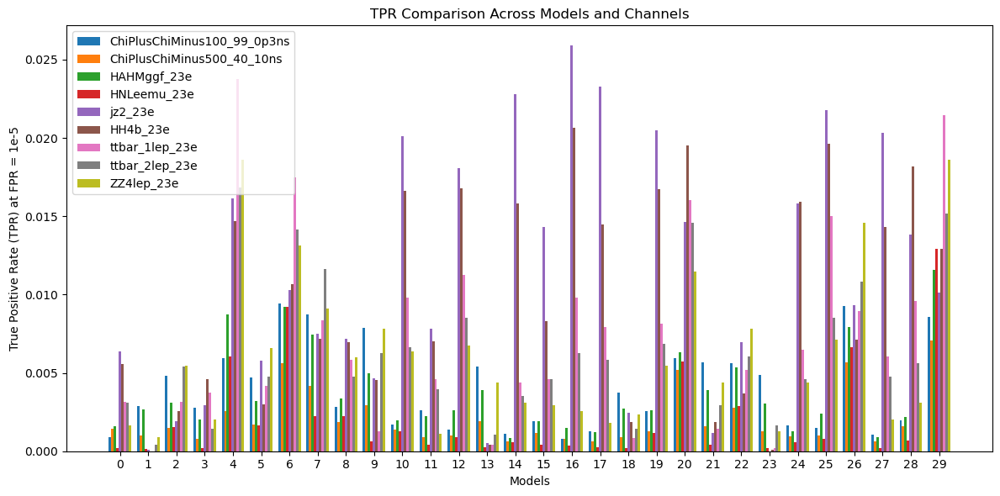


Channel Statistics:
ChiPlusChiMinus100_99_0p3ns: Mean TPR = 0.0040, Std Dev = 0.0027
ChiPlusChiMinus500_40_10ns: Mean TPR = 0.0021, Std Dev = 0.0017
HAHMggf_23e: Mean TPR = 0.0038, Std Dev = 0.0027
HNLeemu_23e: Mean TPR = 0.0020, Std Dev = 0.0030
jz2_23e: Mean TPR = 0.0111, Std Dev = 0.0078
HH4b_23e: Mean TPR = 0.0097, Std Dev = 0.0066
ttbar_1lep_23e: Mean TPR = 0.0074, Std Dev = 0.0061
ttbar_2lep_23e: Mean TPR = 0.0064, Std Dev = 0.0043
ZZ4lep_23e: Mean TPR = 0.0061, Std Dev = 0.0048


In [27]:
if channel_results:
    plt.figure(figsize=(12, 6))
    channels = list(channel_results.keys())
    n_channels = len(channels)
    n_models = len(channel_results[channels[0]])
    
    x = np.arange(n_models)
    width = 0.8 / n_channels
    
    for i, channel in enumerate(channels):
        tprs = channel_results[channel]
        plt.bar(x + i * width, tprs, width, label=channel)
    
    plt.xlabel('Models')
    plt.ylabel('True Positive Rate (TPR) at FPR = 1e-5')
    plt.title('TPR Comparison Across Models and Channels')
    plt.xticks(x + width * (n_channels - 1) / 2, [f'{i}' for i in range(n_models)])
    plt.legend()
    plt.tight_layout()
    plt.savefig('tpr_comparison_plot.png', dpi=600, bbox_inches='tight')
    plt.show()
    
    # Print statistics
    print("\nChannel Statistics:")
    for channel in channels:
        tprs = channel_results[channel]
        mean = np.mean(tprs)
        std = np.std(tprs)
        print(f"{channel}: Mean TPR = {mean:.4f}, Std Dev = {std:.4f}")
else:
    print("No results were obtained. Cannot create comparison plot.")

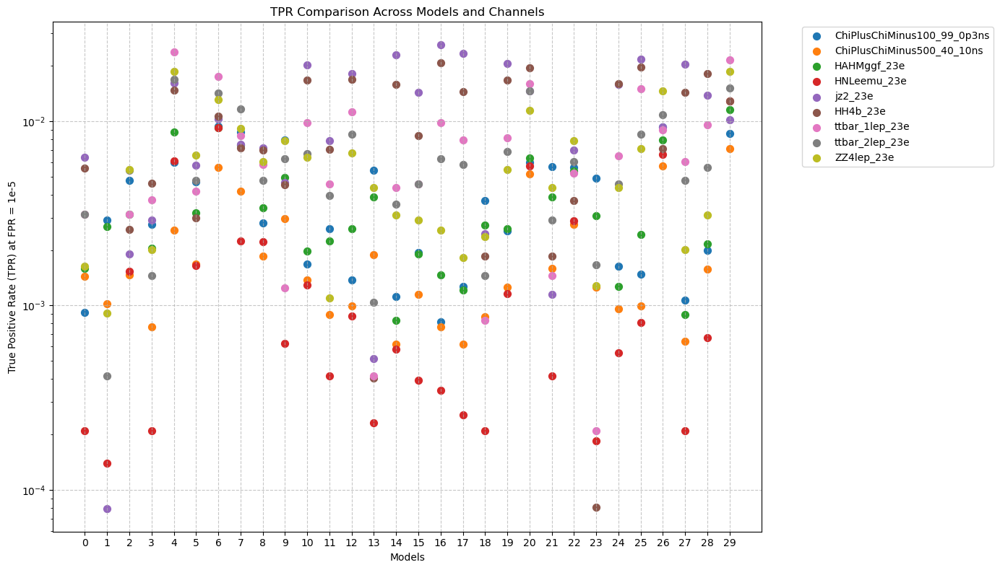


Channel Statistics:
ChiPlusChiMinus100_99_0p3ns: Mean TPR = 0.0040, Std Dev = 0.0027
ChiPlusChiMinus500_40_10ns: Mean TPR = 0.0021, Std Dev = 0.0017
HAHMggf_23e: Mean TPR = 0.0038, Std Dev = 0.0027
HNLeemu_23e: Mean TPR = 0.0020, Std Dev = 0.0030
jz2_23e: Mean TPR = 0.0111, Std Dev = 0.0078
HH4b_23e: Mean TPR = 0.0097, Std Dev = 0.0066
ttbar_1lep_23e: Mean TPR = 0.0074, Std Dev = 0.0061
ttbar_2lep_23e: Mean TPR = 0.0064, Std Dev = 0.0043
ZZ4lep_23e: Mean TPR = 0.0061, Std Dev = 0.0048


In [28]:
if channel_results:
    plt.figure(figsize=(14, 8))  # Increased figure size to accommodate the legend
    channels = list(channel_results.keys())
    n_channels = len(channels)
    n_models = len(channel_results[channels[0]])
    
    for i, channel in enumerate(channels):
        tprs = channel_results[channel]
        plt.scatter(range(n_models), tprs, label=channel, s=50)
    
    plt.xlabel('Models')
    plt.ylabel('True Positive Rate (TPR) at FPR = 1e-5')
    plt.semilogy()
    plt.title('TPR Comparison Across Models and Channels')
    plt.xticks(range(n_models), [f'{i}' for i in range(n_models)])
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Place legend outside the plot
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    
    plt.tight_layout()
    plt.savefig('tpr_comparison_plot.png', dpi=600, bbox_inches='tight')
    plt.show()
    
    # Print statistics
    print("\nChannel Statistics:")
    for channel in channels:
        tprs = channel_results[channel]
        mean = np.mean(tprs)
        std = np.std(tprs)
        print(f"{channel}: Mean TPR = {mean:.4f}, Std Dev = {std:.4f}")
else:
    print("No results were obtained. Cannot create comparison plot.")

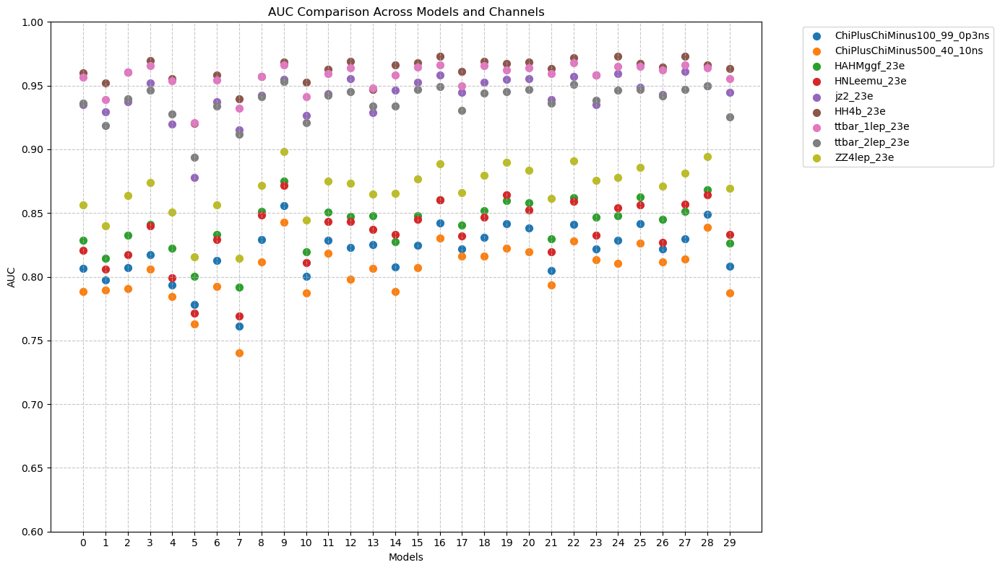


Channel Statistics:
ChiPlusChiMinus100_99_0p3ns: Mean TPR = 0.8196, Std Dev = 0.0205
ChiPlusChiMinus500_40_10ns: Mean TPR = 0.8047, Std Dev = 0.0214
HAHMggf_23e: Mean TPR = 0.8414, Std Dev = 0.0190
HNLeemu_23e: Mean TPR = 0.8348, Std Dev = 0.0248
jz2_23e: Mean TPR = 0.9420, Std Dev = 0.0167
HH4b_23e: Mean TPR = 0.9616, Std Dev = 0.0109
ttbar_1lep_23e: Mean TPR = 0.9572, Std Dev = 0.0109
ttbar_2lep_23e: Mean TPR = 0.9375, Std Dev = 0.0129
ZZ4lep_23e: Mean TPR = 0.8685, Std Dev = 0.0199


In [29]:
if auc_channel_results:
    plt.figure(figsize=(14, 8))  # Increased figure size to accommodate the legend
    channels = list(auc_channel_results.keys())
    n_channels = len(channels)
    n_models = len(auc_channel_results[channels[0]])
    
    for i, channel in enumerate(channels):
        aucs = auc_channel_results[channel]
        plt.scatter(range(n_models), aucs, label=channel, s=50)
    
    plt.xlabel('Models')
    plt.ylabel('AUC')
    # plt.semilogy()
    plt.ylim(0.6, 1)
    plt.title('AUC Comparison Across Models and Channels')
    plt.xticks(range(n_models), [f'{i}' for i in range(n_models)])
    plt.grid(True, linestyle='--', alpha=0.7)
    
    # Place legend outside the plot
    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
    
    plt.tight_layout()
    plt.savefig('auc_comparison_plot.png', dpi=600, bbox_inches='tight')
    plt.show()
    
    # Print statistics
    print("\nChannel Statistics:")
    for channel in channels:
        aucs = auc_channel_results[channel]
        mean = np.mean(aucs)
        std = np.std(aucs)
        print(f"{channel}: Mean TPR = {mean:.4f}, Std Dev = {std:.4f}")
else:
    print("No results were obtained. Cannot create comparison plot.")

In [30]:
def plot_distribution_outside(br_loss, br_weights, signal_losses, signal_weights, labels, 
                                    title, saveplots=False, save_path=None):
    fig, ax = plt.subplots(figsize=(12, 8))
    bins = 100
    
    # Determine the range for the bins
    all_scores = np.concatenate([br_loss] + signal_losses)
    min_score, max_score = 0.1, 1e2
    bin_edges = np.linspace(min_score, max_score, bins + 1)

    # Plot signal distributions
    colors = plt.cm.rainbow(np.linspace(0, 1, len(signal_losses)))
    for i, (signal_scores, signal_weights, label) in enumerate(zip(signal_losses, signal_weights, labels)):
        signal_weights = signal_weights / np.sum(signal_weights)  # Normalize weights
        ax.hist(signal_scores, bins=bin_edges, weights=signal_weights, 
                histtype='step', label=label, color=colors[i],
                density=True, linewidth=2)
    
    # Plot background distribution
    br_weights = br_weights / np.sum(br_weights)  # Normalize weights
    ax.hist(br_loss, bins=bin_edges, weights=br_weights, histtype='step', 
            label='Background', color='black', density=True, linewidth=2)
    
    ax.set_xlabel('Anomaly Score')
    ax.set_ylabel('Weighted Normalized Density')
    ax.set_title(f'{title} Weighted Normalized Anomaly Score Distribution')
    ax.legend()
    ax.grid(True, which='both', linestyle='--', alpha=0.7)
    ax.set_ylim(bottom=1e-5, top=10)
    ax.set_xscale('log')
    ax.set_yscale('log')
    
    if saveplots and save_path:
        plt.savefig(save_path, format="png", bbox_inches="tight")
    plt.show()


In [ ]:
# ori_vae_enc = Qmake_encoder_set_weights(Topo_2A_test_br.shape[1],32,16,3)
# ori_vae_dec = Qmake_decoder_set_weights(Topo_2A_test_br.shape[1],32,16,3)
ori_vae_enc = Qmake_encoder_set_weights(44,32,16,3)
ori_vae_dec = Qmake_decoder_set_weights(44,32,16,3)
ori_disc = Qmake_discriminator(44,8,2)
orginal_model = VAE_Model(ori_vae_enc, ori_vae_dec, ori_disc)

orginal_model.load_weights("/eos/user/h/hjia/AnomalyDetection/trained_models/L1_models/Topo_2A/versionFDL-GAN_ALT/best_kl_loss/")
def make_simplified_encoder(input_dim, h_dim_1, h_dim_2, latent_dim):
    inputs = keras.Input(shape=(input_dim,), name='inputs')
    x = QDenseBatchnorm(h_dim_1,
            kernel_quantizer=quantized_bits(10,5,0,alpha=1),
            bias_quantizer=quantized_bits(10,5,0,alpha=1),
            name = "dense1")(inputs)
    x = QActivation(quantized_relu(15, negative_slope=1/1024), name = 'relu1')(x)
    x = QDenseBatchnorm(h_dim_2,
            kernel_quantizer=quantized_bits(10,5,0,alpha=1),
            bias_quantizer=quantized_bits(10,5,0,alpha=1),
            name = "dense2")(x)
    x = QActivation(quantized_relu(15, negative_slope=1/1024), name = 'relu2')(x)
    z_mean = QDense(latent_dim, name='z_mean',
                  kernel_quantizer=quantized_bits(10,5,0,alpha=1),
                  bias_quantizer=quantized_bits(10,5,0,alpha=1))(x)
    new_encoder = keras.Model(inputs, z_mean, name='simplified_encoder')
    return new_encoder

In [ ]:
# Create the new encoder
# new_encoder = make_simplified_encoder(Topo_2A_test_br.shape[1],32,16,3)
new_encoder = make_simplified_encoder(44,32,16,3)
# Transfer weights from the original encoder
for layer in new_encoder.layers:
    original_layer = ori_vae_enc.get_layer(layer.name)
    if original_layer is not None:
        print("set weight for ", layer)
        print(original_layer.get_weights())
        layer.set_weights(original_layer.get_weights())

In [ ]:
tf.keras.models.save_model(
    new_encoder, 
    '/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/2A_AE_model_FDL_GAN_ALT_23e.h5',
    save_format='h5',
    include_optimizer=False  # Since you only need it for inference
)

In [ ]:
tf.keras.models.save_model(
    new_encoder, 
    '2A_AE_model_FDL_GAN_23e',
    save_format='tf',
    include_optimizer=False  # Since you only need it for inference
)

In [ ]:
L1failed_predict = new_encoder.predict(Topo_2A_L1failed)

In [ ]:
print(Topo_2A_L1failed.shape)

In [ ]:
def calculate_pair_mass(events_array, idx_start, pt1_scale=7, eta1_scale=4, phi1_scale=5, 
                       pt2_scale=7, eta2_scale=3, phi2_scale=4):
    # Extract and rescale kinematics
    pt1 = events_array[:, idx_start] * (2.0 ** pt1_scale)/10.0
    eta1 = events_array[:, idx_start + 1] * (2.0 ** eta1_scale)/40.0
    phi1 = events_array[:, idx_start + 2] * (2.0 ** phi1_scale)/phi_res
    pt2 = events_array[:, idx_start + 3] * (2.0 ** pt2_scale)/10.0
    eta2 = events_array[:, idx_start + 4] * (2.0 ** eta2_scale)/40.0
    phi2 = events_array[:, idx_start + 5] * (2.0 ** phi2_scale)/phi_res
    
    # Calculate M² using the formula
    deta = eta1 - eta2  # array subtraction
    dphi = phi1 - phi2  # array subtraction
    
    M_squared = 2 * pt1 * pt2 * (np.cosh(deta) - np.cos(dphi))
    
    return np.sqrt(M_squared)

In [ ]:
# test_data = np.vstack((Topo_2A_L1failed, Topo_2A_HAHMggf_pure, Topo_2A_qqa_pure, Topo_2A_A14_pure, Topo_2A_Zprime_pure))
test_data = Topo_2A_L1failed
# test_data = data
output_data = loaded_model.predict(test_data)
print(output_data.shape)
leadjetPT = test_data[:, 0]
subleadjetPT = test_data[:, 3]
leadtauPT = test_data[:, 18]
leadmuonPT = test_data[:, 30]
METvalue = test_data[:, 42]
columns_of_interest = [0, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39, 42]
totalPT = np.sum(test_data[:, columns_of_interest], axis=1)
jetpairmass = calculate_pair_mass(test_data, 0, pt1_scale=7, eta1_scale=5, phi1_scale=5, pt2_scale=7, eta2_scale=5, phi2_scale=5)
taupairmass = calculate_pair_mass(test_data, 18, pt1_scale=6, eta1_scale=5, phi1_scale=5, pt2_scale=5, eta2_scale=4, phi2_scale=5)
muonpairmass = calculate_pair_mass(test_data, 30, pt1_scale=4, eta1_scale=4, phi1_scale=4, pt2_scale=2, eta2_scale=3, phi2_scale=3)

In [ ]:
from scipy.stats import binomtest
def calculate_efficiency_with_errors(mu_values, scores, threshold, nbins=20):
    # Create mu bins
    mu_bins = np.linspace(np.min(mu_values), np.max(mu_values), nbins + 1)
    bin_centers = (mu_bins[1:] + mu_bins[:-1]) / 2
    
    efficiencies = []
    errors_up = []
    errors_down = []
    
    # Calculate efficiency for each bin
    for i in range(len(mu_bins)-1):
        mask = (mu_values >= mu_bins[i]) & (mu_values < mu_bins[i+1])
        if np.sum(mask) == 0:  # Skip empty bins
            efficiencies.append(0)
            errors_up.append(0)
            errors_down.append(0)
            continue
            
        total = np.sum(mask)
        passed = np.sum((scores[mask] >= threshold))
        
        # Calculate efficiency and confidence intervals using binomial statistics
        if total > 0:
            result = binomtest(passed, total)
            ci = result.proportion_ci(confidence_level=0.68)  # Using 1-sigma confidence interval
            eff = passed / total
            efficiencies.append(eff)
            errors_up.append(ci.high - eff)
            errors_down.append(eff - ci.low)
        else:
            efficiencies.append(0)
            errors_up.append(0)
            errors_down.append(0)
    
    return bin_centers, np.array(efficiencies), np.array(errors_up), np.array(errors_down)

In [ ]:
# Calculate multiplicity (number of non-zero values) for each row, but only for specified columns
multiplicities = np.count_nonzero(test_data[:, columns_of_interest], axis=1)
square = output_data**2
print(square.shape)
# Calculate the mean of sum of squares of the three outputs
output_mean_sum_squares = np.mean(output_data**2, axis=1)

# Calculate correlation
correlation, _ = pearsonr(multiplicities, output_mean_sum_squares)
# disco = dcor(multiplicities, output_mean_sum_squares)
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(multiplicities, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel('multiplicities')
plt.ylabel('AD score')
plt.title('Density Plot: Multiplicities vs AD score')

# Add correlation information to the plot
plt.text(0.05, 0.95, f'Correlation: {correlation:.4f}', 
         transform=plt.gca().transAxes, verticalalignment='top', 
         color='black', fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/multi.png')

In [ ]:
plt.figure(figsize=(10, 6), dpi=800)

# Calculate efficiencies and errors
bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(multiplicities, output_mean_sum_squares, threshold=7.166199207305908)

# Plot efficiency points with error bars
plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
            capsize=3, capthick=1, elinewidth=1, markersize=4,
            label=f'Threshold ≥ {7.166199207305908:.5f} (Correspond to 1kHz@L1AD)')

# Add horizontal line at zero
plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)

# Customize plot
plt.xlabel('multiplicities')
plt.ylabel('Efficiency')
plt.yscale('log')
plt.title('L1AD Efficiency vs multiplicities')
plt.grid(True, alpha=0.3)
plt.legend()

# Set y-axis limits with some padding
# plt.ylim(-0.05, 1.05)

plt.tight_layout()
plt.show()
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/multi_eff.png')

In [ ]:
correlation, _ = pearsonr(Topo_2A_L1failed_mu, output_mean_sum_squares)
# disco = dcor(leadjetPT, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(Topo_2A_L1failed_mu, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel('mu')
plt.ylabel('AD score')
plt.title('Density Plot: mu vs AD score')

# Add correlation information to the plot
plt.text(0.05, 0.95, f'Correlation: {correlation:.4f}', 
         transform=plt.gca().transAxes, verticalalignment='top', 
         color='black', fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/mu2d_nofilt.png')

In [ ]:
correlation, _ = pearsonr(Topo_2A_L1failed_mu, multiplicities)
# disco = dcor(leadjetPT, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(Topo_2A_L1failed_mu, multiplicities, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel('mu')
plt.ylabel('multiplicities')
plt.title('Density Plot: mu vs multiplicities')

# Add correlation information to the plot
plt.text(0.05, 0.95, f'Correlation: {correlation:.4f}', 
         transform=plt.gca().transAxes, verticalalignment='top', 
         color='black', fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/mu_multi.png')

In [ ]:
def plot_efficiency(mu_values, scores, threshold):
    plt.figure(figsize=(10, 6), dpi=800)
    
    # Calculate efficiencies and errors
    bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(mu_values, scores, threshold)
    
    # Plot efficiency points with error bars
    plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
                 capsize=3, capthick=1, elinewidth=1, markersize=4,
                 label=f'Threshold ≥ {threshold:.5f} (Correspond to 1kHz@L1AD)')
    
    # Add horizontal line at zero
    plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)
    
    # Customize plot
    plt.xlabel('μ')
    plt.ylabel('Efficiency')
    plt.yscale('log')
    plt.title('L1AD Efficiency vs μ')
    plt.grid(True, alpha=0.3)
    plt.legend()
    
    # Set y-axis limits with some padding
    # plt.ylim(-0.05, 1.05)
    
    plt.tight_layout()
    plt.show()
    plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/mu_eff.png')

In [ ]:
plot_efficiency(Topo_2A_L1failed_mu, output_mean_sum_squares, threshold=7.166199207305908)

In [ ]:
correlation, _ = pearsonr(leadjetPT, output_mean_sum_squares)
# disco = dcor(leadjetPT, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(leadjetPT, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel('Leading Jet pT')
plt.ylabel('AD score')
plt.title('Density Plot: Leading Jet pT vs AD score')

# Add correlation information to the plot
plt.text(0.75, 0.95, f'Correlation: {correlation:.4f}', 
         transform=plt.gca().transAxes, verticalalignment='top', 
         color='black', fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/leadJet.png')

In [ ]:
plt.figure(figsize=(10, 6), dpi=800)

# Calculate efficiencies and errors
bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(leadjetPT, output_mean_sum_squares, threshold=7.166199207305908)

# Plot efficiency points with error bars
plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
            capsize=3, capthick=1, elinewidth=1, markersize=4,
            label=f'Threshold ≥ {7.166199207305908:.5f} (Correspond to 1kHz@L1AD)')

# Add horizontal line at zero
plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)

# Customize plot
plt.xlabel('leading jet PT')
plt.ylabel('Efficiency')
plt.yscale('log')
plt.ylim(1e-5,1)
plt.title('L1AD Efficiency vs Leading Jet PT')
plt.grid(True, alpha=0.3)
plt.legend()

# Set y-axis limits with some padding
# plt.ylim(-0.05, 1.05)

plt.tight_layout()
plt.show()
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/jet_eff.png')

In [ ]:
plt.figure(figsize=(10, 6), dpi=800)

# Calculate efficiencies and errors
bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(leadmuonPT, output_mean_sum_squares, threshold=7.166199207305908)

# Plot efficiency points with error bars
plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
            capsize=3, capthick=1, elinewidth=1, markersize=4,
            label=f'Threshold ≥ {7.166199207305908:.5f} (Correspond to 1kHz@L1AD)')

# Add horizontal line at zero
plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)

# Customize plot
plt.xlabel('leading muon PT')
plt.ylabel('Efficiency')
plt.yscale('log')
# plt.ylim(1e-5,1)
plt.title('L1AD Efficiency vs Leading muon PT')
plt.grid(True, alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/muon_eff.png')

In [ ]:
plt.figure(figsize=(10, 6), dpi=800)

# Calculate efficiencies and errors
bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(leadtauPT, output_mean_sum_squares, threshold=7.166199207305908)

# Plot efficiency points with error bars
plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
            capsize=3, capthick=1, elinewidth=1, markersize=4,
            label=f'Threshold ≥ {7.166199207305908:.5f} (Correspond to 1kHz@L1AD)')

# Add horizontal line at zero
plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)

# Customize plot
plt.xlabel('leading tau PT')
plt.ylabel('Efficiency')
plt.yscale('log')
plt.ylim(1e-5,1)
plt.title('L1AD Efficiency vs Leading tau PT')
plt.grid(True, alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/tau_eff.png')

In [ ]:
correlation, _ = pearsonr(leadmuonPT, output_mean_sum_squares)
# disco = dcor(leadmuonPT, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(leadmuonPT, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel('Leading muon pT')
plt.ylabel('AD score')
plt.title('Density Plot: Leading Muon pT vs AD score')

# Add correlation information to the plot
plt.text(0.75, 0.95, f'Correlation: {correlation:.4f}', 
         transform=plt.gca().transAxes, verticalalignment='top', 
         color='black', fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/leadMuon.png')

In [ ]:
plt.figure(figsize=(10, 6), dpi=800)

# Calculate efficiencies and errors
bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(METvalue, output_mean_sum_squares, threshold=7.166199207305908)

# Plot efficiency points with error bars
plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
            capsize=3, capthick=1, elinewidth=1, markersize=4,
            label=f'Threshold ≥ {7.166199207305908:.5f} (Correspond to 1kHz@L1AD)')

# Add horizontal line at zero
plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)

# Customize plot
plt.xlabel('MET')
plt.ylabel('Efficiency')
plt.yscale('log')
plt.title('L1AD Efficiency vs MET')
plt.grid(True, alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/MET_eff.png')

In [ ]:
correlation, _ = pearsonr(leadtauPT, output_mean_sum_squares)
# disco = dcor(leadtauPT, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(leadtauPT, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel('Leading tau pT')
plt.ylabel('AD score')
plt.title('Density Plot: Leading Tau pT vs AD score')

# Add correlation information to the plot
plt.text(0.75, 0.95, f'Correlation: {correlation:.4f}', 
         transform=plt.gca().transAxes, verticalalignment='top', 
         color='black', fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/leadTau.png')

In [ ]:
correlation, _ = pearsonr(METvalue , output_mean_sum_squares)
# disco = dcor(METvalue, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(METvalue , output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel('MET')
plt.ylabel('AD score')
plt.title('Density Plot: MET vs AD score')

# Add correlation information to the plot
plt.text(0.75, 0.95, f'Correlation: {correlation:.4f}', 
         transform=plt.gca().transAxes, verticalalignment='top', 
         color='black', fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/MET_corr.png')

In [ ]:
correlation, _ = pearsonr(jetpairmass, output_mean_sum_squares)
# disco = dcor(METvalue, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(jetpairmass, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel(' leading jet pair invariant mass[GeV]')
plt.ylabel('AD score')
plt.title('Density Plot: m_jj vs AD score')

# Add correlation information to the plot
plt.text(0.75, 0.95, f'Correlation: {correlation:.4f}', 
         transform=plt.gca().transAxes, verticalalignment='top', 
         color='black', fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/jetpair.png')

In [ ]:
plt.figure(figsize=(10, 6), dpi=800)

# Calculate efficiencies and errors
bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(jetpairmass, output_mean_sum_squares, threshold=7.166199207305908)

# Plot efficiency points with error bars
plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
            capsize=3, capthick=1, elinewidth=1, markersize=4,
            label=f'Threshold ≥ {7.166199207305908:.5f} (Correspond to 1kHz@L1AD)')

# Add horizontal line at zero
plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)

# Customize plot
plt.xlabel('Leading jet pair invariant mass [GeV]')
plt.ylabel('Efficiency')
plt.yscale('log')
plt.ylim(1e-6,1)
plt.title('L1AD Efficiency vs Leading jet pair invariant mass')
plt.grid(True, alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/jetpairmass_eff.png')

In [ ]:
correlation, _ = pearsonr(taupairmass, output_mean_sum_squares)
# disco = dcor(METvalue, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(taupairmass, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel(' leading tau pair invariant mass[GeV]')
plt.ylabel('AD score')
plt.title('Density Plot: m_tt vs AD score')

# Add correlation information to the plot
plt.text(0.75, 0.95, f'Correlation: {correlation:.4f}', 
         transform=plt.gca().transAxes, verticalalignment='top', 
         color='black', fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/taupair.png')

In [ ]:
plt.figure(figsize=(10, 6), dpi=800)

# Calculate efficiencies and errors
bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(taupairmass, output_mean_sum_squares, threshold=7.166199207305908)

# Plot efficiency points with error bars
plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
            capsize=3, capthick=1, elinewidth=1, markersize=4,
            label=f'Threshold ≥ {7.166199207305908:.5f} (Correspond to 1kHz@L1AD)')

# Add horizontal line at zero
plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)

# Customize plot
plt.xlabel('Leading tau pair invariant mass [GeV]')
plt.ylabel('Efficiency')
plt.yscale('log')
plt.ylim(1e-6,1)
plt.title('L1AD Efficiency vs Leading tau pair invariant mass')
plt.grid(True, alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/taupairmass_eff.png')

In [ ]:
correlation, _ = pearsonr(muonpairmass, output_mean_sum_squares)
# disco = dcor(METvalue, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(muonpairmass, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel(' leading muon pair invariant mass[GeV]')
plt.ylabel('AD score')
plt.title('Density Plot: m_mumu vs AD score')

# Add correlation information to the plot
plt.text(0.75, 0.95, f'Correlation: {correlation:.4f}', 
         transform=plt.gca().transAxes, verticalalignment='top', 
         color='black', fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/muonpair.png')

In [ ]:
plt.figure(figsize=(10, 6), dpi=800)

# Calculate efficiencies and errors
bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(muonpairmass, output_mean_sum_squares, threshold=7.166199207305908)

# Plot efficiency points with error bars
plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
            capsize=3, capthick=1, elinewidth=1, markersize=4,
            label=f'Threshold ≥ {7.166199207305908:.5f} (Correspond to 1kHz@L1AD)')

# Add horizontal line at zero
plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)

# Customize plot
plt.xlabel('Leading muon pair invariant mass [GeV]')
plt.ylabel('Efficiency')
plt.yscale('log')
plt.ylim(1e-4,1)
plt.title('L1AD Efficiency vs Leading tau pair invariant mass')
plt.grid(True, alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/muonpairmass_eff.png')

In [ ]:
correlation, _ = pearsonr(totalPT, output_mean_sum_squares)
# disco = dcor(METvalue, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(totalPT, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel(' sum PT')
plt.ylabel('AD score')
plt.title('Density Plot: sum PT vs AD score')

# Add correlation information to the plot
plt.text(0.95, 0.95, f'Correlation: {correlation:.4f}',
        transform=plt.gca().transAxes, 
        verticalalignment='top',
        horizontalalignment='right',
        color='black', 
        fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/sumPT.png')

In [ ]:
plt.figure(figsize=(10, 6), dpi=800)

# Calculate efficiencies and errors
bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(totalPT, output_mean_sum_squares, threshold=7.166199207305908)

# Plot efficiency points with error bars
plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
            capsize=3, capthick=1, elinewidth=1, markersize=4,
            label=f'Threshold ≥ {7.166199207305908:.5f} (Correspond to 1kHz@L1AD)')

# Add horizontal line at zero
plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)

# Customize plot
plt.xlabel('Sum of PT')
plt.ylabel('Efficiency')
plt.yscale('log')
# plt.ylim(1e-4,1)
plt.title('L1AD Efficiency vs Sum of PT')
plt.grid(True, alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/totalPT_eff.png')

In [ ]:
columns_of_visible = [0, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39]
visiblePT = np.sum(test_data[:, columns_of_visible], axis=1)
correlation, _ = pearsonr(visiblePT, output_mean_sum_squares)
# disco = dcor(METvalue, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(visiblePT, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel(' sum PT')
plt.ylabel('AD score')
plt.title('Density Plot: visible sum PT vs AD score')

# Add correlation information to the plot
plt.text(0.95, 0.95, f'Correlation: {correlation:.4f}',
        transform=plt.gca().transAxes, 
        verticalalignment='top',
        horizontalalignment='right',
        color='black', 
        fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/visiblesumPT.png')

In [ ]:
columns_of_visible = [0, 3, 6, 9, 12, 15, 18, 21, 24, 27, 30, 33, 36, 39]
visiblePT = np.sum(test_data[:, columns_of_visible], axis=1)
correlation, _ = pearsonr(visiblePT, output_mean_sum_squares)
# disco = dcor(METvalue, output_mean_sum_squares)
# Create the density plot
plt.figure(figsize=(10, 6), dpi=800)
plt.hist2d(visiblePT, output_mean_sum_squares, bins=50, cmap='viridis', 
               norm=LogNorm())
plt.colorbar(label='Count')

plt.xlabel(' sum PT')
plt.ylabel('AD score')
plt.title('Density Plot: visible sum PT vs AD score')

# Add correlation information to the plot
plt.text(0.95, 0.95, f'Correlation: {correlation:.4f}',
        transform=plt.gca().transAxes, 
        verticalalignment='top',
        horizontalalignment='right',
        color='black', 
        fontweight='bold')

# Show the plot
plt.tight_layout()
plt.show()

print(f"Correlation coefficient: {correlation:.4f}")
# print(f"Distance Correlation coefficient: {disco:.4f}")
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/visiblesumPT.png')

In [ ]:
plt.figure(figsize=(10, 6), dpi=800)

# Calculate efficiencies and errors
bins_centers, effs, errs_up, errs_down = calculate_efficiency_with_errors(visiblePT, output_mean_sum_squares, threshold=7.166199207305908)

# Plot efficiency points with error bars
plt.errorbar(bins_centers, effs, yerr=[errs_down, errs_up], fmt='o', 
            capsize=3, capthick=1, elinewidth=1, markersize=4,
            label=f'Threshold ≥ {7.166199207305908:.5f} (Correspond to 1kHz@L1AD)')

# Add horizontal line at zero
plt.axhline(y=0, color='gray', linestyle='--', alpha=0.5)

# Customize plot
plt.xlabel('visible Sum of PT')
plt.ylabel('Efficiency')
plt.yscale('log')
# plt.ylim(1e-4,1)
plt.title('L1AD Efficiency vs visible Sum of PT')
plt.grid(True, alpha=0.3)
plt.legend()

plt.tight_layout()
plt.show()
plt.savefig('/eos/user/h/hjia/AnomalyDetection/workdir/analysis_notebooks/visiblePT_eff.png')